# Background and Context

You are a Data Scientist for a tourism company named "Visit with us". The Policy Maker of the company wants to enable and establish a viable business model to expand the customer base.

A viable business model is a central concept that helps you to understand the existing ways of doing the business and how to change the ways for the benefit of the tourism sector.

One of the ways to expand the customer base is to introduce a new offering of packages.

Currently, there are 5 types of packages the company is offering - Basic, Standard, Deluxe, Super Deluxe, King. Looking at the data of the last year, we observed that 18% of the customers purchased the packages.

However, the marketing cost was quite high because customers were contacted at random without looking at the available information.

The company is now planning to launch a new product i.e. Wellness Tourism Package. Wellness Tourism is defined as Travel that allows the traveler to maintain, enhance or kick-start a healthy lifestyle, and support or increase one's sense of well-being.

However, this time company wants to harness the available data of existing and potential customers to make the marketing expenditure more efficient.

You as a Data Scientist at "Visit with us" travel company have to analyze the customers' data and information to provide recommendations to the Policy Maker and Marketing Team and also build a model to predict the potential customer who is going to purchase the newly introduced travel package.

## Objective

To predict which customer is more likely to purchase the newly introduced wellness travel package.

## Data Dictionary

### Customer details:

- CustomerID: Unique customer ID
- ProdTaken: Whether the customer has purchased a package or not (0: No, 1: Yes)
- Age: Age of customer
- TypeofContact: How customer was contacted (Company Invited or Self Inquiry)
- CityTier: City tier depends on the development of a city, population, facilities, and living standards. The categories are ordered i.e. Tier 1 > Tier 2 > Tier 3
- Occupation: Occupation of customer
- Gender: Gender of customer
- NumberOfPersonVisiting: Total number of persons planning to take the trip with the customer
- PreferredPropertyStar: Preferred hotel property rating by customer
- MaritalStatus: Marital status of customer
- NumberOfTrips: Average number of trips in a year by customer
- Passport: The customer has a passport or not (0: No, 1: Yes)
- OwnCar: Whether the customers own a car or not (0: No, 1: Yes)
- NumberOfChildrenVisiting: Total number of children with age less than 5 planning to take the trip with the customer
- Designation: Designation of the customer in the current organization
- MonthlyIncome: Gross monthly income of the customer

### Customer interaction data: 

- PitchSatisfactionScore: Sales pitch satisfaction score
- ProductPitched: Product pitched by the salesperson
- NumberOfFollowups: Total number of follow-ups has been done by the salesperson after the sales pitch
- DurationOfPitch: Duration of the pitch by a salesperson to the customer


### Observations 

- Target variable will be ProdTaken
- We have basic informatio about the customer and how he interacts with the sales representatives. Customer interaction data may not avaialable when we are dealing with new customers.
- Generally people with Kids, higher Monthly income or designation will prefer to purchase a Tourism package
- If customer himself enquired about the packages then based on CityTier, Age, Customer interaction data etc. we can suggest a package. 
- DurationOfPitch, NumberOfFollowups, PitchSatisfactionScore can be considered as important features to target a customer.
- Customers who spend more like those who prefer 5 start hotels or OwnCar or who buys costly packages  etc can be targeted for wellness package.

    
## Criteria
### Perform an Exploratory Data Analysis on the data
- Univariate analysis - Bivariate analysis - Use appropriate visualizations to identify the patterns and insights - Come up with a customer profile (characteristics of a customer) of the different packages - Any other exploratory deep dive

### Illustrate the insights based on EDA
- Key meaningful observations on individual variables and the relationship between variables

### Data Pre-processing
- Prepare the data for analysis - Missing value Treatment, Outlier Detection (treat, if needed- why or why not ), Feature Engineering, Prepare data for modeling

### Model building - Bagging
- Build bagging classifier, random forest, and decision tree.

### Model performance improvement - Bagging
- Comment on which metric is right for model performance evaluation and why? - Comment on model performance - Can model performance be improved? check and comment

### Model building - Boosting
- Build Adaboost, gradient boost, xgboost, and stacking classifier

### Model performance improvement - Boosting
- Comment on which metric is right for model performance evaluation and why? - Comment on model performance - Can model performance be improved? check and comment

### Model performance evaluation
- Evaluate the model on different performance metrics and comment on the performance and scope of improvement

### Actionable Insights & Recommendations
- Conclude with the key takeaways for the business - What would your advice be to grow the business?

### Import libs

In [2]:
import warnings
warnings.filterwarnings("ignore")

# Libraries to help with reading and manipulating data
import pandas as pd
import numpy as np

# Library to split data
from sklearn.model_selection import train_test_split

# Libraries to help with model building
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
import xgboost
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier
from sklearn import tree

# Libaries to help with data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Removes the limit from the number of displayed columns and rows.
pd.set_option("display.max_columns", None)
# pd.set_option('display.max_rows', None)
pd.set_option("display.max_rows", 200)

# for statistical analysis 
import statsmodels.stats.api as sms
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant


# To get diferent metric scores
from sklearn import metrics
from sklearn.metrics import accuracy_score, recall_score, precision_score, roc_auc_score, roc_curve, confusion_matrix, precision_recall_curve, f1_score, classification_report
from sklearn.model_selection import GridSearchCV

# For pandas profiling
from pandas_profiling import ProfileReport

# yollowbrick for machine learning visualization libary
from yellowbrick import classifier, features, regressor
import yellowbrick.model_selection as ms

#explain the output of any machine learning model
import shap
#Missingno library offers a very nice way to visualize the distribution of NaN values
import missingno as mn

from IPython.display import display

### Read the dataset

In [85]:
tour = pd.read_excel("Tourism.xlsx", sheet_name="Tourism")

In [86]:
# helps to keep original copy of data
data = tour.copy()

### shape and info of dataset

In [87]:
data.shape

(4888, 20)

In [88]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4888 entries, 0 to 4887
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CustomerID                4888 non-null   int64  
 1   ProdTaken                 4888 non-null   int64  
 2   Age                       4662 non-null   float64
 3   TypeofContact             4863 non-null   object 
 4   CityTier                  4888 non-null   int64  
 5   DurationOfPitch           4637 non-null   float64
 6   Occupation                4888 non-null   object 
 7   Gender                    4888 non-null   object 
 8   NumberOfPersonVisiting    4888 non-null   int64  
 9   NumberOfFollowups         4843 non-null   float64
 10  ProductPitched            4888 non-null   object 
 11  PreferredPropertyStar     4862 non-null   float64
 12  MaritalStatus             4888 non-null   object 
 13  NumberOfTrips             4748 non-null   float64
 14  Passport

In [89]:
data.isna().sum().sort_values(ascending=False)

DurationOfPitch             251
MonthlyIncome               233
Age                         226
NumberOfTrips               140
NumberOfChildrenVisiting     66
NumberOfFollowups            45
PreferredPropertyStar        26
TypeofContact                25
Passport                      0
MaritalStatus                 0
ProductPitched                0
Designation                   0
NumberOfPersonVisiting        0
Gender                        0
Occupation                    0
PitchSatisfactionScore        0
CityTier                      0
OwnCar                        0
ProdTaken                     0
CustomerID                    0
dtype: int64

### Observations
- There are certain missing values in the data. We will explore further to understand the data.

In [90]:
data.sample(10, random_state =1)

,CustomerID,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
3015,203015,0,27.0,Company Invited,1,7.0,Salaried,Female,4,6.0,Basic,3.0,Married,5.0,0,4,1,3.0,Executive,23042.0
1242,201242,0,40.0,Self Enquiry,3,13.0,Small Business,Male,2,3.0,King,4.0,Single,2.0,0,4,1,NaN,VP,34833.0
3073,203073,0,29.0,Self Enquiry,2,15.0,Small Business,Male,4,5.0,Basic,3.0,Married,3.0,0,2,0,2.0,Executive,23614.0
804,200804,0,48.0,Company Invited,1,6.0,Small Business,Male,2,1.0,Super Deluxe,3.0,Single,3.0,0,2,0,0.0,AVP,31885.0
3339,203339,0,32.0,Self Enquiry,1,18.0,Small Business,Male,4,4.0,Deluxe,5.0,Divorced,3.0,1,2,0,3.0,Manager,25511.0
3080,203080,1,36.0,Company Invited,1,32.0,Salaried,Female,4,4.0,Basic,4.0,Married,3.0,1,3,0,1.0,Executive,20700.0
2851,202851,0,46.0,Self Enquiry,1,17.0,Salaried,Male,4,4.0,Basic,3.0,Divorced,5.0,0,5,1,1.0,Executive,21332.0
2883,202883,1,32.0,Company Invited,1,27.0,Salaried,Male,4,4.0,Standard,3.0,Divorced,5.0,0,3,1,1.0,Senior Manager,28502.0
1676,201676,0,22.0,Self Enquiry,1,11.0,Salaried,Male,2,1.0,Basic,4.0,Married,2.0,1,4,1,0.0,Executive,17328.0
1140,201140,0,44.0,Self Enquiry,1,13.0,Small Business,Female,2,3.0,King,3.0,Married,1.0,1,4,1,1.0,VP,34049.0


### Observations
- CustomerID will not help the model, so deleting it
- Column name looks ok, no spaces or special characters.
- ProdTaken, CityTier, Occupation, Gender, NumberOfPersonVisiting, ProductPitched, PreferredPropertyStar, MaritalStatus, Passport, PitchSatisfactionScore, Designation should be categorical.

In [91]:
data.drop("CustomerID", inplace=True, axis=1)

### Univariate Analysis

In [92]:
data.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
ProdTaken,4888,NaN,NaN,NaN,0.188216,0.390925,0,0,0,0,1
Age,4662,NaN,NaN,NaN,37.6223,9.31639,18,31,36,44,61
TypeofContact,4863,2,Self Enquiry,3444,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CityTier,4888,NaN,NaN,NaN,1.65426,0.916583,1,1,1,3,3
DurationOfPitch,4637,NaN,NaN,NaN,15.4908,8.51964,5,9,13,20,127
Occupation,4888,4,Salaried,2368,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gender,4888,3,Male,2916,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumberOfPersonVisiting,4888,NaN,NaN,NaN,2.90507,0.724891,1,2,3,3,5
NumberOfFollowups,4843,NaN,NaN,NaN,3.70845,1.00251,1,3,4,4,6
ProductPitched,4888,5,Basic,1842,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Observations
- Average age of customer is 38 years.
- Average Duration of Pitch is 15, however max value is 127 which indicates some outliers.
- On an Average 3 persons will go for a trip
- Average number of followup requires are 4.
- Average number of trips taken by customers are 3, howvever max value is 22 which indicates some outliers.
- Average MonthlyIncome is around 24000, where as maximum value is 98678 which indicates some outliers.

In [93]:
str_category_cols = data.select_dtypes(exclude=['float64'], include=['object']).columns
str_category_cols

Index(['TypeofContact', 'Occupation', 'Gender', 'ProductPitched',
       'MaritalStatus', 'Designation'],
      dtype='object')

In [94]:
# Print value counts for string category columns and seeit requires any data cleanup
for col in str_category_cols:
    print(data[col].value_counts(dropna=False))
    print("="*40)

Self Enquiry       3444
Company Invited    1419
NaN                  25
Name: TypeofContact, dtype: int64
Salaried          2368
Small Business    2084
Large Business     434
Free Lancer          2
Name: Occupation, dtype: int64
Male       2916
Female     1817
Fe Male     155
Name: Gender, dtype: int64
Basic           1842
Deluxe          1732
Standard         742
Super Deluxe     342
King             230
Name: ProductPitched, dtype: int64
Married      2340
Divorced      950
Single        916
Unmarried     682
Name: MaritalStatus, dtype: int64
Executive         1842
Manager           1732
Senior Manager     742
AVP                342
VP                 230
Name: Designation, dtype: int64


### Observations
- Interestingly there are more self enquiries than company invited calls. There are 25 Null values will convert them to "unknown" value
- Gender has a typo for Female value. 
- Looks like Basic and Deluxe are most bought packages 
- Married people like to use more tour packages
- Executives and Managers like to travel a lot too. May be that is related to thier stress and Income level.

In [95]:
number_category_cols = ["ProdTaken", "CityTier", "NumberOfPersonVisiting", "PreferredPropertyStar", "NumberOfFollowups", "Passport", "PitchSatisfactionScore", "OwnCar", "NumberOfChildrenVisiting"]
for col in number_category_cols:
    print(data[col].value_counts(dropna=False))
    print("="*40)

0    3968
1     920
Name: ProdTaken, dtype: int64
1    3190
3    1500
2     198
Name: CityTier, dtype: int64
3    2402
2    1418
4    1026
1      39
5       3
Name: NumberOfPersonVisiting, dtype: int64
3.0    2993
5.0     956
4.0     913
NaN      26
Name: PreferredPropertyStar, dtype: int64
4.0    2068
3.0    1466
5.0     768
2.0     229
1.0     176
6.0     136
NaN      45
Name: NumberOfFollowups, dtype: int64
0    3466
1    1422
Name: Passport, dtype: int64
3    1478
5     970
1     942
4     912
2     586
Name: PitchSatisfactionScore, dtype: int64
1    3032
0    1856
Name: OwnCar, dtype: int64
1.0    2080
2.0    1335
0.0    1082
3.0     325
NaN      66
Name: NumberOfChildrenVisiting, dtype: int64


### Observations
- There are few null values in PreferredPropertyStar, we can impute those missing values using median
- Thre are few null values in NumberOfChildrenVisiting, we can impute them using median


### Data Preprocessing

#### Replace "Fe Male" in Gender with "Female"

In [96]:

data.loc[data["Gender"] == "Fe Male", "Gender"] = "Female"

#### Fill with Medain

In [97]:
def fill_na_with_median(col):
    data[col].fillna(value=data[col].median(), inplace=True)

In [98]:
for col in ["PreferredPropertyStar", "NumberOfChildrenVisiting"]:
    fill_na_with_median(col)

In [99]:
data.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
ProdTaken,4888,NaN,NaN,NaN,0.188216,0.390925,0,0,0,0,1
Age,4662,NaN,NaN,NaN,37.6223,9.31639,18,31,36,44,61
TypeofContact,4863,2,Self Enquiry,3444,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CityTier,4888,NaN,NaN,NaN,1.65426,0.916583,1,1,1,3,3
DurationOfPitch,4637,NaN,NaN,NaN,15.4908,8.51964,5,9,13,20,127
Occupation,4888,4,Salaried,2368,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gender,4888,2,Male,2916,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumberOfPersonVisiting,4888,NaN,NaN,NaN,2.90507,0.724891,1,2,3,3,5
NumberOfFollowups,4843,NaN,NaN,NaN,3.70845,1.00251,1,3,4,4,6
ProductPitched,4888,5,Basic,1842,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Univariate Analysis

### code Ref: From academy notebooks

In [100]:
# While doing uni-variate analysis of numerical variables we want to study their central tendency 
# and dispersion.
# Let us write a function that will help us create boxplot and histogram for any input numerical 
# variable.
# This function takes the numerical column as the input and returns the boxplots 
# and histograms for the variable.
# Let us see if this help us write faster and cleaner code.
def histogram_boxplot(feature, figsize=(15,10), bins = None):
    """ Boxplot and histogram combined
    feature: 1-d feature array
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(nrows = 2, # Number of rows of the subplot grid= 2
                                           sharex = True, # x-axis will be shared among all subplots
                                           gridspec_kw = {"height_ratios": (.25, .75)}, 
                                           figsize = figsize 
                                           ) # creating the 2 subplots
    ax_box2.set_title(feature.name, fontsize=20)
    sns.boxplot(feature, ax=ax_box2, showmeans=True, color='violet') # boxplot will be created and a star will indicate the mean value of the column
    sns.distplot(feature, kde=True, ax=ax_hist2, bins=bins,color = 'orange') if bins else sns.distplot(feature, kde=False, ax=ax_hist2,color='tab:cyan') # For histogram
    ax_hist2.axvline(np.mean(feature), color='purple', linestyle='--') # Add mean to the histogram
    ax_hist2.axvline(np.median(feature), color='black', linestyle='-') # Add median to the histogram
    plt.Line2D([0,1],[0,0], color='r', linewidth=4)

### Histograms and boxplot for numerical columns

In [101]:
float_cols = data.select_dtypes(include=['float64'], exclude=['category']).columns
float_cols

Index(['Age', 'DurationOfPitch', 'NumberOfFollowups', 'PreferredPropertyStar',
       'NumberOfTrips', 'NumberOfChildrenVisiting', 'MonthlyIncome'],
      dtype='object')

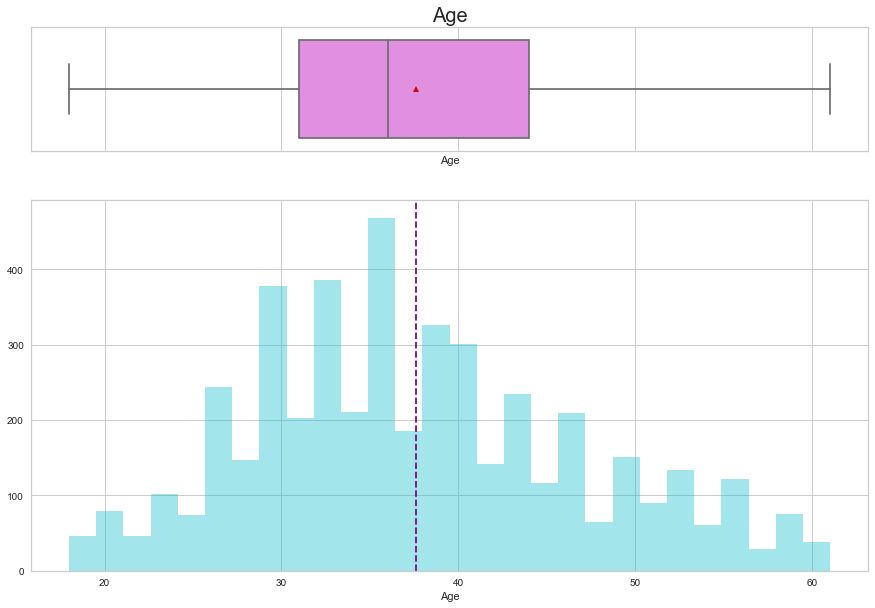

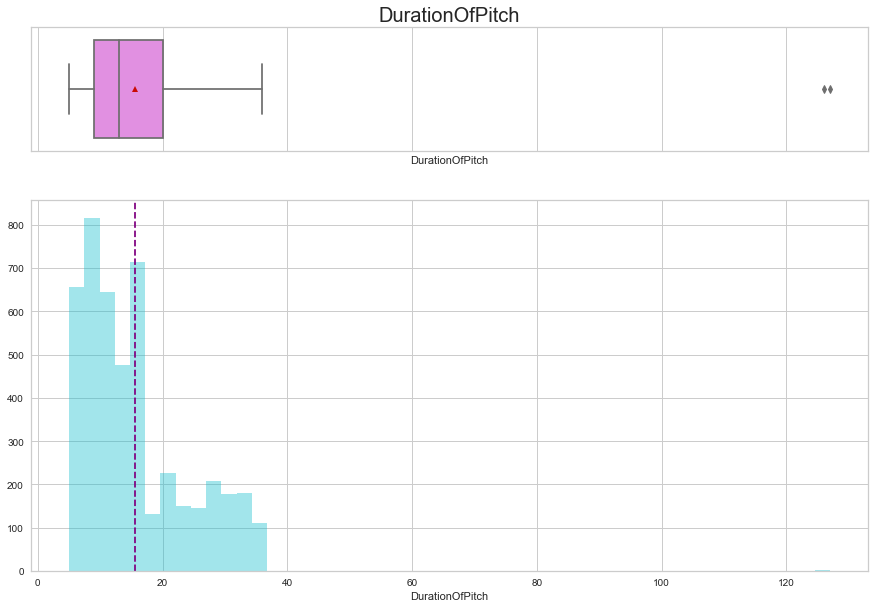

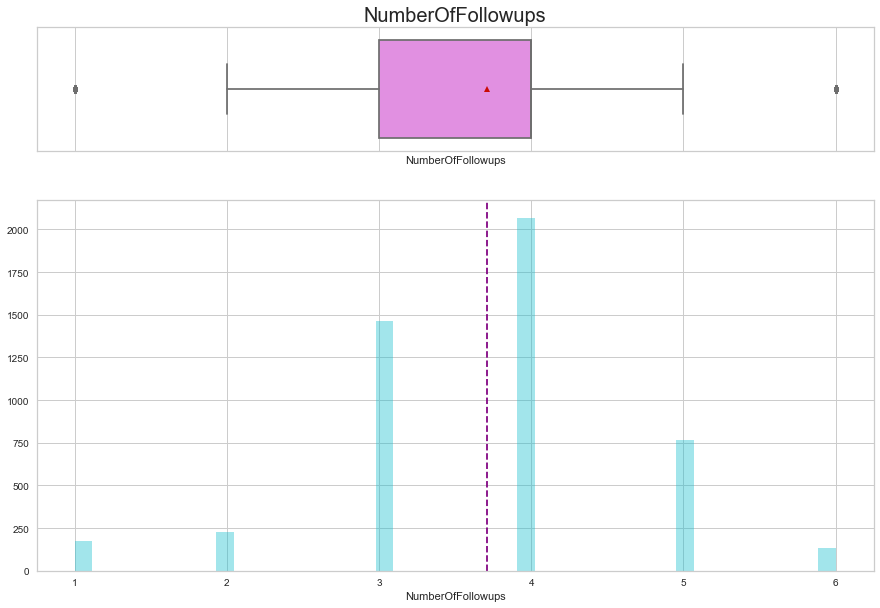

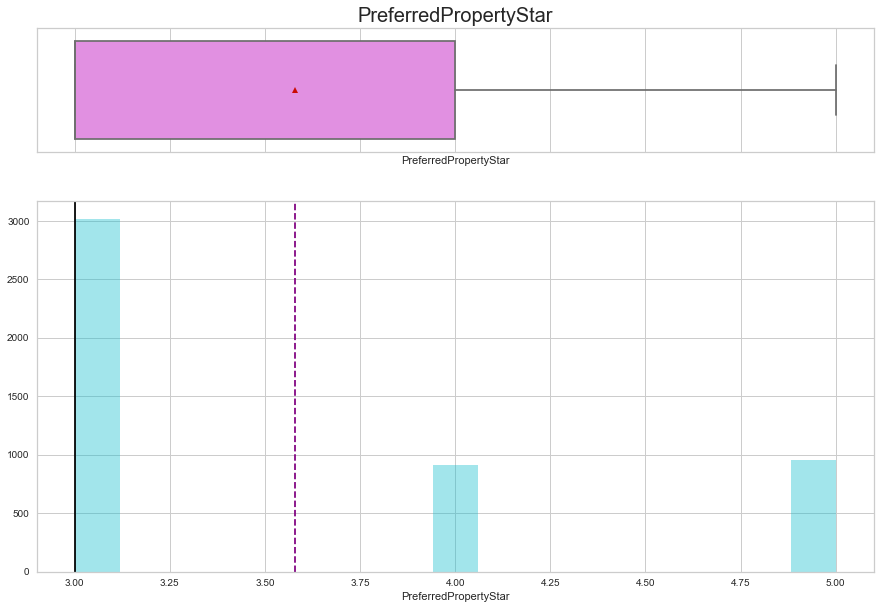

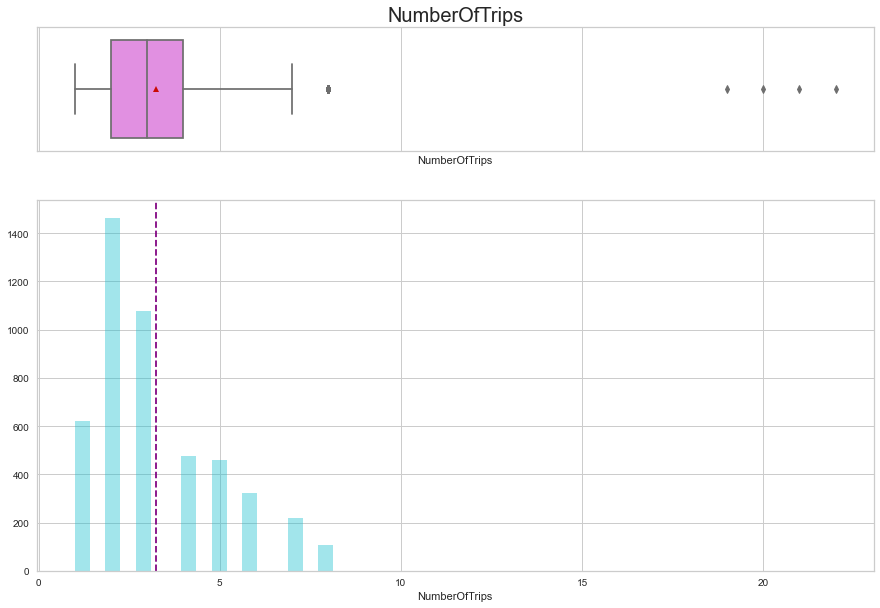

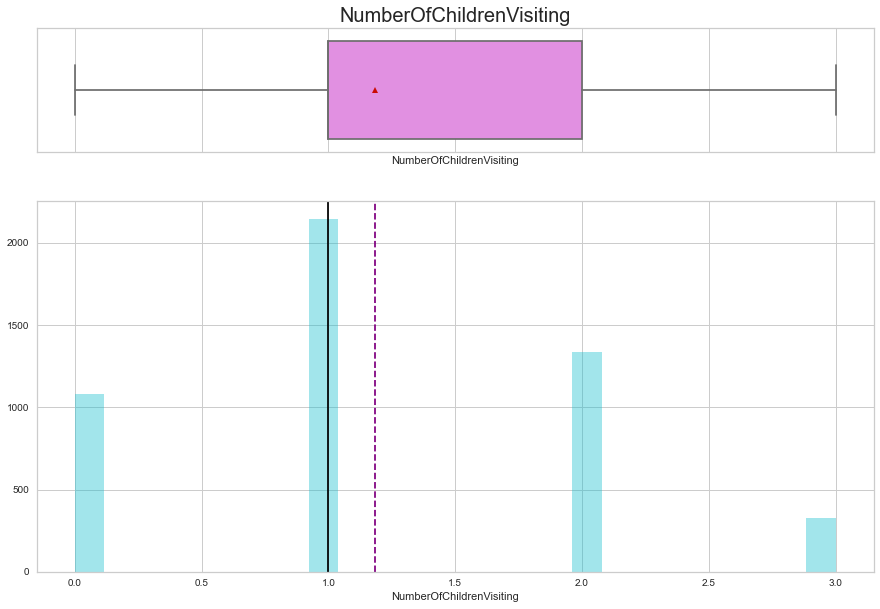

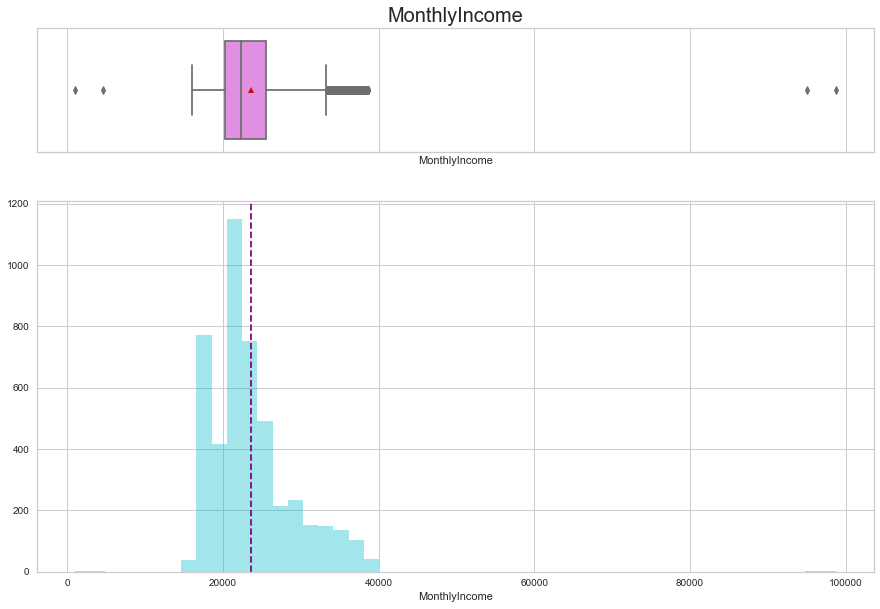

In [102]:
for col in float_cols:
    histogram_boxplot(data[col])
    

### Observations
- Age looks normally distributed with a median age of 36.
- DurationOfPitch looks Right skewed due to some outliers. I am not going to remove them because, I want to add some corner cases to my model.
- NumberOfTrips looks right skewed due to some outliers.
- MonthyIncome has some very low values, these values indicates some wrong entry. Also there are outliers on the higher end. 

In [173]:
# Function to create barplots that indicate percentage for each category.

def perc_on_bar(z):
    '''
    plot
    feature: categorical feature
    the function won't work if a column is passed in hue parameter
    '''

    total = len(data[z]) # length of the column
    plt.figure(figsize=(15,5))
    plt.title(z, fontsize=20)
    plt.xticks(rotation=45)
    plt.xlabel(None)
    ax = sns.countplot(data[z],palette='Paired')
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total) # percentage of each class of the category
        x = p.get_x() + p.get_width() / 2 - 0.05 # width of the plot
        y = p.get_y() + p.get_height()           # hieght of the plot
        
        ax.annotate(percentage, (x, y), size = 12) # annotate the percantage 
    plt.show() # show the plot

### Barplots for categorical columns

#### Plotting only string Categorical columns

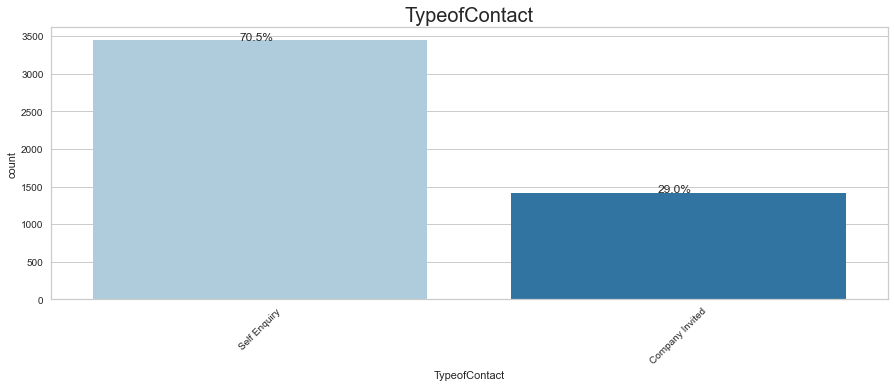

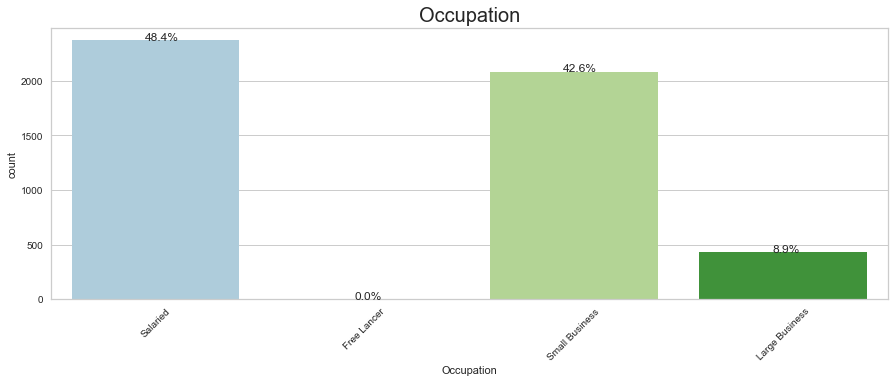

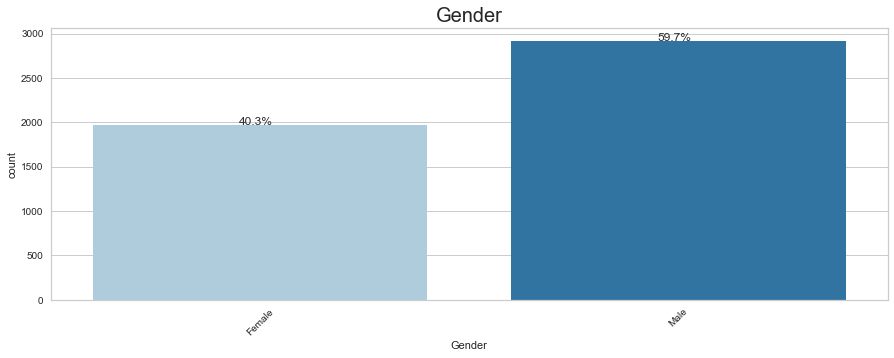

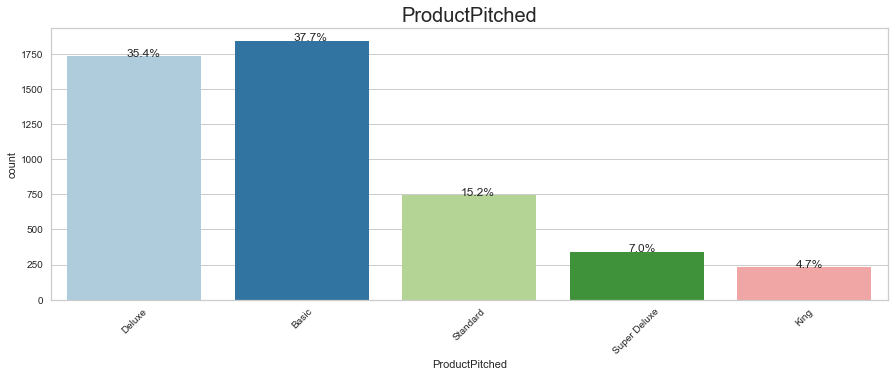

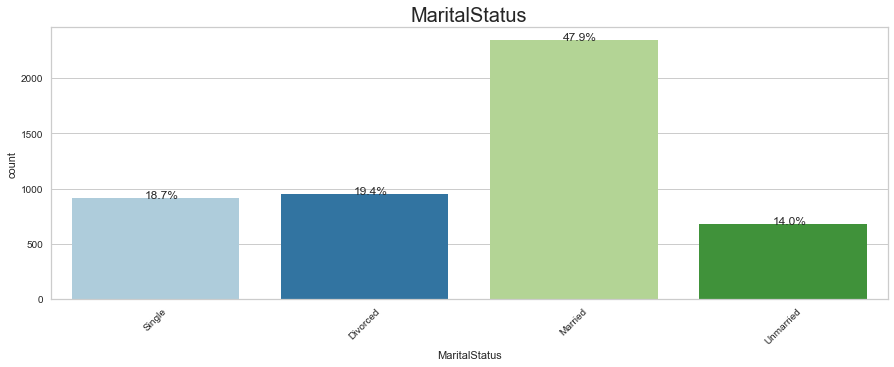

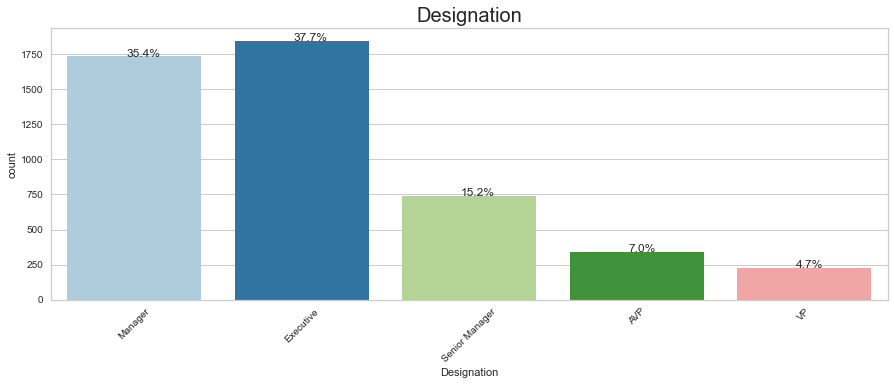

In [104]:
for col in str_category_cols:
    perc_on_bar(col)


### Observations
- 70% of the customers enquired for tourism packages. 
- There are more salaried customers follower by small business customers. Both of the contribute to 90% of our customers.
- There are more Male customers
- Baisc and Deluxe are popular packages.
- Married people buy 50% of tourism packages
- Executives and Managers contribute to 60% of the clients.
- Married Executive and Managers can be good candidates for wellness packages.

#### Plotting only ordinal Categorical columns

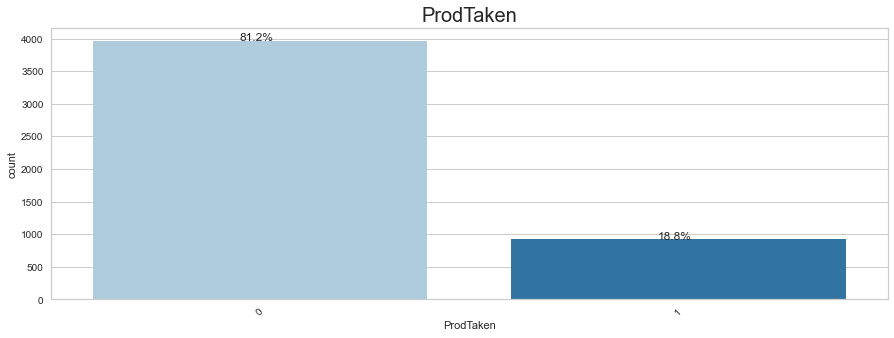

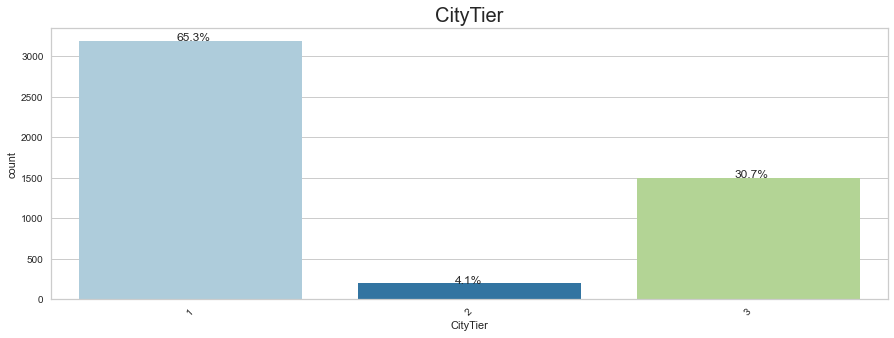

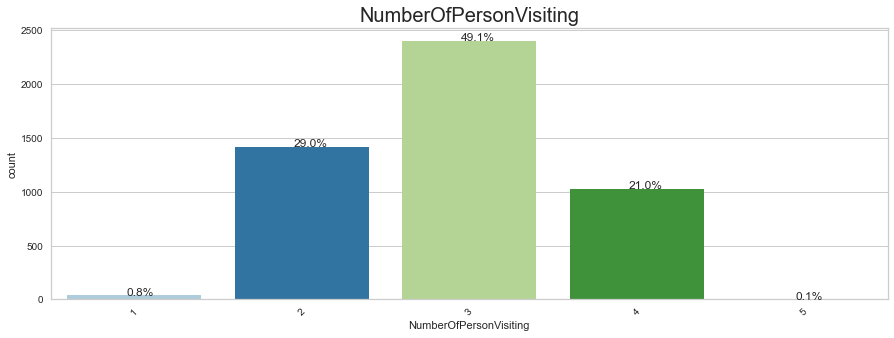

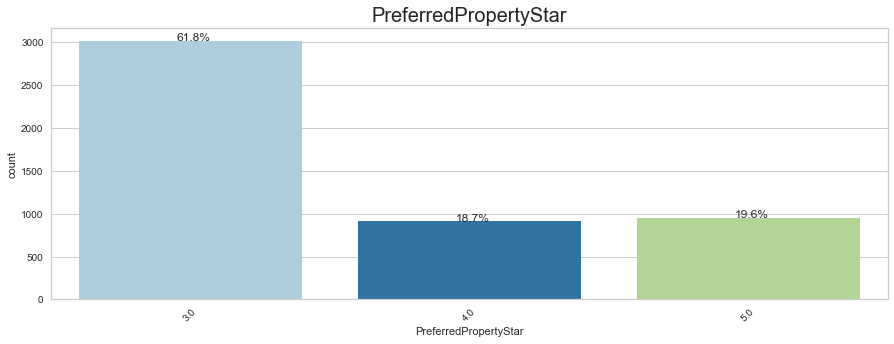

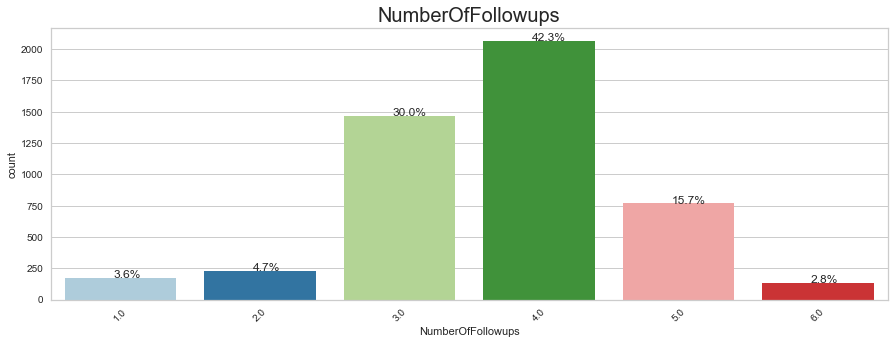

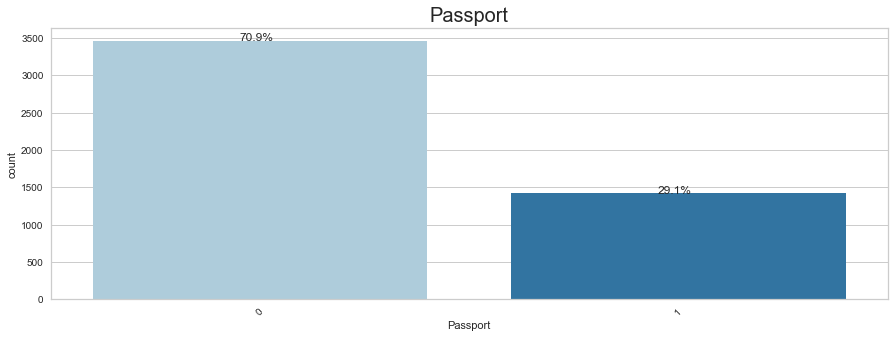

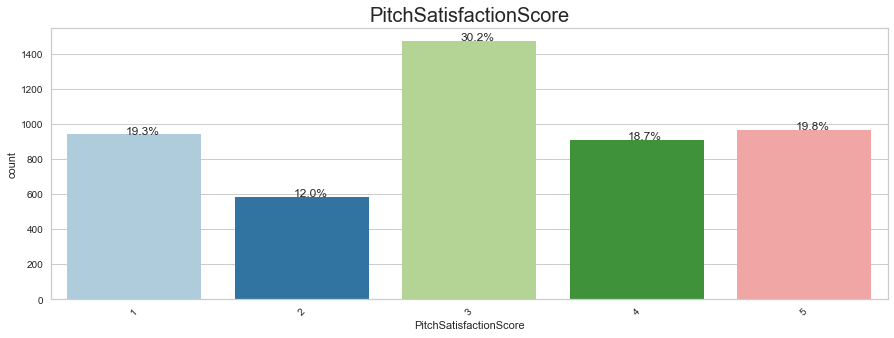

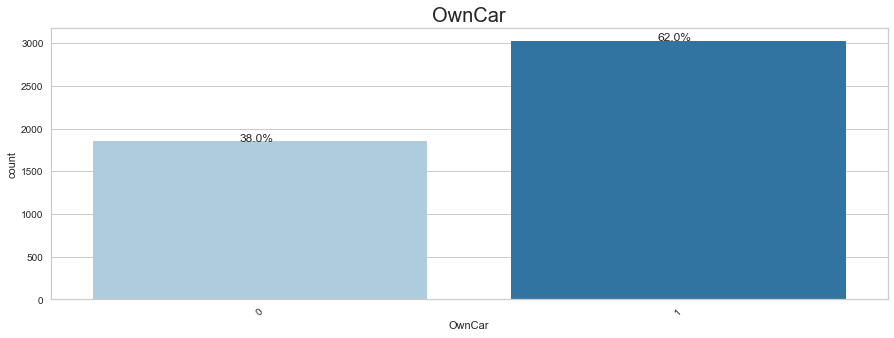

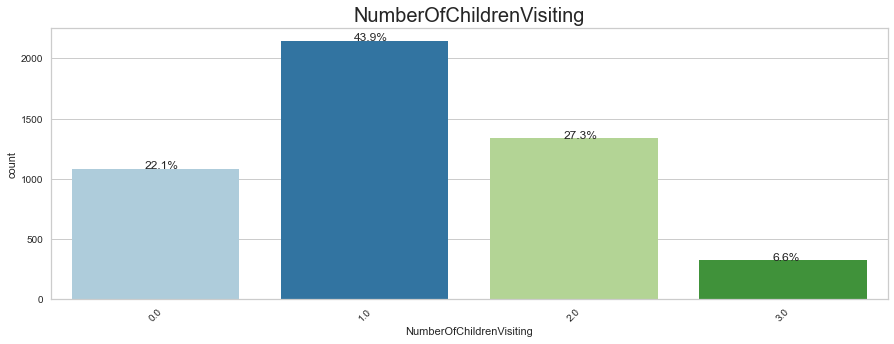

In [105]:
for col in number_category_cols:
    perc_on_bar(col)


### Observations
- Only 19% of the customers took Packages. 
- Tier1 city customers are more interested in package deals
- 50% of the time only 3 people will visit the destination 
- 3 start hotels are more popular than higher stars. Looks like most of the customers prefer budget friendly pacakges
- Only 30% of the pople hold passports. We can concentrate on more domestic destinations than international ones
- Mostly there will be 1 child visiting the places.
- Average Pitch satisfaction score is 3. How can we improve this score? Reduce the number of followups by knowing the customer better?
- Mostly of the customers require 4 followups. This count should be reduced. Let's explore further

## Bivariate Analysis

### HeatMap for Numerical columns

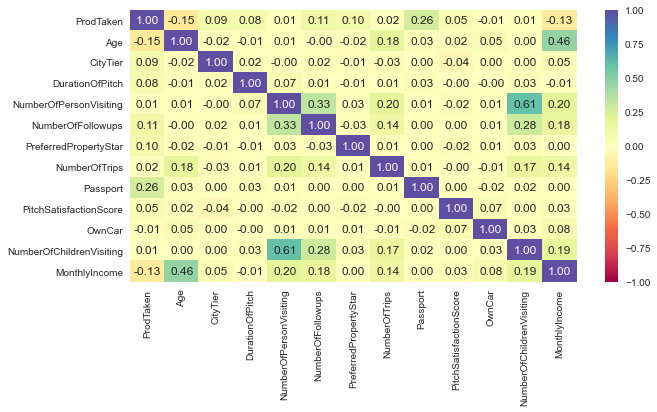

In [106]:
plt.figure(figsize=(10,5))
sns.heatmap(data.corr(),annot=True,vmin=-1,vmax=1,fmt='.2f',cmap='Spectral')
plt.show()

### Observations
- MonthlyIncome are positively correlated with Age, NumberOfPersonVisiting, NumnerOfFollowups, NumerOfTrips and NumberOfChildrenVisiting.
- Age is postively correlated with NumberOfTrips and MonthlyIncome
- There is no correlation with DurationOfPitch
- NumberOfTrips has a positive correlation between Age, MonthlyIncom, NumberOfPersonVisiting, NumberOfFollowups, NumberOfTrips and NumberOfChildrenVisiting
- NumberOfFollowups has a postive correlation with ProdTaken, NumberOfPersonVisiting, NumberOfTrips, NumberOfChildrenVisiting and MonthlyIncome
- NumberOfPersonVisiting and NumberOfChildrenVisting has high collinearity. That makes sense because as the number of children increases, number of persons visting also increases.
- It is interesting to see negative collinearity between MonthlyIncome and prodTaken

### Stacked bar plot for categorical columns

In [107]:
### Function to plot stacked bar charts for categorical columns
def stacked_plot(x, feature):
    sns.set()
    print('-'*120)
   
    ## crosstab 
    tab1 = pd.crosstab(x,data['ProdTaken'],margins=True).sort_values(by=0,ascending=False)
    print(tab1)
    
    ## visualising the cross tab
    tab = pd.crosstab(x,data['ProdTaken'],normalize='index').sort_values(by=0,ascending=False)
    tab.plot(kind='bar',stacked=True,figsize=(17,7))
#     plt.legend(loc='lower left', frameon=False,)
    plt.legend(loc="upper left", bbox_to_anchor=(1,1))
    plt.title(feature, fontsize=20)
    plt.show()

### ProdTaken vrs String categorical columns

------------------------------------------------------------------------------------------------------------------------
ProdTaken           0    1   All
TypeofContact                   
All              3946  917  4863
Self Enquiry     2837  607  3444
Company Invited  1109  310  1419


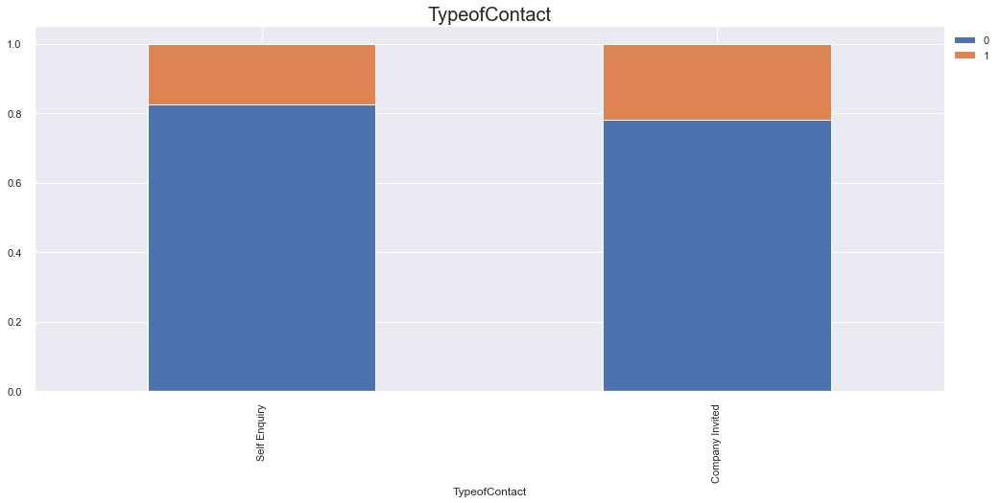

------------------------------------------------------------------------------------------------------------------------
ProdTaken          0    1   All
Occupation                     
All             3968  920  4888
Salaried        1954  414  2368
Small Business  1700  384  2084
Large Business   314  120   434
Free Lancer        0    2     2


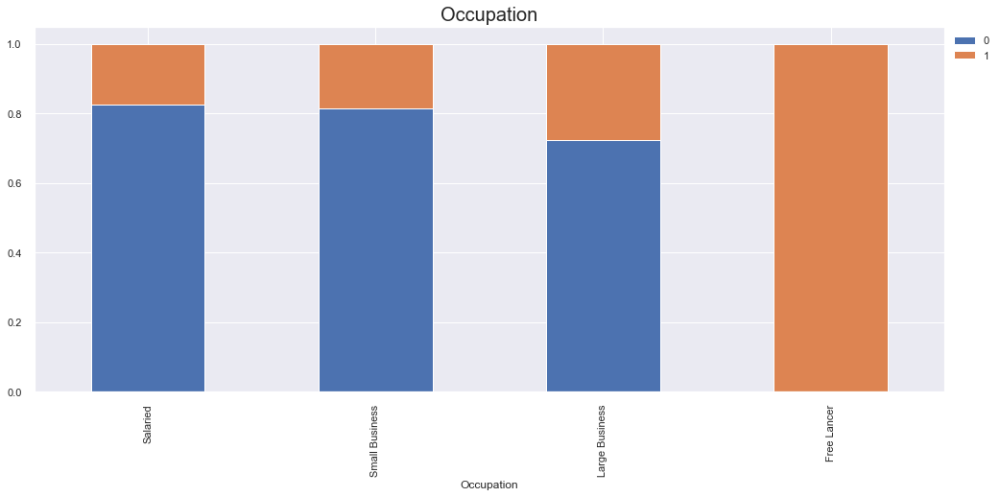

------------------------------------------------------------------------------------------------------------------------
ProdTaken     0    1   All
Gender                    
All        3968  920  4888
Male       2338  578  2916
Female     1630  342  1972


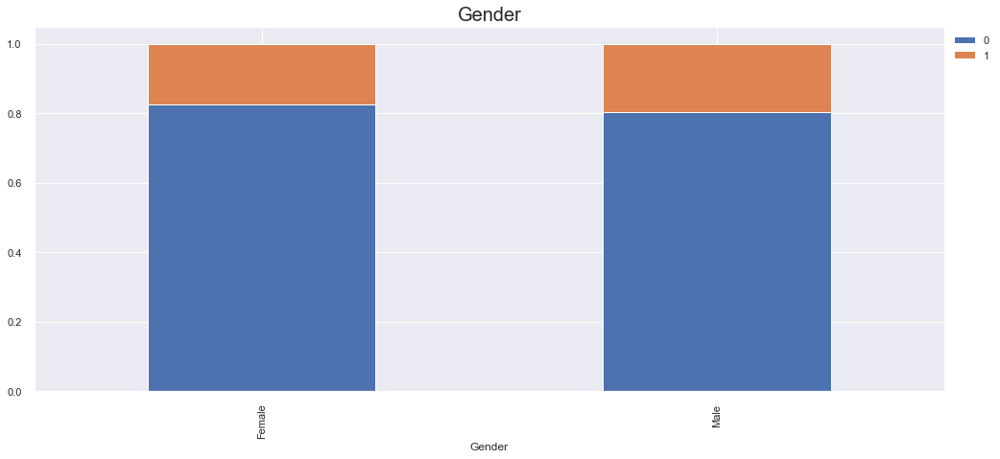

------------------------------------------------------------------------------------------------------------------------
ProdTaken          0    1   All
ProductPitched                 
All             3968  920  4888
Deluxe          1528  204  1732
Basic           1290  552  1842
Standard         618  124   742
Super Deluxe     322   20   342
King             210   20   230


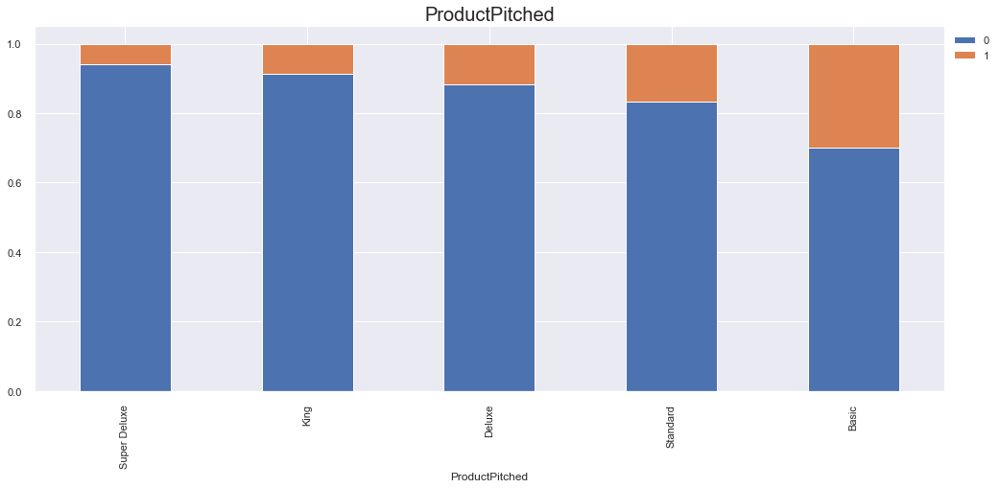

------------------------------------------------------------------------------------------------------------------------
ProdTaken         0    1   All
MaritalStatus                 
All            3968  920  4888
Married        2014  326  2340
Divorced        826  124   950
Single          612  304   916
Unmarried       516  166   682


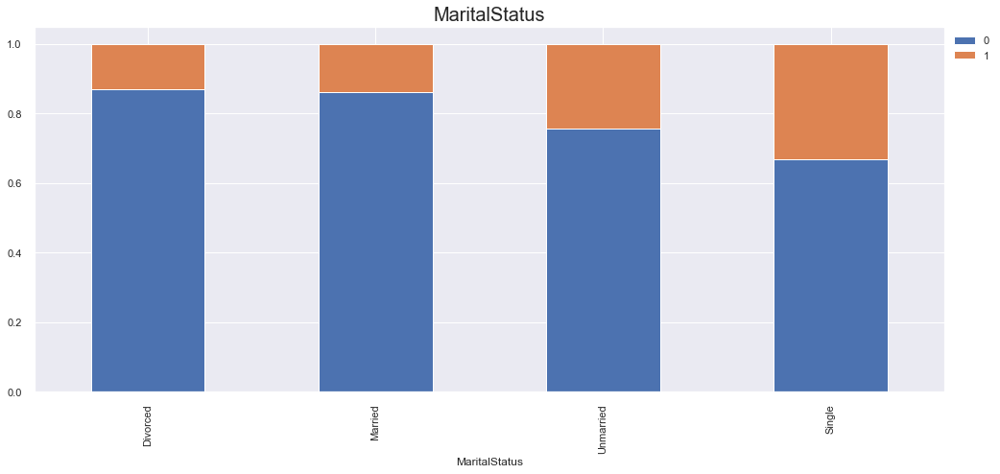

------------------------------------------------------------------------------------------------------------------------
ProdTaken          0    1   All
Designation                    
All             3968  920  4888
Manager         1528  204  1732
Executive       1290  552  1842
Senior Manager   618  124   742
AVP              322   20   342
VP               210   20   230


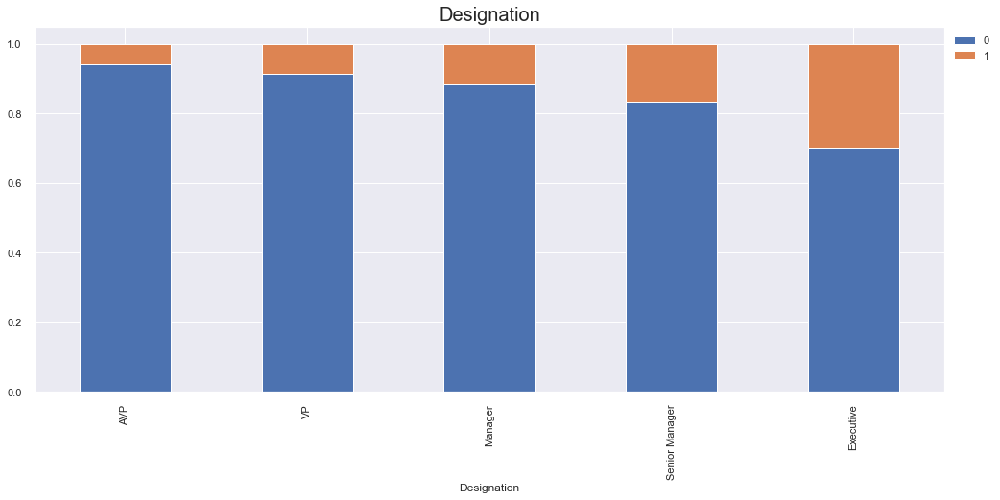

In [108]:
for col in str_category_cols:
    stacked_plot(data[col], col)


### Observations

- There is no significant difference in terms of Product taken for Self Enquiry and Company invited customers
- Out of all customers, Ratio of Large business customers who purchased packages are more when compared to others.
- In terms of ratio of products pitched and actual purchase, Basic and Standard take the lead followed by Deluxe
- In terms of Product taken ratios, Single and Unmarried customers tend to buy more.
- In terms of Product taken ratios, Executives and Senior Manager tend to buy more

### ProdTaken vrs ordinal categorical columns

------------------------------------------------------------------------------------------------------------------------
ProdTaken     0    1   All
CityTier                  
All        3968  920  4888
1          2670  520  3190
3          1146  354  1500
2           152   46   198


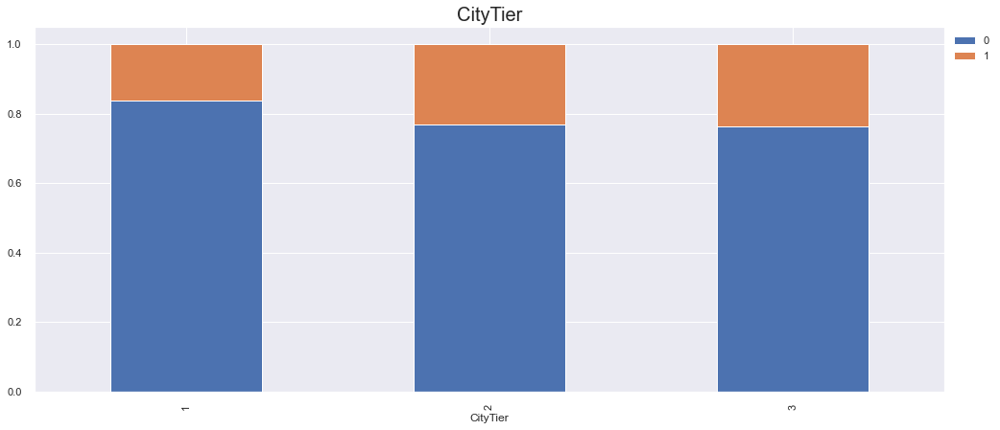

------------------------------------------------------------------------------------------------------------------------
ProdTaken                  0    1   All
NumberOfPersonVisiting                 
All                     3968  920  4888
3                       1942  460  2402
2                       1151  267  1418
4                        833  193  1026
1                         39    0    39
5                          3    0     3


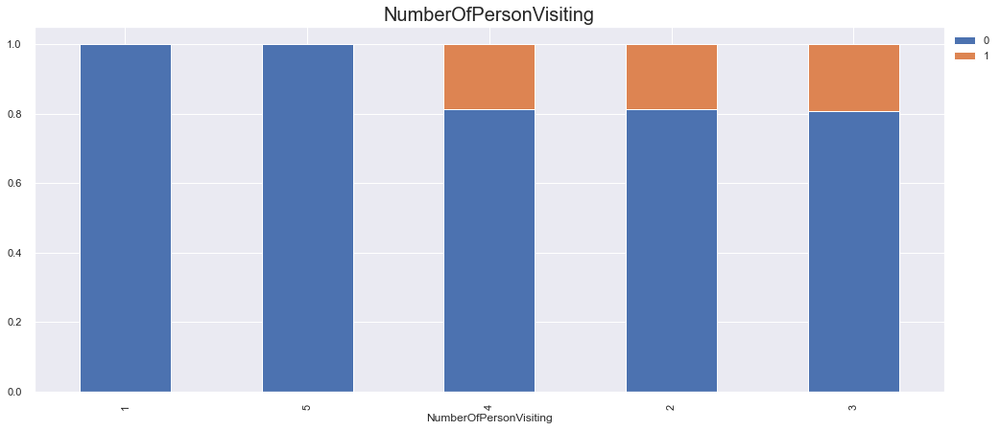

------------------------------------------------------------------------------------------------------------------------
ProdTaken                 0    1   All
PreferredPropertyStar                 
All                    3968  920  4888
3.0                    2531  488  3019
4.0                     731  182   913
5.0                     706  250   956


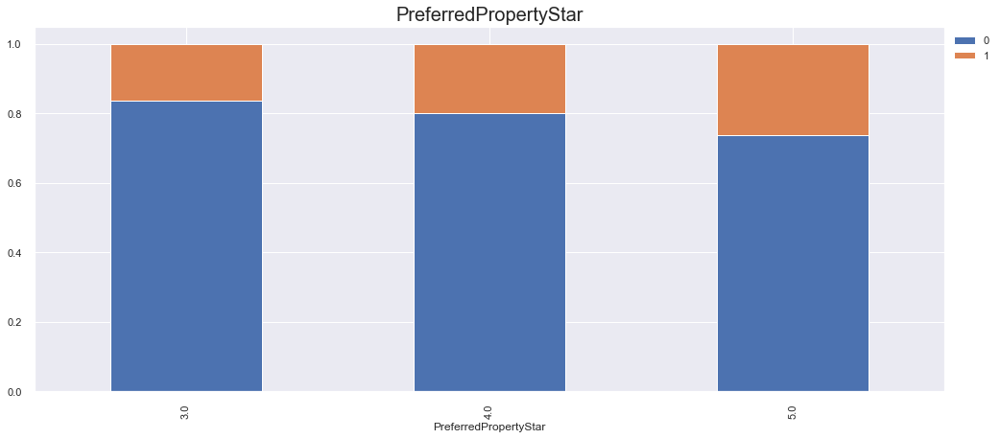

------------------------------------------------------------------------------------------------------------------------
ProdTaken             0    1   All
NumberOfFollowups                 
All                3931  912  4843
4.0                1689  379  2068
3.0                1222  244  1466
5.0                 577  191   768
2.0                 205   24   229
1.0                 156   20   176
6.0                  82   54   136


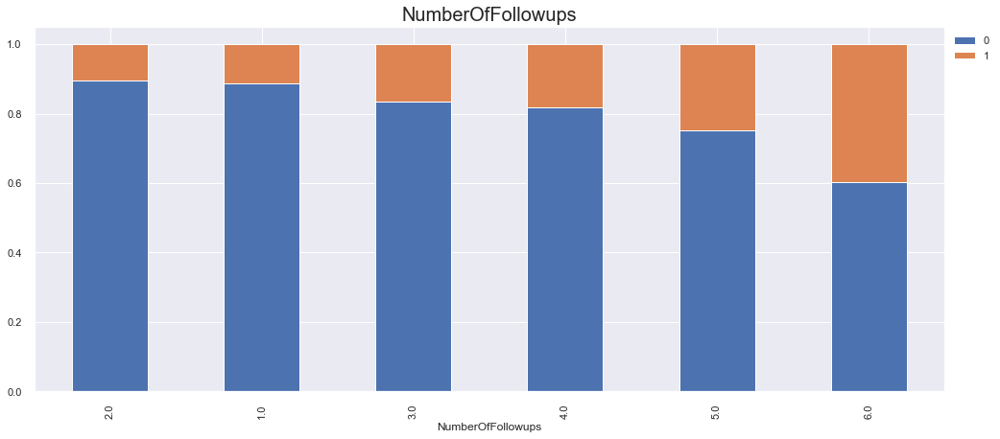

------------------------------------------------------------------------------------------------------------------------
ProdTaken     0    1   All
Passport                  
All        3968  920  4888
0          3040  426  3466
1           928  494  1422


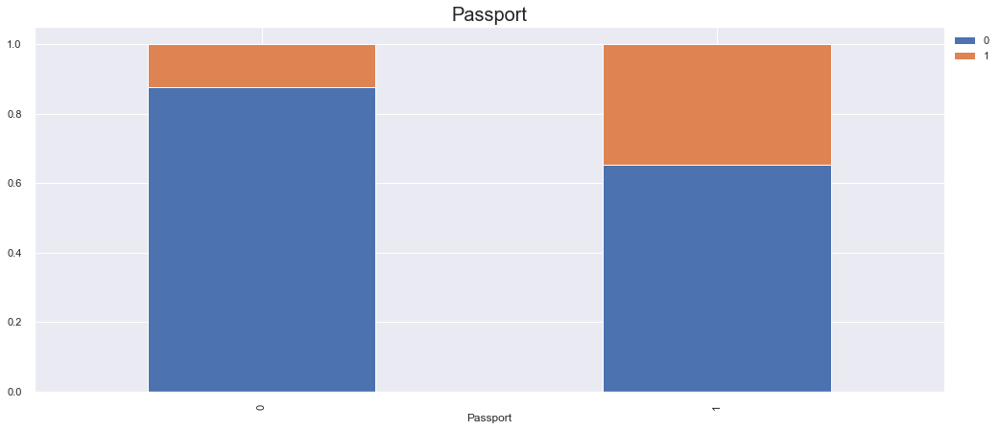

------------------------------------------------------------------------------------------------------------------------
ProdTaken                  0    1   All
PitchSatisfactionScore                 
All                     3968  920  4888
3                       1162  316  1478
1                        798  144   942
5                        760  210   970
4                        750  162   912
2                        498   88   586


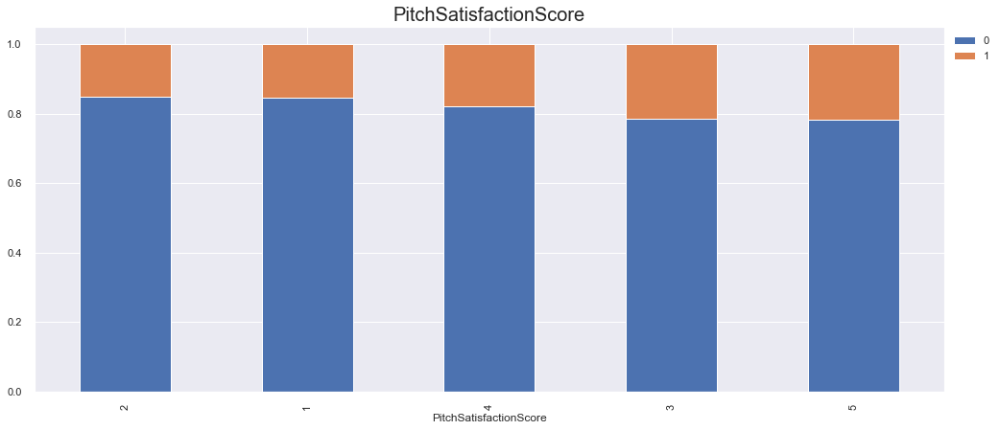

------------------------------------------------------------------------------------------------------------------------
ProdTaken     0    1   All
OwnCar                    
All        3968  920  4888
1          2472  560  3032
0          1496  360  1856


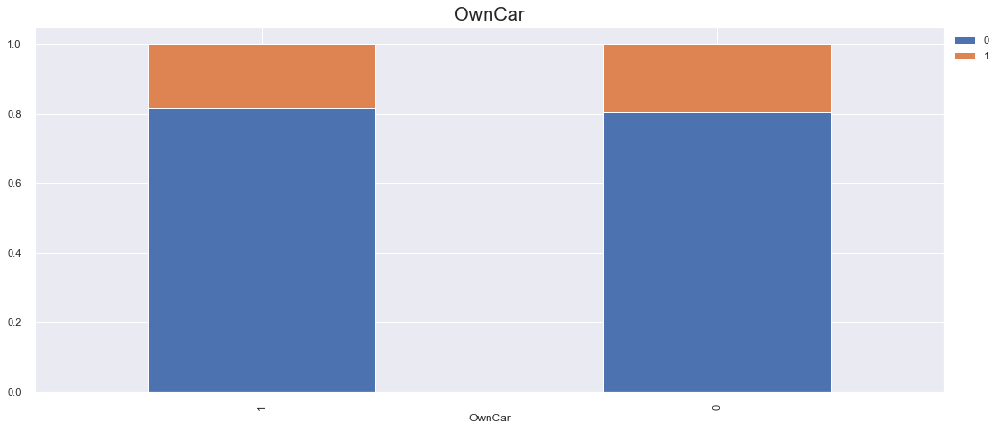

------------------------------------------------------------------------------------------------------------------------
ProdTaken                    0    1   All
NumberOfChildrenVisiting                 
All                       3968  920  4888
1.0                       1747  399  2146
2.0                       1082  253  1335
0.0                        880  202  1082
3.0                        259   66   325


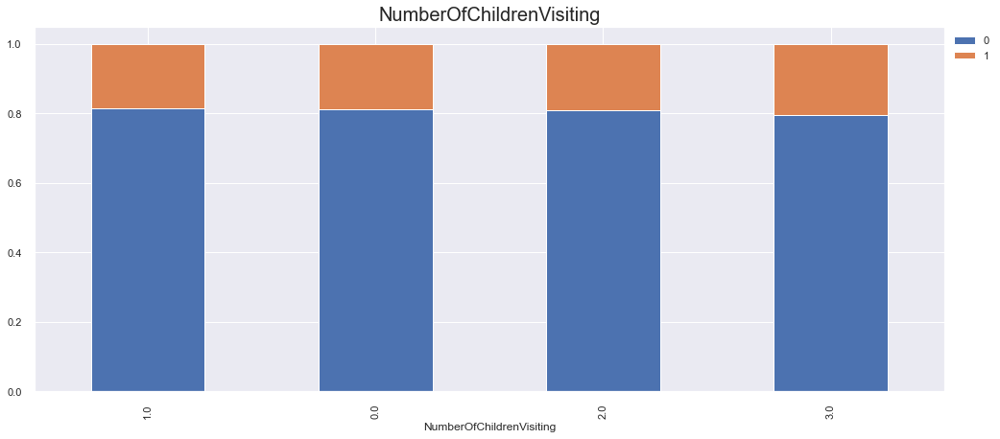

In [109]:
for col in number_category_cols:
    if col != "ProdTaken":
        stacked_plot(data[col], col)

### Observations
- Customers from tier3 cities tend to take our packages, followed by tier2
- Customers with 1 and 5 persons visiting the location did not take the Package at all
- Customers with passport tend to purchase more packages than others

In [110]:
### Function to plot distributions and Boxplots of customers
def plot(x,target='ProdTaken'):
    fig,axs = plt.subplots(2,2,figsize=(12,10))
    axs[0, 0].set_title(f'Distribution of {x} of people who did not take Product',fontsize=12,fontweight='bold')
    sns.distplot(data[(data[target] == 0)][x],ax=axs[0,0],color='teal')
    axs[0, 1].set_title(f"Distribution of {x} of people who took Product",fontsize=12,fontweight='bold')
    sns.distplot(data[(data[target] == 1)][x],ax=axs[0,1],color='orange')
       
    line = plt.Line2D((.1,.9),(.5,.5), color='grey', linewidth=1.5,linestyle='--')
    fig.add_artist(line)
   
    axs[1,0].set_title(f'Boxplot of {x} w.r.t ProdTaken',fontsize=12,fontweight='bold')
    sns.boxplot(data[target],data[x],ax=axs[1,0],palette='gist_rainbow',showmeans=True)
    axs[1,1].set_title(f'Boxplot of {x} w.r.t ProdTaken - Without outliers',fontsize=12,fontweight='bold')
    sns.boxplot(data[target],data[x],ax=axs[1,1],showfliers=False,palette='gist_rainbow',showmeans=True) #turning off outliers from boxplot
    plt.tight_layout(pad=4)
    plt.show()

### ProductTaken vrs Age

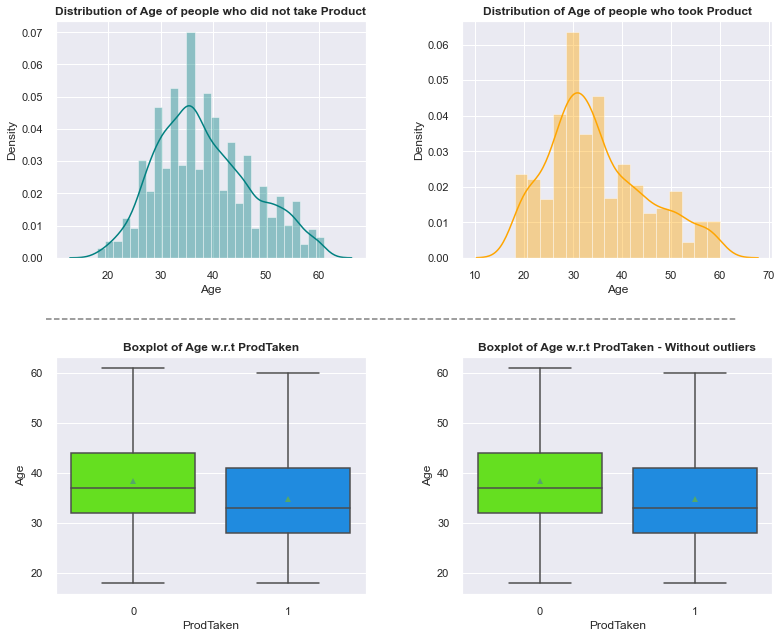

In [111]:
plot('Age')

### Observations
- Age of customers who bought the product ranged from 28 to 42. Looks like younger age customers like to purchase more


### ProductTaken vrs MonthlyIncome

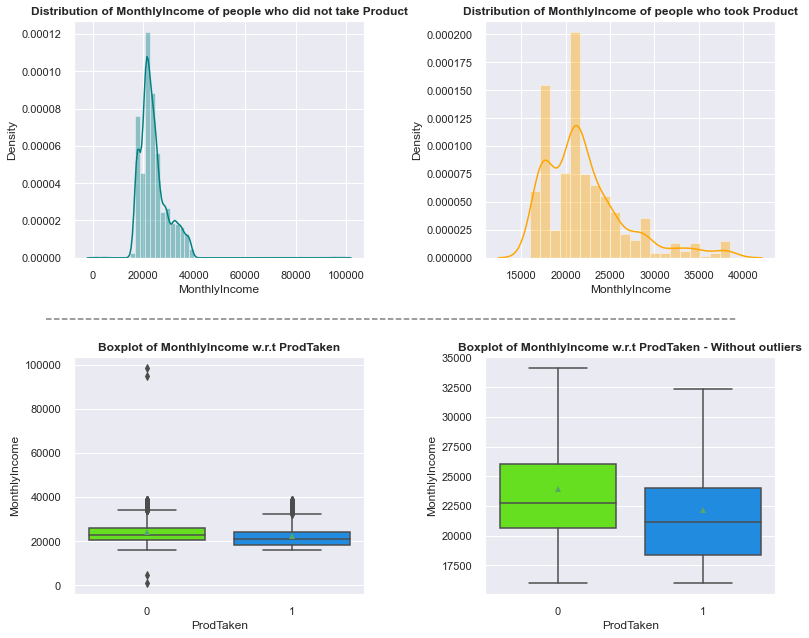

In [112]:
plot("MonthlyIncome")

### Observations
- Customers with income ranging from 17500 to 25000 bought More products. This also aligns with the previous observation of Age

### ProductTaken vrs DurationOfPitch

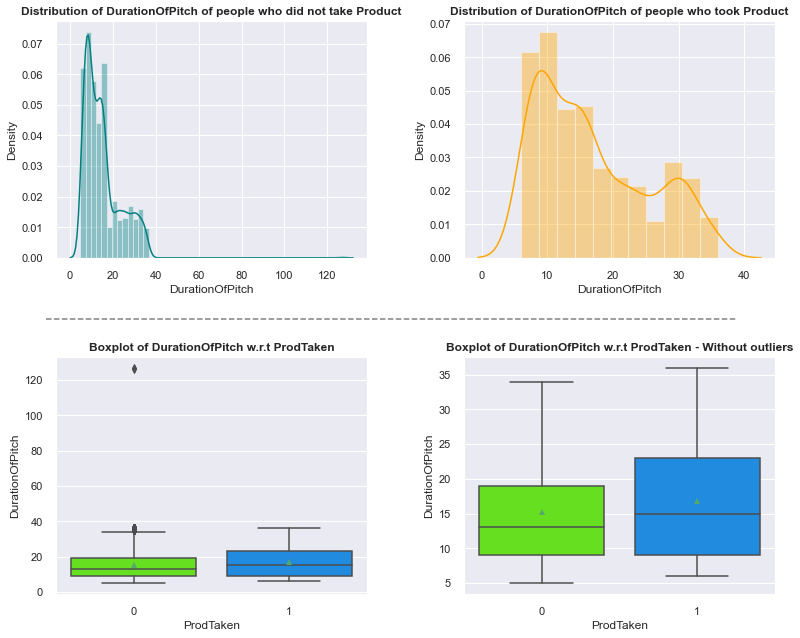

In [113]:
plot("DurationOfPitch")

### Observations
- There is not much differene here. Howeve 10 to 25 mins looks like a sweet spot for durationOd Pitch.

In [114]:
### ProductTaken vrs NumberOfTrips

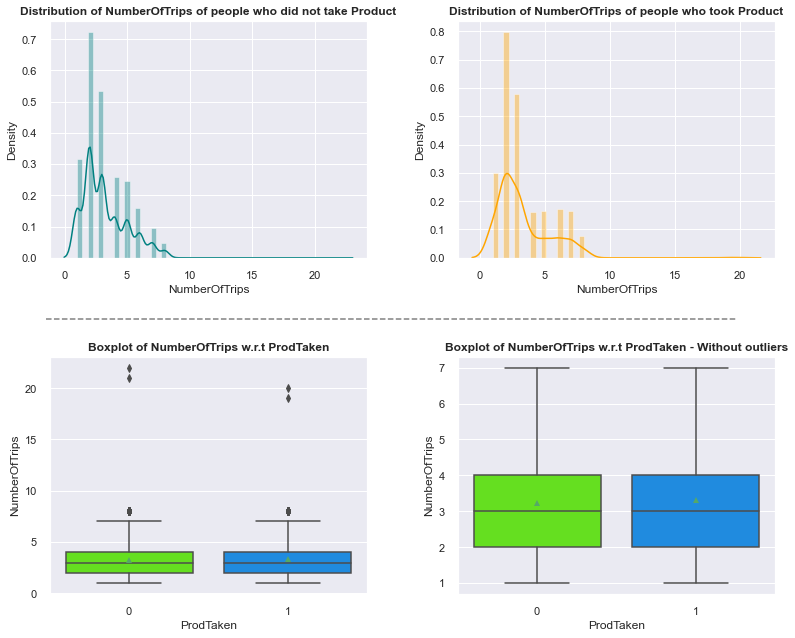

In [115]:
plot("NumberOfTrips")

### Observations
- There is no difference here.

### MonthlyIncome vrs Age

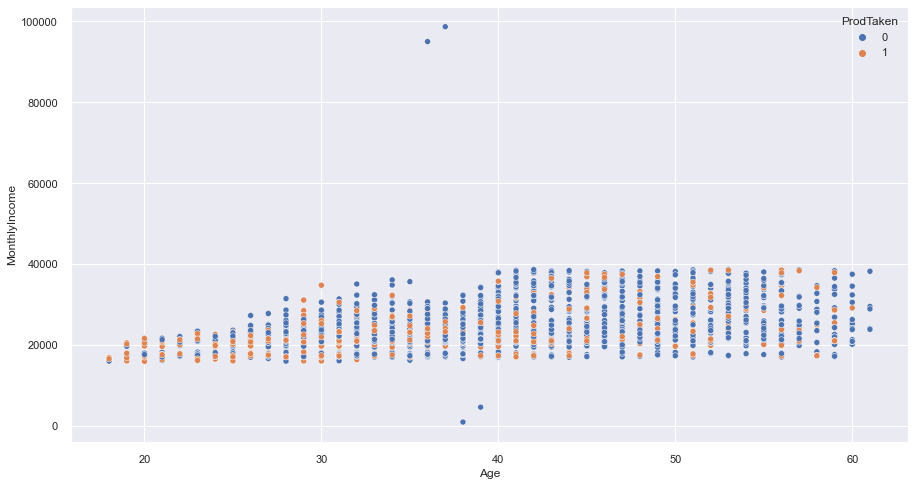

In [116]:
plt.figure(figsize=(15,8))
sns.scatterplot(x="Age", y="MonthlyIncome", data=data, hue="ProdTaken");


### Observations
- Age and MonthlyIncome are positively correlated. Younger Age customers tend to buy Product more.

### DurationOfPitch vrs Designation with hue as ProdTaken

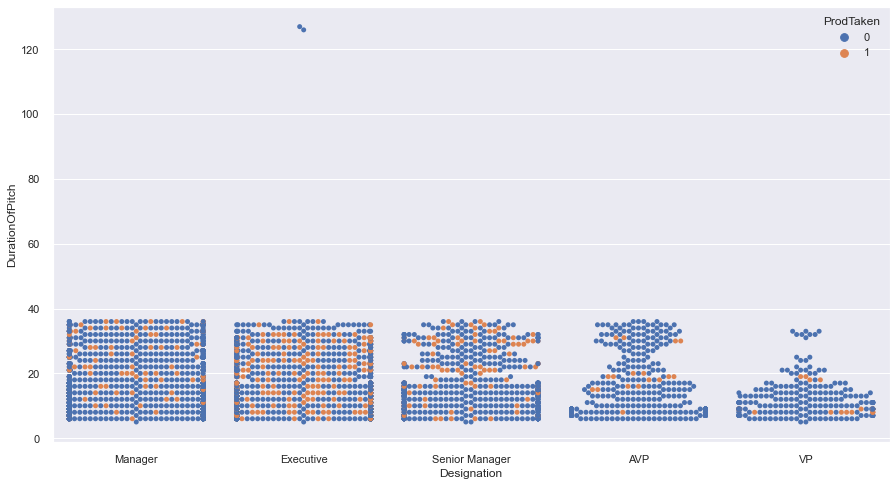

In [117]:
plt.figure(figsize=(15,8))
sns.swarmplot(x="Designation", data=data, y="DurationOfPitch", hue="ProdTaken");

### Observations
- Since executives are our best customers, there are 2 instance where the DurationOfPitch went to nearly 2 hrs. Otherwise most of the times it is inbetween 10 to 35 mins.

### MonthlyIncome vrs Designation with hue as ProdTaken

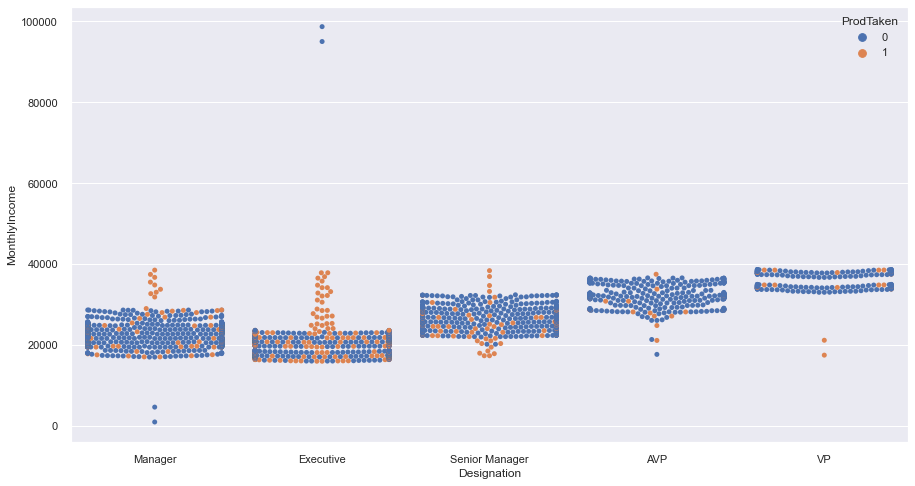

In [118]:
plt.figure(figsize=(15,8))
sns.swarmplot(x="Designation", data=data, y="MonthlyIncome", hue="ProdTaken");

### Observations
- Executives between monthlyIncome of 25000 and 40000 are our best customers. We can suggest wellness package to them
- Most of our customers who bought Product have a monthlyIncome ranging from 15000 to 40000

### ProductPitched vrs MonthlyIncome with hue as ProdTaken

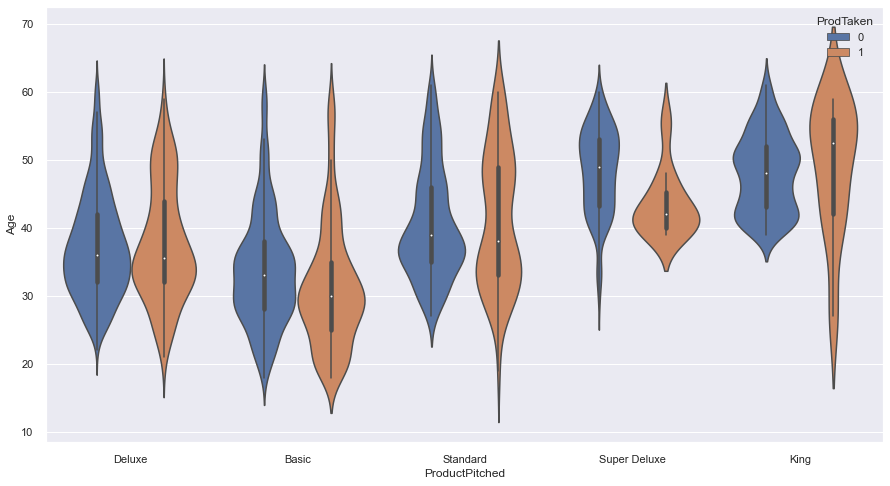

In [119]:
plt.figure(figsize=(15,8))
sns.violinplot(x="ProductPitched", data=data, y="Age", hue="ProdTaken");

### Observations
- Elderly people who are above 65 years of Age like King Package. These people can prefer Wellness Package as they can spend more
- Middle age people who are around 40 years of age prefer Super Deluxe package.



### ProductPitched vrs NumberOfTrips with hue as ProdTaken

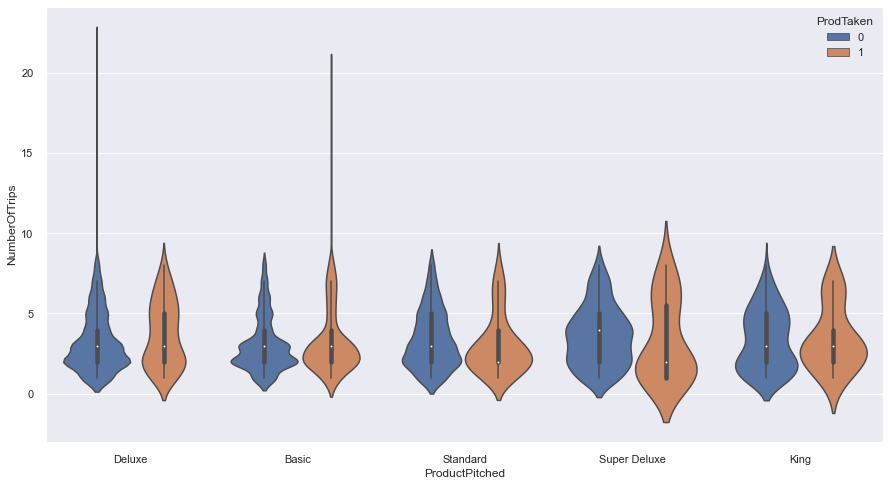

In [120]:
plt.figure(figsize=(15,8))
sns.violinplot(x="ProductPitched", data=data, y="NumberOfTrips", hue="ProdTaken");

### Observations
- Basic is the popular Package for frequent buyers, followed by Super Deluxe

In [121]:
### Function to plot stacked bar charts for categorical columns
def stacked_plot_with_target(x, feature, target_col):
    sns.set()
    print('-'*120)
   
    ## crosstab 
    tab1 = pd.crosstab(x,data[target_col],margins=True).sort_values(by=0,ascending=False)
    print(tab1)
    
    ## visualising the cross tab
    tab = pd.crosstab(x,data[target_col],normalize='index').sort_values(by=0,ascending=False)
    tab.plot(kind='bar',stacked=True,figsize=(17,7))
#     plt.legend(loc='lower left', frameon=False,)
    plt.legend(loc="upper left", bbox_to_anchor=(1,1))
    plt.title(feature, fontsize=20)
    plt.show()

## Data Pre-Processing

### Convert to Category data type

In [124]:
def convert_to_category(col):
   data[col] = data[col].astype("category")

for col in str_category_cols:
    convert_to_category(col)
for col in number_category_cols:
    convert_to_category(col)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4888 entries, 0 to 4887
Data columns (total 19 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   ProdTaken                 4888 non-null   category
 1   Age                       4662 non-null   float64 
 2   TypeofContact             4863 non-null   category
 3   CityTier                  4888 non-null   category
 4   DurationOfPitch           4637 non-null   float64 
 5   Occupation                4888 non-null   category
 6   Gender                    4888 non-null   category
 7   NumberOfPersonVisiting    4888 non-null   category
 8   NumberOfFollowups         4843 non-null   category
 9   ProductPitched            4888 non-null   category
 10  PreferredPropertyStar     4888 non-null   category
 11  MaritalStatus             4888 non-null   category
 12  NumberOfTrips             4748 non-null   float64 
 13  Passport                  4888 non-null   catego

### Observations
- After converting to category datatype, Memory usage has reduced from 763 KB to 227 KB

In [126]:
float_cols = data.select_dtypes(include=['float64'], exclude=['category']).columns
float_cols

Index(['Age', 'DurationOfPitch', 'NumberOfTrips', 'MonthlyIncome'], dtype='object')

### Identify outliers

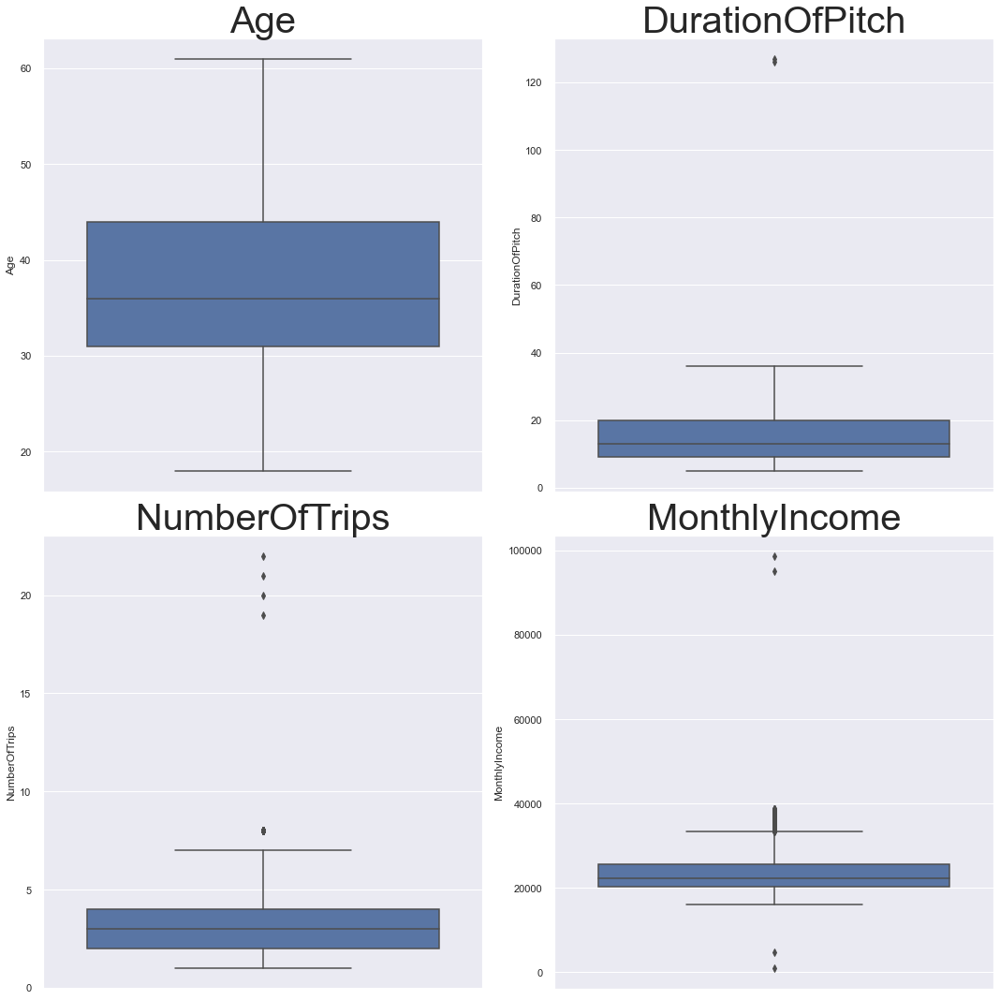

In [127]:
# outlier detection using boxplot
plt.figure(figsize=(15,15))
for i, col in enumerate(float_cols):
    plt.subplot(2,2,i+1)
    sns.boxplot(data=data, y=col)
    plt.tight_layout()
    plt.title(col, fontdict={"fontsize":40})



### Observations
- MontlyIncome has some outliers that are touching zero. This looks like a data issue.
- From previous EDA, we found that NumberOfTrips have no impact on ProductTaken. So we can remove those outliers
- There is an Outlier for DurationOfPitch. But I won't delete it since I am using trees

In [128]:
def treat_outliers(data,col):
    '''
    treats outliers in a varaible
    col: str, name of the numerical varaible
    data: data frame
    col: name of the column
    '''
    Q1=data[col].quantile(0.25) # 25th quantile
    Q3=data[col].quantile(0.75)  # 75th quantile
    IQR=Q3-Q1
    Lower_Whisker = Q1 - 1.5*IQR 
    Upper_Whisker = Q3 + 1.5*IQR
    data[col] = np.clip(data[col], Lower_Whisker, Upper_Whisker) # all the values smaller than Lower_Whisker will be assigned value of Lower_whisker 
                                                            # and all the values above upper_whisker will be assigned value of upper_Whisker 
    return data

# Treat outliers only for Mortgage
treat_outliers(data, "MonthlyIncome")

,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
0,1,41.0,Self Enquiry,3,6.0,Salaried,Female,3,3.0,Deluxe,3.0,Single,1.0,1,2,1,0.0,Manager,20993.0
1,0,49.0,Company Invited,1,14.0,Salaried,Male,3,4.0,Deluxe,4.0,Divorced,2.0,0,3,1,2.0,Manager,20130.0
2,1,37.0,Self Enquiry,1,8.0,Free Lancer,Male,3,4.0,Basic,3.0,Single,7.0,1,3,0,0.0,Executive,17090.0
3,0,33.0,Company Invited,1,9.0,Salaried,Female,2,3.0,Basic,3.0,Divorced,2.0,1,5,1,1.0,Executive,17909.0
4,0,NaN,Self Enquiry,1,8.0,Small Business,Male,2,3.0,Basic,4.0,Divorced,1.0,0,5,1,0.0,Executive,18468.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4883,1,49.0,Self Enquiry,3,9.0,Small Business,Male,3,5.0,Deluxe,4.0,Unmarried,2.0,1,1,1,1.0,Manager,26576.0
4884,1,28.0,Company Invited,1,31.0,Salaried,Male,4,5.0,Basic,3.0,Single,3.0,1,3,1,2.0,Executive,21212.0
4885,1,52.0,Self Enquiry,3,17.0,Salaried,Female,4,4.0,Standard,4.0,Married,7.0,0,1,1,3.0,Senior Manager,31820.0
4886,1,19.0,Self Enquiry,3,16.0,Small Business,Male,3,4.0,Basic,3.0,Single,3.0,0,5,0,2.0,Executive,20289.0


### Look for missing data

In [130]:
pd.isna(data).sum().sort_values(ascending=False)

DurationOfPitch             251
MonthlyIncome               233
Age                         226
NumberOfTrips               140
NumberOfFollowups            45
TypeofContact                25
CityTier                      0
Occupation                    0
Gender                        0
NumberOfPersonVisiting        0
ProductPitched                0
Designation                   0
PreferredPropertyStar         0
MaritalStatus                 0
Passport                      0
PitchSatisfactionScore        0
OwnCar                        0
NumberOfChildrenVisiting      0
ProdTaken                     0
dtype: int64

<AxesSubplot:>

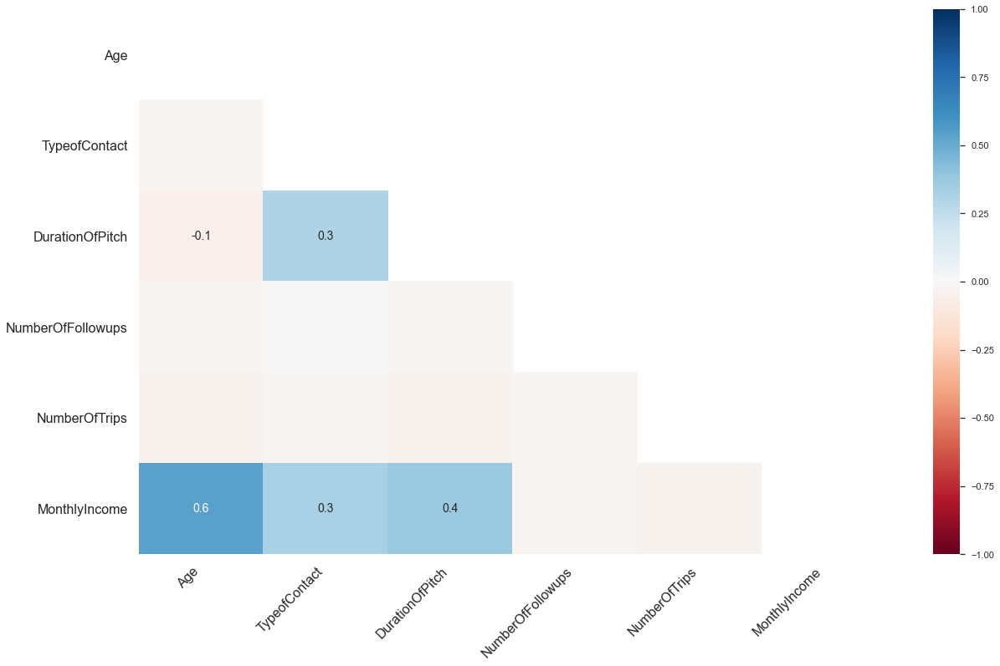

In [131]:
# nullity correlation
# Nullity correlation ranges from -1 (if one variable appears the other definitely does not) 
# to 0 (variables appearing or not appearing have no effect on one another) 
# to 1 (if one variable appears the other definitely also does).
mn.heatmap(data)

### Observations
- There is 60% chance that if MonthlyIncome is missing Age is also missing
- There is 30% chance that if MonthlyIncome is missing Age TypeofContact also missing
- There is 40% chance that if MonthlyIncome is missing DurationOfPitch is also missing
- There is 30% chance that if TypeofContact is missing Age DurationOfPitch also missing

### From heatmap, we observed that MonthlyIncome is positively correlated with 

- Age is postively correlated with NumberOfTrips and MonthlyIncome
- There is no correlation with DurationOfPitch

- NumberOfFollowups has a postive correlation with ProdTaken, NumberOfPersonVisiting, NumberOfTrips, NumberOfChildrenVisiting and MonthlyIncome
- NumberOfPersonVisiting and NumberOfChildrenVisting has high collinearity. That makes sense because as the number of children increases, number of persons visting also increases.


### Impute Monthy income based on gender, designation and occupation

#### From heatmap we observed that MonthlyIncome is positively correlated with Age, NumberOfPersonVisiting, NumberOfFollowups, NumerOfTrips and NumberOfChildrenVisiting.

In [134]:
data.loc[data["MonthlyIncome"].isna(), "Age"].min()

24.0

In [135]:
data.loc[data["MonthlyIncome"].isna(), "Age"].max()

56.0

In [136]:
data.loc[data["MonthlyIncome"].isna(), "NumberOfPersonVisiting"].unique()

[2, 3, 1, 4]
Categories (4, int64): [2, 3, 1, 4]

In [137]:
data.loc[data["MonthlyIncome"].isna(), "Designation"].unique()

['Manager', 'Executive']
Categories (2, object): ['Manager', 'Executive']

In [138]:
data.loc[data["MonthlyIncome"].isna() & data["Designation"].isin(["Manager", 'Executive']), "PreferredPropertyStar"].unique()

[3.0, 5.0, 4.0]
Categories (3, float64): [3.0, 5.0, 4.0]

In [139]:
data.loc[data["MonthlyIncome"].isna() & data["Designation"].isin(["Manager", 'Executive'] ), "Occupation"].unique()

['Salaried', 'Small Business', 'Large Business']
Categories (3, object): ['Salaried', 'Small Business', 'Large Business']

In [203]:
data.loc[
             (data["Designation"]=="Executive") & 
             (data["Gender"] == "Male") & 
             (data["NumberOfPersonVisiting"] == 1) &
             (data["Occupation"]=="Small Business") 

             , "MonthlyIncome"]

81      17859.0
172     17088.0
1551    17859.0
1642    17088.0
Name: MonthlyIncome, dtype: float64

In [200]:
def impute_monthly_income(gender, designation, occupation, no_of_person_visiting):
    data.loc[data["MonthlyIncome"].isna() & 
             (data["Designation"]==designation) & 
             (data["Gender"] == gender) & 
             (data["NumberOfPersonVisiting"] == no_of_person_visiting) &
             (data["Occupation"]==occupation) 
             , "MonthlyIncome"] = data.loc[ (data["Designation"]==designation) & 
                                             (data["Gender"] == gender) & 
                                             (data["NumberOfPersonVisiting"] == no_of_person_visiting) &
                                             (data["Occupation"]==occupation) 
                                             , "MonthlyIncome"].median()
                                                                        
for occupation in ['Salaried', 'Small Business', 'Large Business']:
    for designation in ["Manager", 'Executive'] :
            for gender in ["Male", "Female"]:
                for num_of_person_visting in [1,2,3,4]:
                    impute_monthly_income(gender, designation, occupation, num_of_person_visting)                                                

In [201]:
data.loc[data["MonthlyIncome"].isna()]

,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
57,0,33.0,Self Enquiry,1,29.0,Small Business,Female,1,3.0,Basic,5.0,Divorced,4.0,1,4,1,0.0,Executive,NaN
337,0,33.0,Self Enquiry,1,15.0,Salaried,Male,1,4.0,Basic,3.0,Single,1.0,0,2,1,0.0,Executive,NaN
1527,0,33.0,Self Enquiry,1,29.0,Small Business,Female,1,3.0,Basic,5.0,Married,4.0,1,4,0,0.0,Executive,NaN
1807,0,33.0,Self Enquiry,1,15.0,Salaried,Male,1,4.0,Basic,3.0,Single,1.0,0,1,1,0.0,Executive,NaN


##### There are still 4 missing values. Let's impute them manually

In [205]:
data.loc[
             (data["Designation"]=="Executive") & 
             (data["Gender"] == "Male") & 
             (data["NumberOfPersonVisiting"] == 1) &
             (data["Occupation"]=="Small Business") 

             , "MonthlyIncome"].median()

17473.5

In [212]:
data.loc[
             (data["Designation"]=="Executive") & 
             (data["Gender"] == "Male") & 
             (data["Occupation"]=="Salaried") 
             , "MonthlyIncome"].median()

20237.0

In [213]:
data.loc[
             (data["Designation"]=="Executive") & 
             (data["Gender"] == "Male") & 
             (data["Occupation"]=="Salaried")&
             (data["NumberOfPersonVisiting"] == 1)
             , "MonthlyIncome"] = 20237.0

In [206]:
data.loc[     (data["Designation"]=="Executive") & 
             (data["Gender"] == "Male") & 
             (data["NumberOfPersonVisiting"] == 1) &
             (data["Occupation"]=="Small Business") 
             , "MonthlyIncome"]=17473.5

In [208]:
data.loc[    (data["Designation"]=="Executive") & 
             (data["Gender"] == "Female") &
             (data["Occupation"]=="Small Business") 
             , "MonthlyIncome"].median()

20019.5

In [209]:
data.loc[     (data["Designation"]=="Executive") & 
             (data["Gender"] == "Female") & 
             (data["NumberOfPersonVisiting"] == 1) &
             (data["Occupation"]=="Small Business") 
             , "MonthlyIncome"]=20019.5

In [214]:
data.loc[data["MonthlyIncome"].isna()]

,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome


### Impute Age based on gender, designation and occupation

#### From heatmap, Age is postively correlated with NumberOfTrips and MonthlyIncome

In [142]:
data.loc[data["Age"].isna(), "Designation"].unique()

['Executive', 'Manager', 'Senior Manager']
Categories (3, object): ['Executive', 'Manager', 'Senior Manager']

In [143]:
data.loc[data["Age"].isna() & data["Designation"].isin(["Manager", 'Executive', 'Senior Manager'] ), "Occupation"].unique()

['Small Business', 'Salaried', 'Large Business']
Categories (3, object): ['Small Business', 'Salaried', 'Large Business']

In [144]:
data.loc[data["Age"].isna(), "MonthlyIncome"].min()

18348.0

In [145]:
data.loc[data["Age"].isna(), "MonthlyIncome"].max()

18708.0

#### There is not Age value for MonthlyIncome in between 18348 and 18708. So ignoring that feature for imputing.

In [146]:
data.loc[data["Age"].isna(), "NumberOfTrips"].min()

1.0

In [147]:
data.loc[data["Age"].isna(), "NumberOfTrips"].max()

7.0

In [182]:
def impute_age(gender, designation, occupation, no_of_trips_min, no_of_trips_max):
    data.loc[data["Age"].isna() & 
             (data["Designation"]==designation) & 
             (data["Gender"] == gender) &       
             (data["NumberOfTrips"]>= no_of_trips_min) & (data["NumberOfTrips"]<=no_of_trips_max) &
             (data["Occupation"]==occupation), "Age"] = data.loc[(data["Designation"]==designation) & 
                                                         (data["Gender"] == gender) &
                                                         (data["NumberOfTrips"]>= no_of_trips_min) & (data["NumberOfTrips"]<=no_of_trips_max) &
                                                         (data["Occupation"]==occupation), "Age"].median()
  

In [183]:

for occupation in ['Salaried', 'Small Business', 'Large Business']:
    for designation in ["Manager", 'Executive', 'Senior Manager'] :
        for gender in ["Male", "Female"]:
            impute_age(gender, designation, occupation, 
                        no_of_trips_min=1, no_of_trips_max=7)

### Impute DurationOfPitch based on gender, designation, cityTier and occupation

#### heatmap deosn't show any correlation

In [149]:
data.loc[data["DurationOfPitch"].isna(), "Designation"].unique()

['Manager', 'Executive', 'Senior Manager']
Categories (3, object): ['Manager', 'Executive', 'Senior Manager']

In [150]:
data.loc[data["DurationOfPitch"].isna() & data["Designation"].isin(["Manager", 'Executive', 'Senior Manager'] ), "Occupation"].unique()

['Small Business', 'Salaried', 'Large Business']
Categories (3, object): ['Small Business', 'Salaried', 'Large Business']

In [151]:
data.loc[data["DurationOfPitch"].isna() & data["Designation"].isin(["Manager", 'Executive', 'Senior Manager'] ), "CityTier"].unique()

[3, 1, 2]
Categories (3, int64): [3, 1, 2]

In [152]:
def impute_duration_of_pitch(gender, designation, occupation, cityTier):
    data.loc[data["DurationOfPitch"].isna() & 
             (data["Designation"]==designation) & 
             (data["Gender"] == gender) &
             (data["Occupation"]==occupation) & 
             (data["CityTier"]==cityTier), "DurationOfPitch"] = data.loc[(data["Designation"]==designation) & 
                                                                 (data["Gender"] == gender) &
                                                                 (data["Occupation"]==occupation) & 
                                                                 (data["CityTier"]==cityTier), "DurationOfPitch"].median()

for occupation in ['Salaried', 'Small Business', 'Large Business']:
    for designation in ["Manager", 'Executive', 'Senior Manager'] :
        for cityTier in [3, 1, 2]:
            for gender in ["Male", "Female"]:
                impute_duration_of_pitch(gender, designation, occupation, cityTier)

### Impute NumberOfTrips based on gender, designation, Age and occupation

#### NumberOfTrips has a positive correlation between Age, MonthlyIncom, NumberOfPersonVisiting, NumberOfFollowups and NumberOfChildrenVisiting

In [153]:
data.loc[data["NumberOfTrips"].isna(), "Designation"].unique()

['VP', 'AVP', 'Senior Manager', 'Executive', 'Manager']
Categories (5, object): ['VP', 'AVP', 'Senior Manager', 'Executive', 'Manager']

##### ignoring designation, as it includes all of them

In [158]:
data.loc[data["NumberOfTrips"].isna() , "Occupation"].unique()

['Salaried', 'Small Business', 'Large Business']
Categories (3, object): ['Salaried', 'Small Business', 'Large Business']

In [156]:
data.loc[data["NumberOfTrips"].isna() , "Age"].min()

34.0

In [157]:
data.loc[data["NumberOfTrips"].isna() , "Age"].max()

60.0

In [159]:
data.loc[data["NumberOfTrips"].isna() , "MonthlyIncome"].min()

33408.5

In [165]:
data.loc[data["NumberOfTrips"].isna() , "MonthlyIncome"].max()

33408.5

##### since monthly min and max income are same, I will impute with exact match

In [162]:
data.loc[data["NumberOfTrips"].isna(), "NumberOfPersonVisiting"].unique()

[3, 4, 2]
Categories (3, int64): [3, 4, 2]

In [163]:
data.loc[data["NumberOfTrips"].isna(), "NumberOfFollowups"].unique()

[4.0, 5.0, 3.0, 6.0, 2.0]
Categories (5, float64): [4.0, 5.0, 3.0, 6.0, 2.0]

In [164]:
data.loc[data["NumberOfTrips"].isna(), "NumberOfChildrenVisiting"].unique()

[2.0, 3.0, 1.0]
Categories (3, float64): [2.0, 3.0, 1.0]

In [217]:
def impute_no_of_trips(gender, occupation, 
                       NumberOfPersonVisiting, NumberOfChildrenVisiting, NumberOfFollowups,
                       age_min, age_max):
    data.loc[data["NumberOfTrips"].isna() & 
             (data["Gender"] == gender) &
             (data["Occupation"] == occupation) &
             (data["NumberOfPersonVisiting"] == NumberOfPersonVisiting) &
             (data["NumberOfChildrenVisiting"] == NumberOfChildrenVisiting) &
             (data["NumberOfFollowups"] == NumberOfFollowups) &
             (data["Age"]>= age_min) & (data["Age"]<=age_max)
                 , "NumberOfTrips"] = data.loc[(data["Gender"] == gender) &
                                         (data["Occupation"] == occupation) &
                                         (data["NumberOfPersonVisiting"] == NumberOfPersonVisiting) &
                                         (data["NumberOfChildrenVisiting"] == NumberOfChildrenVisiting) &
                                         (data["NumberOfFollowups"] == NumberOfFollowups) &
                                         (data["Age"]>= age_min) & (data["Age"]<=age_max), "NumberOfTrips"].median()

for occupation in ['Salaried', 'Small Business', 'Large Business']:
    for NumberOfPersonVisiting in [3, 4, 2]:
        for NumberOfChildrenVisiting in [2, 3, 1]:
            for NumberOfFollowups in [4, 5, 3, 6, 2]:
                for gender in ["Male", "Female"]:
                    impute_no_of_trips(gender, occupation, 
                                       NumberOfPersonVisiting, NumberOfChildrenVisiting, NumberOfFollowups,
                                       age_min=34, age_max=60
                                      )

### Impute NumberOfFollowups and TypeofContact by mode

In [231]:
data.loc[:, "NumberOfFollowups"].mode()

0    4.0
Name: NumberOfFollowups, dtype: category
Categories (6, float64): [1.0, 2.0, 3.0, 4.0, 5.0, 6.0]

In [232]:
data.loc[data["NumberOfFollowups"].isna() , "NumberOfFollowups"] = 4

In [233]:
data["TypeofContact"].mode()

0    Self Enquiry
Name: TypeofContact, dtype: category
Categories (2, object): ['Company Invited', 'Self Enquiry']

In [235]:
data.loc[data["TypeofContact"].isna() , "TypeofContact"] = 'Self Enquiry'

In [236]:
pd.isna(data).sum().sort_values(ascending=False)

MonthlyIncome               0
NumberOfFollowups           0
Age                         0
TypeofContact               0
CityTier                    0
DurationOfPitch             0
Occupation                  0
Gender                      0
NumberOfPersonVisiting      0
ProductPitched              0
Designation                 0
PreferredPropertyStar       0
MaritalStatus               0
NumberOfTrips               0
Passport                    0
PitchSatisfactionScore      0
OwnCar                      0
NumberOfChildrenVisiting    0
ProdTaken                   0
dtype: int64

### Observations
- Fixed all missing data

### Feature engineering

In [163]:
data["MaritalStatus"].value_counts()

Married      2340
Divorced      950
Single        916
Unmarried     682
Name: MaritalStatus, dtype: int64

In [166]:
# To avoid confusions, Move all unmarried to Single
data.loc[ data["MaritalStatus"] == "Unmarried", "MaritalStatus"] = "Single"

In [167]:
data["MaritalStatus"].value_counts()

Married     2340
Single      1598
Divorced     950
Name: MaritalStatus, dtype: int64

In [168]:
data.to_csv("tourism_processed.csv", index=False)


In [169]:
data.columns

Index(['ProdTaken', 'Age', 'TypeofContact', 'CityTier', 'DurationOfPitch',
       'Occupation', 'Gender', 'NumberOfPersonVisiting', 'NumberOfFollowups',
       'ProductPitched', 'PreferredPropertyStar', 'MaritalStatus',
       'NumberOfTrips', 'Passport', 'PitchSatisfactionScore', 'OwnCar',
       'NumberOfChildrenVisiting', 'Designation', 'MonthlyIncome'],
      dtype='object')

In [171]:
data=pd.read_csv("tourism_processed.csv")

### Check ratio of prodTaken

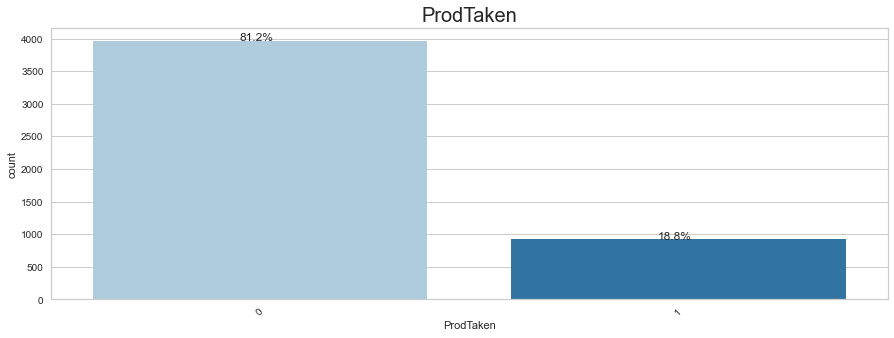

In [174]:
perc_on_bar("ProdTaken")

### Observations
- This is an imbalanced tree. In order maintaint the ratio even after splitting let's use stratify option while splitting the data

### Data Preparation

In [242]:
X = data.drop(['ProdTaken'], axis=1)
Y = data['ProdTaken']

X = pd.get_dummies(X)

#Splitting data in train and test sets
X_train, X_test, y_train, y_test = train_test_split(X,Y, test_size=0.30, random_state = 1, stratify=Y)

### Since we used stratify=Y, the ratio of Product taken vrs not taken will be same for both tratining and testing data

In [176]:
print("Training data.. ratio of productTaken/not taken", len(y_train[y_train== 1])/ len(y_train[y_train== 0]))
print("Testing data.. ratio of productTaken/not taken",len(y_test[y_test== 1])/ len(y_test[y_test== 0]))

Training data.. ratio of productTaken/not taken 0.23190493338134677
Testing data.. ratio of productTaken/not taken 0.23173803526448364


### Model evaluation criterion

### Model can make wrong predictions as:
1. Predicting a person takes Product and but actually he doesn't.
2. Predicting a person doesn't take Product but actually he does.

### Which case is more important? 

- Case1: If we predict a person takes Product that person and he doesn't. This will not cause any loss to the company. We can always try for the next time.

- Case2: If we predict a person doesn't take Product and he actually does. If we don't grab that opportunity and someone else take it, it is a loss for the company.

- So Case2 is more important that Case1. We should reduce False Negative (Recall)

### How to reduce this loss i.e need to reduce False Negatives?
*  We should reduce False Negatives. That means Recall score should be higher.

### Base line model using Desicion tree

In [243]:
all_metrics = {}

In [244]:
# classification with Decision Tree
dtc = tree.DecisionTreeClassifier(max_depth=8)
dtc.fit(X_train, y_train)
dtc.score(X_test, y_test)

0.8807089297886844

In [245]:
def get_metrics(model):
    scores_to_return = {}
    with sns.plotting_context('paper'):
        fig, ax = plt.subplots(figsize=(2, 2), dpi=150)
        cm_viz = classifier.ConfusionMatrix(model, percent=True)
        cm_viz.fit(X_train, y_train)
        cm_viz.score(X_test, y_test)
        cm_viz.poof()
    with sns.plotting_context('talk'):
        fig, ax = plt.subplots(figsize=(4,4), dpi=100)
        cr_viz = classifier.ClassificationReport(model, cmap=None)
        cr_viz.fit(X_train, y_train)
        scores = cr_viz.score(X_test, y_test)
        cr_viz.poof()
        scores_to_return = cr_viz.scores_
    with sns.plotting_context('talk'):
        fig, ax = plt.subplots(figsize=(10, 10), dpi=150)
        fi_viz = features.FeatureImportances(model)
        fi_viz.fit(X_train, y_train)
        fi_viz.score(X_test, y_test)
        fi_viz.poof()
    return scores_to_return

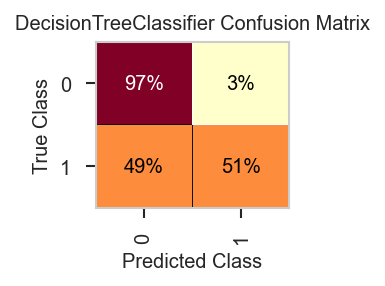

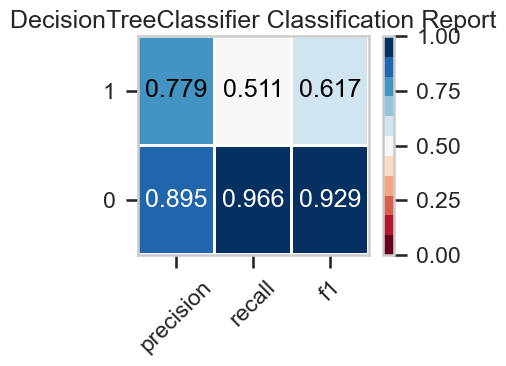

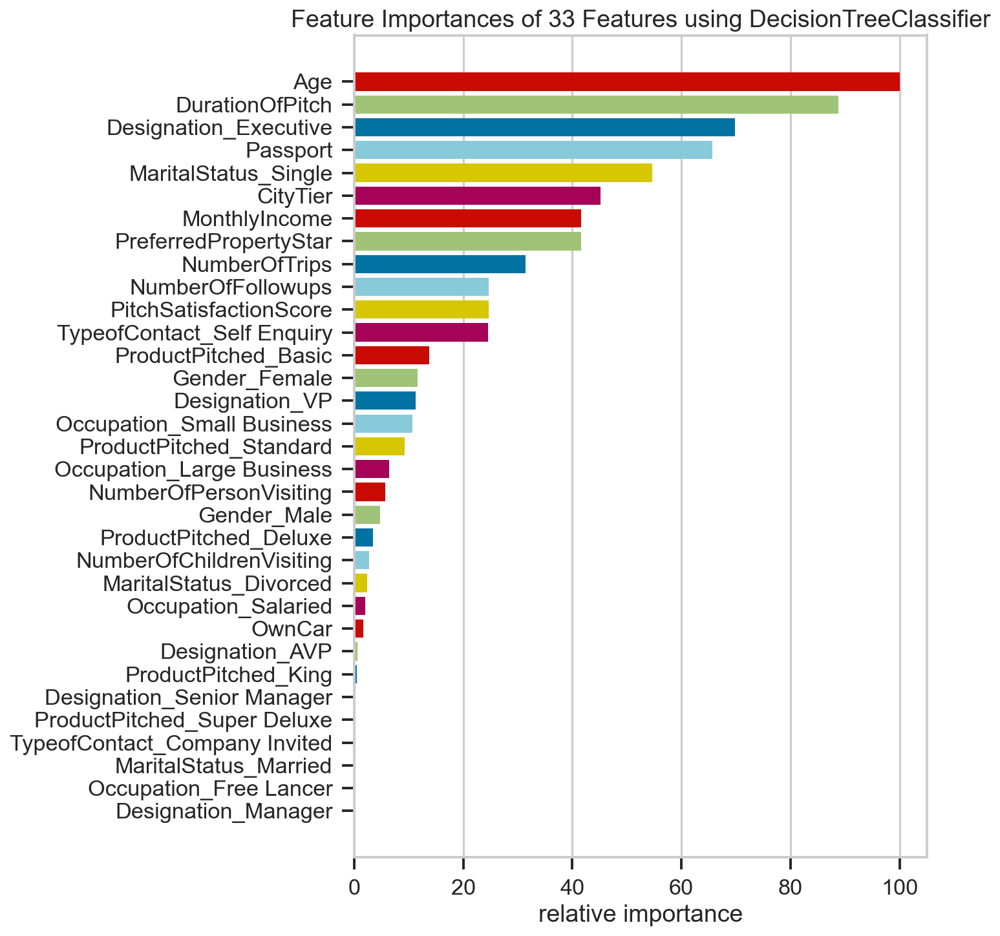

In [246]:
all_metrics["DecisionTreeClassifier"] = get_metrics(dtc)


### Observations
From confusion matrix
- Model detects 98% of the people who won't pick package accurately
- But the percentage of total False negatives is 49%. We should reduce these numbers.

From classification report
- Recall score for ProductTaken=1 is only 51%. That means the model detected 51% people as non buyers, but they actually bought the package. This will affect our business more.
- However the model is very good at predicting customers who won't buy package.

Top 5 features of importance
- Age, DurationOfPitch, customers with 'Executive' as Designation, Passport and MonthlyIncome 

In [181]:
def plot_decision_tree(model, features):
    plt.figure(figsize=(20,30))

    out = tree.plot_tree(model,feature_names=features,
                         filled=True,fontsize=9,node_ids=True,class_names=True)
    for o in out:
         arrow = o.arrow_patch
         if arrow is not None:
            arrow.set_edgecolor('black')
            arrow.set_linewidth(1)
    plt.show()

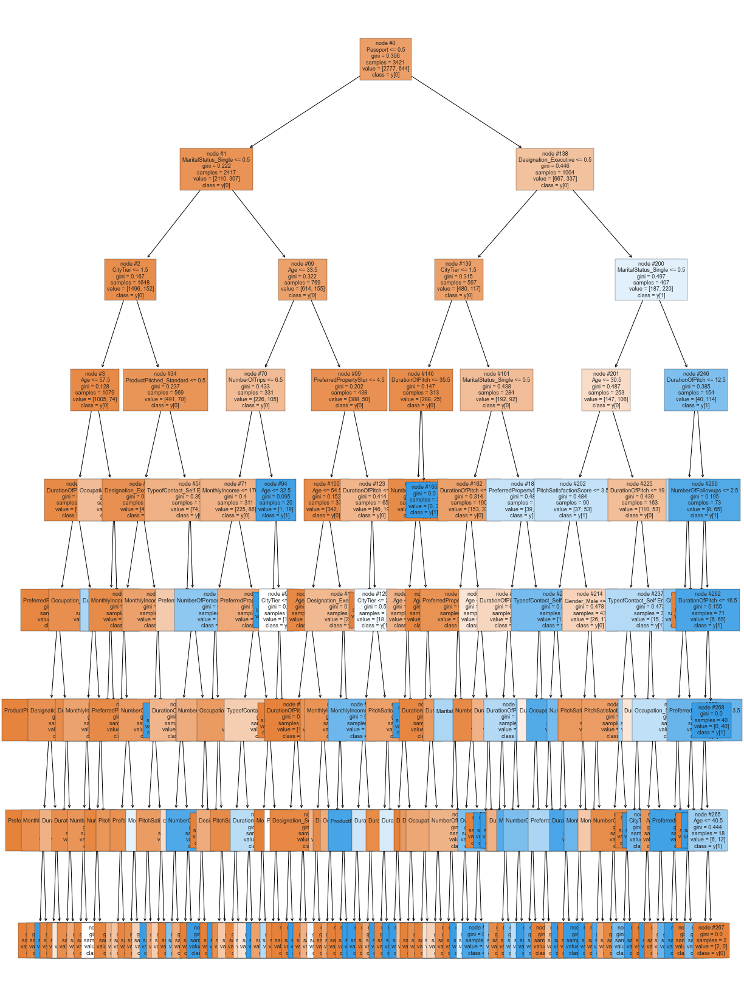

In [182]:
plot_decision_tree(dtc, X_train.columns)

### Random Forest Classifier

In [247]:
#Train the random forest classifier
rfc=RandomForestClassifier(random_state=1)
rfc.fit(X_train,y_train)

RandomForestClassifier(random_state=1)

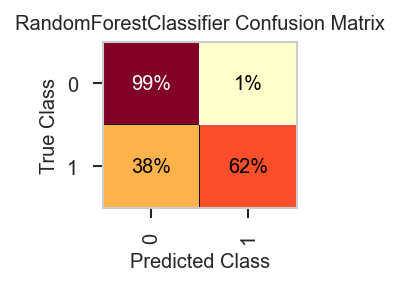

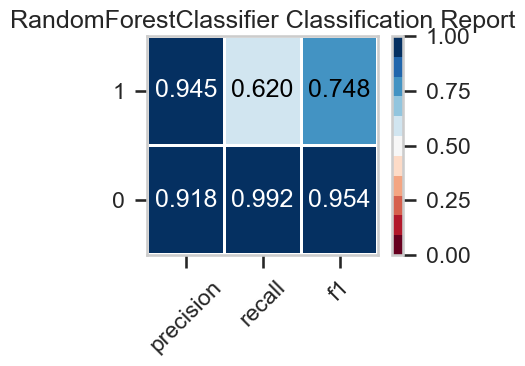

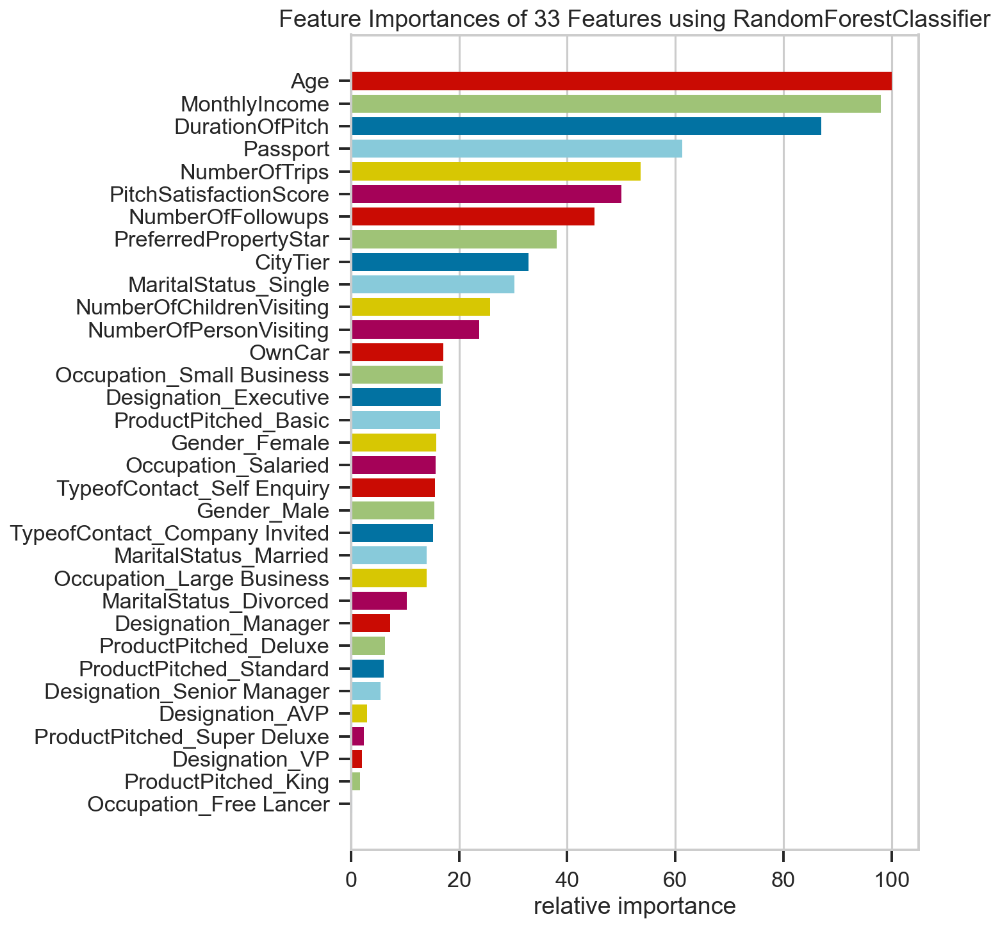

In [248]:
all_metrics["RandomForestClassifier"] = get_metrics(rfc)

### Observations
From confusion matrix
- Overall False negatives are 38% which is less compared to pruned Decision Tree. Let's see if we can reduce this percentage even further.
- True positives are 62% which is not ok.

From classification report
- Recall score for customers who took the product is 62%. This needs improvement
- Recall score for customers who did not take the product is 99%. 

Top 5 features of importane are
- Age, MonthlyIncome, DurationOfPitch, passport and NumberOfTrips

### XGB Classifier

#### Gradient Boosting	Ensemble of Trees, Later Trees make up for Error
	Regularization
	Parallel Processing
	Missing Number Support

In [249]:
xgb = xgboost.XGBClassifier(random_state=1, eval_metric='logloss')
xgb.fit(X_train, y_train)
xgb.score(X_test, y_test)

0.9304703476482618

### observations
- Without hyper parameter tuning xgboost gives accuracy of 93%

In [250]:
xgb

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=4,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)

### print xgboost tree 0

In [188]:
print(xgb.get_booster().get_dump()[0])

0:[Passport<1] yes=1,no=2,missing=1
	1:[Age<21.5] yes=3,no=4,missing=3
		3:[Occupation_Large Business<1] yes=7,no=8,missing=7
			7:[PitchSatisfactionScore<4] yes=15,no=16,missing=15
				15:[Age<20.5] yes=29,no=30,missing=29
					29:leaf=-0.480000019
					30:leaf=-0.0545454584
				16:[Age<20.5] yes=31,no=32,missing=31
					31:[Gender_Male<1] yes=57,no=58,missing=57
						57:leaf=-0.120000005
						58:leaf=0.41538465
					32:[NumberOfPersonVisiting<3] yes=59,no=60,missing=59
						59:leaf=0.0666666701
						60:leaf=-0.24000001
			8:leaf=0.381818205
		4:[MaritalStatus_Single<1] yes=9,no=10,missing=9
			9:[ProductPitched_Standard<1] yes=17,no=18,missing=17
				17:[Occupation_Large Business<1] yes=33,no=34,missing=33
					33:[PreferredPropertyStar<4.5] yes=61,no=62,missing=61
						61:leaf=-0.533269465
						62:leaf=-0.426446289
					34:[MonthlyIncome<32655.75] yes=63,no=64,missing=63
						63:leaf=-0.403448284
						64:leaf=-0
				18:[DurationOfPitch<15.5] yes=35,no=36,missing=35
					35:[

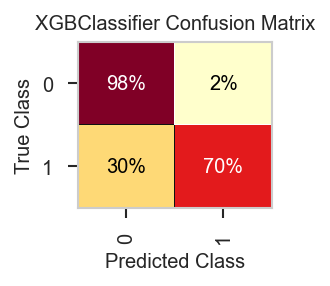

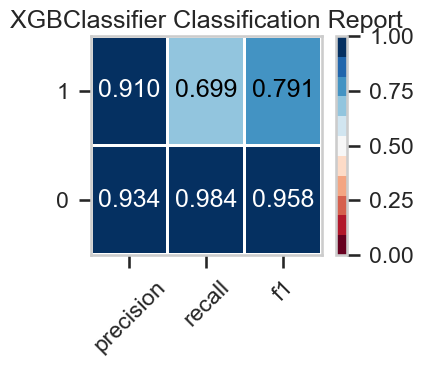

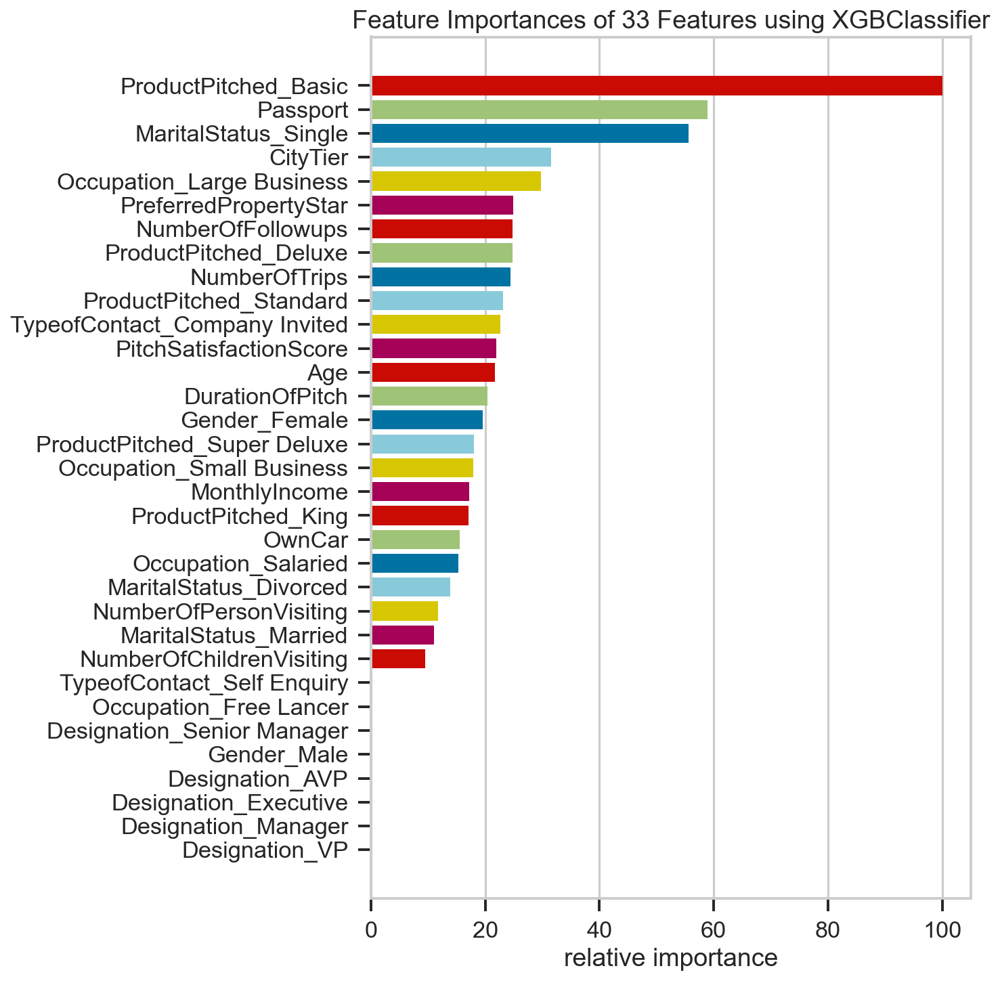

In [251]:
all_metrics["XGBoostBase"] = get_metrics(xgb)

### Observations
From confusion matrix
- Overall False negatives are 30% which is less compared to pruned Decision Tree. Let's see if we can reduce this percentage even further.
- True positives are 70% which is good improvement.

From classification report
- Recall score for customers who took the product is 70%.
- Recall score for customers who did not take the product is 98%. 

Top 5 features of importane are
- Customers with ProdcutPitched_Basic, with passport, Marital Status as Single, CityTier and Occupation as Large Business.

XGBoost hyper params:
https://xgboost.readthedocs.io/en/latest/parameter.html

Visualizes the validation curve for both test and training data for a
range of values for a single hyperparameter of the model.

### Regularization

There is a *regularized* objective function in XGBoost. This function measures the difference between $y$ and $\hat{y}$. 

The $\lambda$ term (``lambda`` or ``reg_lambda``) performs L2 regularization and  penalizes the complexity of the model. This helps to avoid *overfitting*. If the parameter is set to 0, it does normal gradient boosting.

The $\alpha$ term (``alpha`` or ``reg_alpha``) performs L1 regularization. If it is set to 0, it does normal boosting, increasing it penalizes complex models.

In addition, there is *shrinkage*. After each boost step the newly added weights are scaled by a factor, $\eta$ (``eta`` or ``learning_rate``). This makes it more conservative (ie prevent overfitting).

The is also *column subsampling*. This allows each tree to consider different columns, thus further regularizing the model. This is contrilled by ``colsample_by*`` parameters. They have a default value of 1 (use 100% of the columns) and thus use all columns by default.

In [252]:
def hyper_tuning_validation_curve(param_name, param_range):
    # This curve gives us accuracy by default
    
    with sns.plotting_context('talk'):
        fig, ax = plt.subplots(figsize=(10,6), dpi=300)
        vc_viz = ms.ValidationCurve(xgboost.XGBClassifier(random_state=1, eval_metric='logloss'), 
            n_jobs=-1, ax=ax, scoring="recall", param_name=param_name, 
            param_range=param_range)
        vc_viz.fit(X_train, y_train)
        vc_viz.poof()
        print(vc_viz.param_range[vc_viz.test_scores_mean_.argmax()])

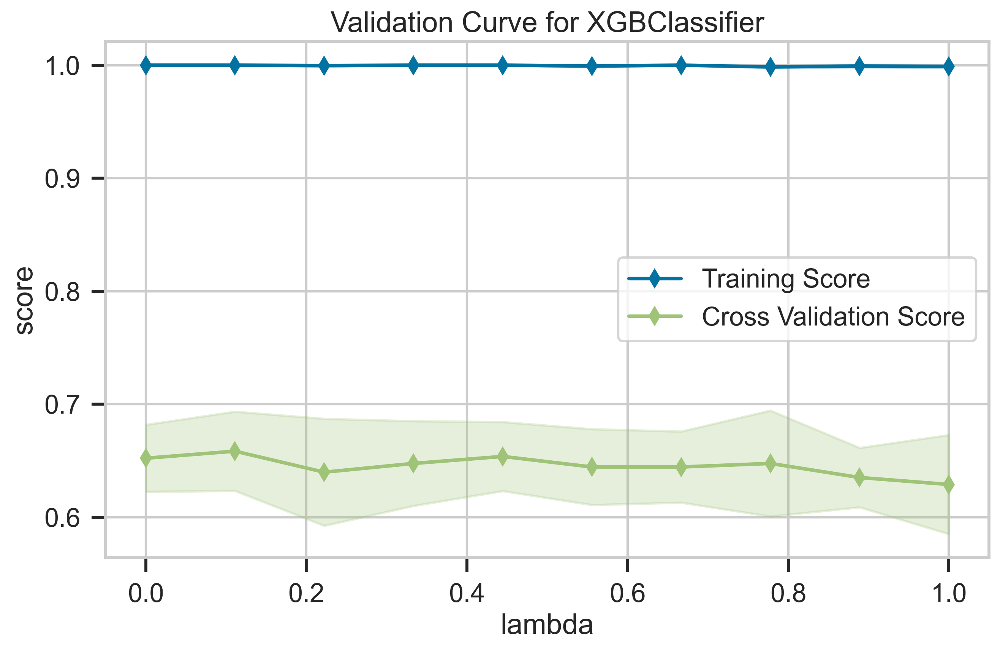

0.1111111111111111


In [253]:
### Hyper param - lambda - L2 or ridge regression - input range is 
hyper_tuning_validation_curve("lambda", np.linspace(0, 1, 10))

### Observations
- At lambda=0.11 we got better recall score

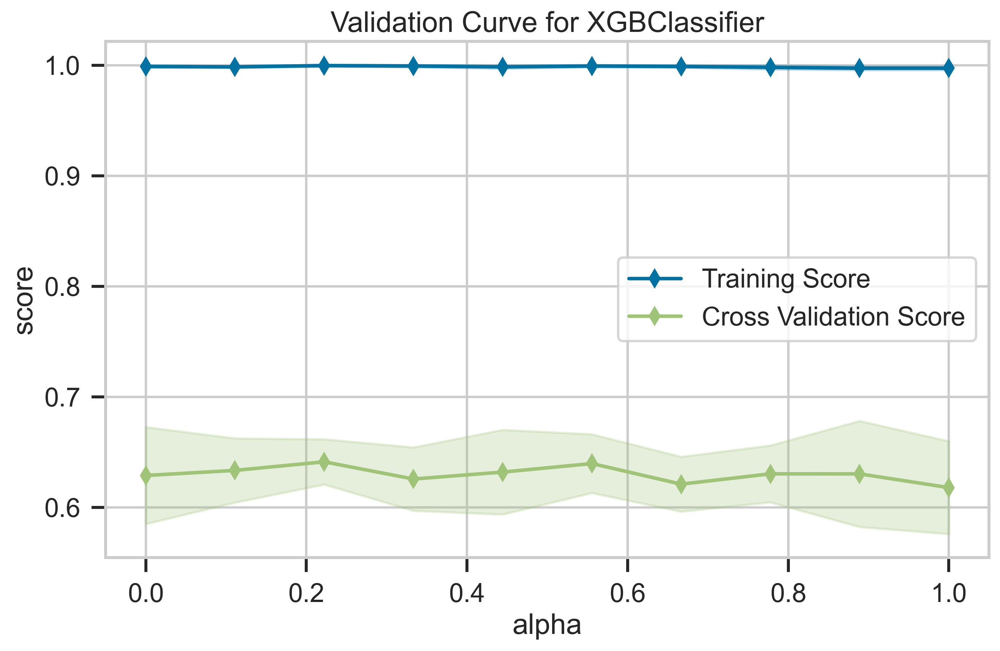

0.2222222222222222


In [254]:
### Hyper param - alpha - L1- Lasso Regression - input range is 
hyper_tuning_validation_curve("alpha", np.linspace(0, 1, 10))

In [ ]:
### Observations
- At alpha=0.22 we got better recall score

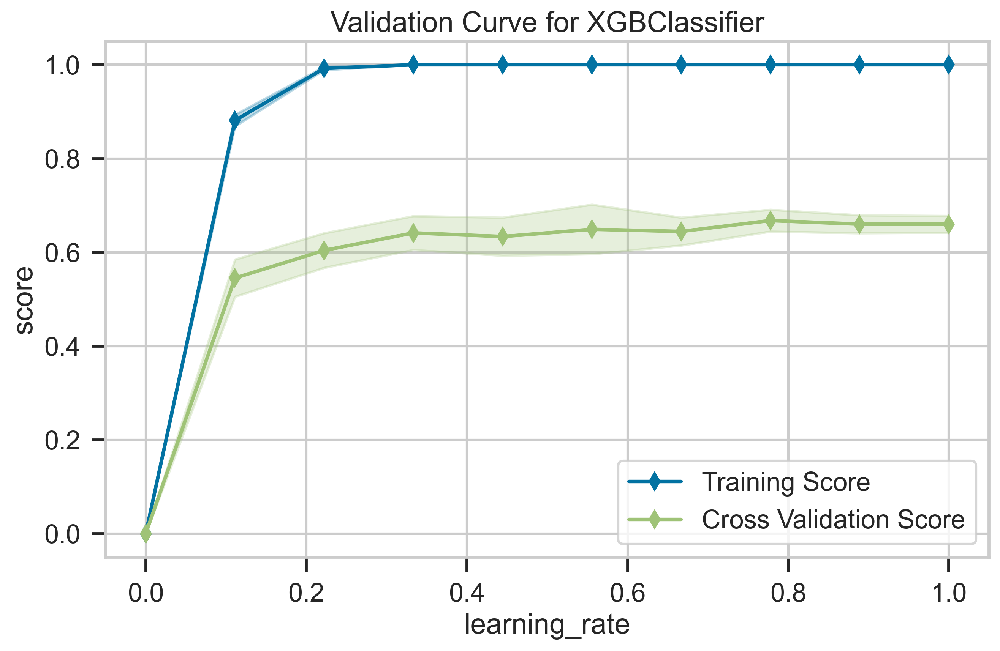

0.7777777777777777


In [255]:
### # learning rate - shrink boosting weights
hyper_tuning_validation_curve("learning_rate", np.linspace(0, 1, 10))

### Observation
- When learning_rate = 0.77 we got the better recall score

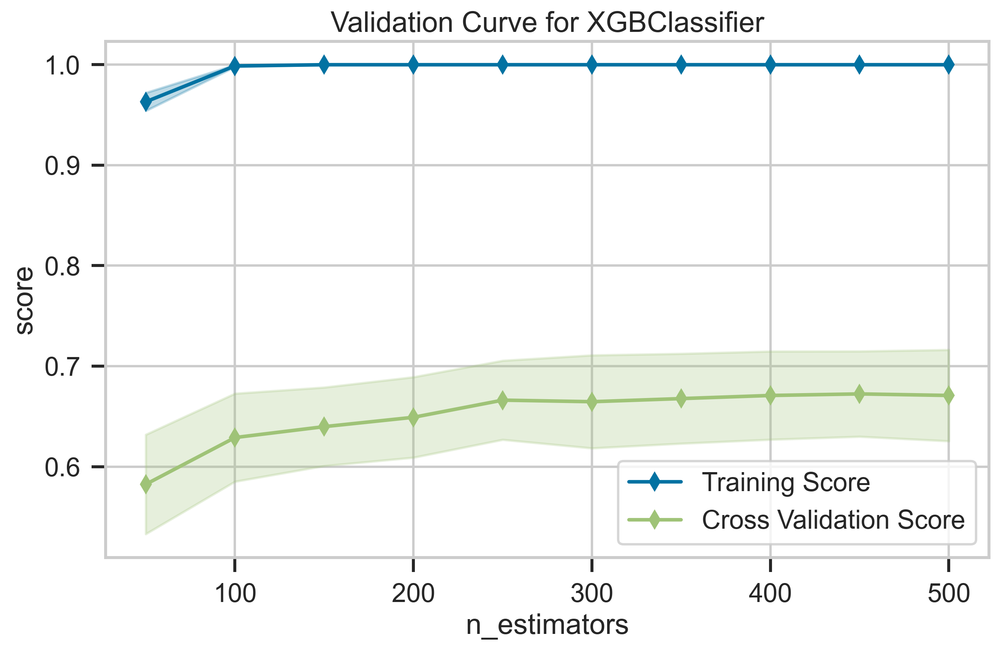

450


In [256]:
# n_estimators - the number of boosting rounds (or trees)
hyper_tuning_validation_curve("n_estimators", range(50, 501, 50))

In [257]:
xgb2 = xgboost.XGBClassifier(random_state=1, n_estimators=1000)
xgb2.fit(X_train, y_train, early_stopping_rounds=450,
        eval_set=[(X_test, y_test)])

[14:50:32] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-logloss:0.54442
[1]	validation_0-logloss:0.46366
[2]	validation_0-logloss:0.41167
[3]	validation_0-logloss:0.37883
[4]	validation_0-logloss:0.35311
[5]	validation_0-logloss:0.33606
[6]	validation_0-logloss:0.32133
[7]	validation_0-logloss:0.30827
[8]	validation_0-logloss:0.30123
[9]	validation_0-logloss:0.29301
[10]	validation_0-logloss:0.28607
[11]	validation_0-logloss:0.28099
[12]	validation_0-logloss:0.27786
[13]	validation_0-logloss:0.27450
[14]	validation_0-logloss:0.26872
[15]	validation_0-logloss:0.26775
[16]	validation_0-logloss:0.26128
[17]	validation_0-logloss:0.25595
[18]	validation_0-logloss:0.25230
[19]	validation_0-logloss:0.25091
[20]	validation_0-logloss:0.24886
[21]	validatio

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=1000, n_jobs=4, num_parallel_tree=1, random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [259]:
xgb2.best_iteration, xgb2.best_score

(179, 0.185501)

### observations
- When n_estimators=180 or number of trees=180, we got a best logloss value of 0.18
- best scrore was when n_estimators=450

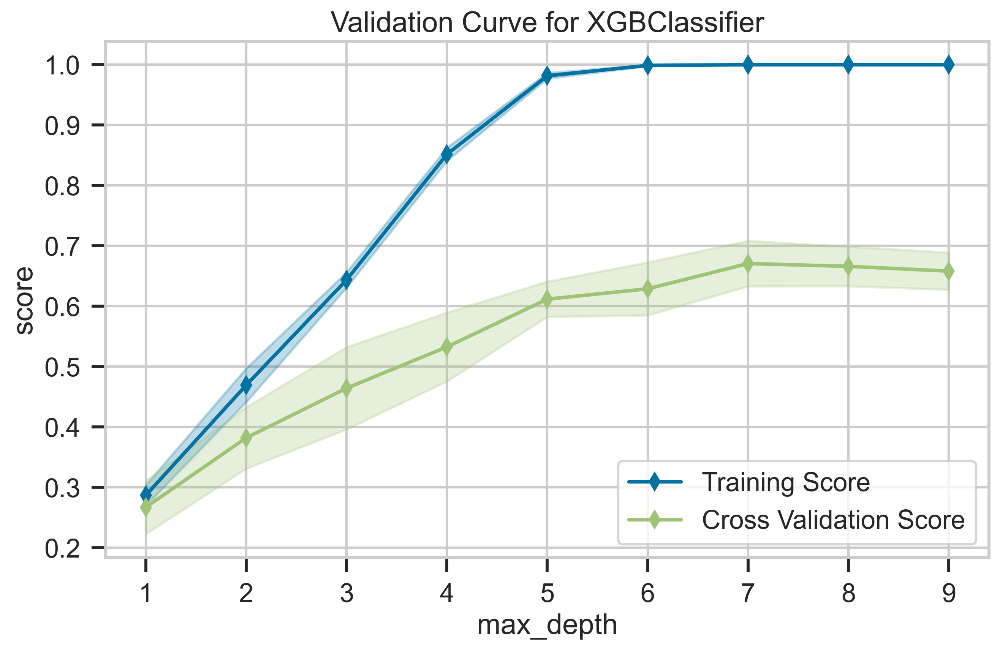

7


In [260]:
# max_depth - how deep the trees are
# deeper trees allow for more interactions (and complexity)
hyper_tuning_validation_curve("max_depth", range(1, 10))

### Observations
- After max_depth of 7, we saw decrease in score.

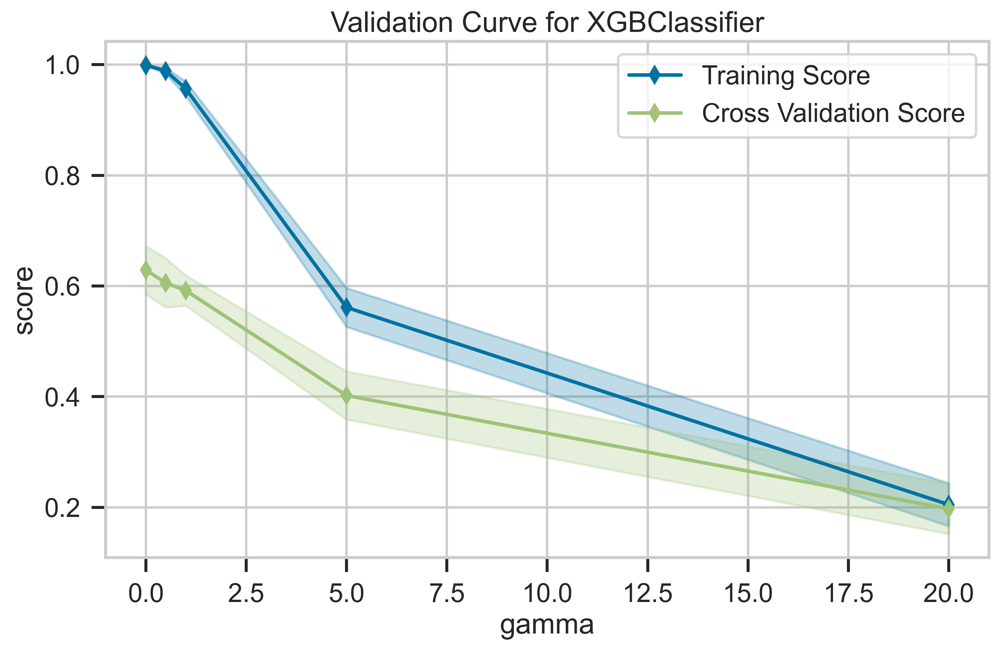

0.0


In [261]:
# gamma - Controls pruning. Range is [0, infinity]
# Minimum loss reduction required for spliting a leaf
# Higher the value, the higher the regularization (typically correlates w/ max_depth)
hyper_tuning_validation_curve("gamma", [0, .5, 1, 5, 20])

### Observations
- gamma =0 has a better score compared to others

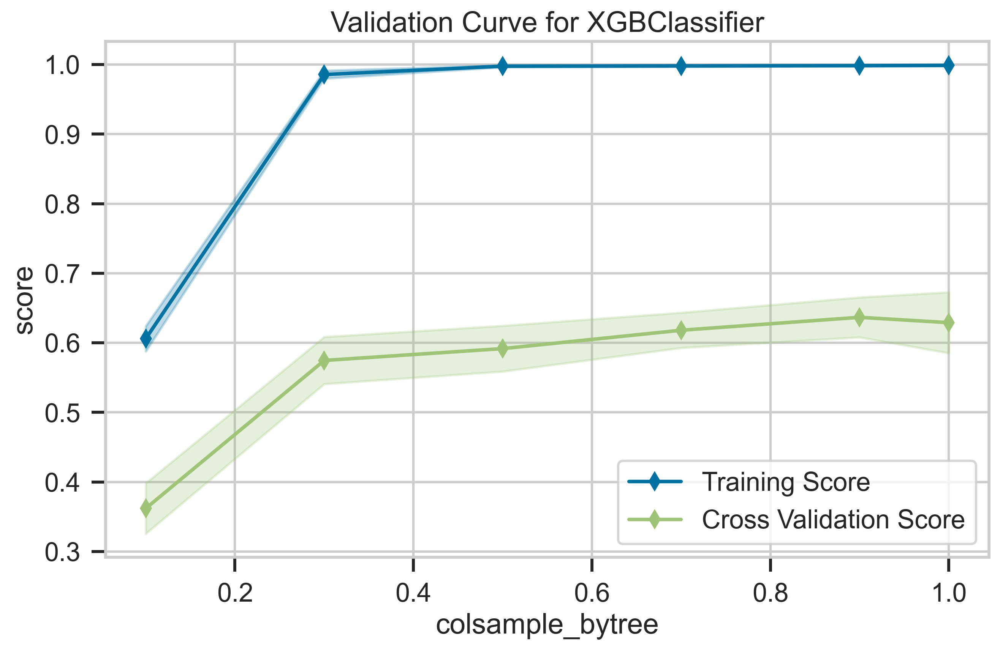

0.9


In [262]:
# Column sampling - percent of columns to use in...
# - colsample_bytree - for boosting round
# - colsample_bylevel - for tree level
# - colsample_bynode - for node
hyper_tuning_validation_curve("colsample_bytree", [.1, .3, .5, .7, .9, 1])

### Observations
- We got best score when colsample_bytree =0.9

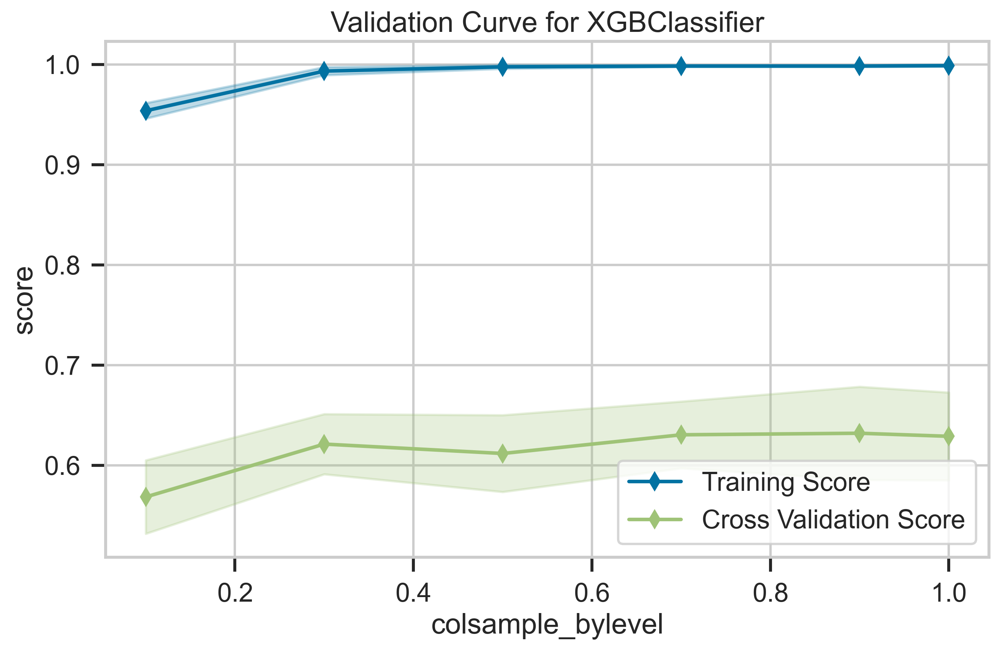

0.9


In [263]:
# Column sampling - percent of columns to use in...
# - colsample_bytree - for boosting round
# - colsample_bylevel - for tree level
# - colsample_bynode - for node
hyper_tuning_validation_curve("colsample_bylevel", [.1, .3, .5, .7, .9, 1])

### Observations
- We got best score when colsample_bylevel =0.9

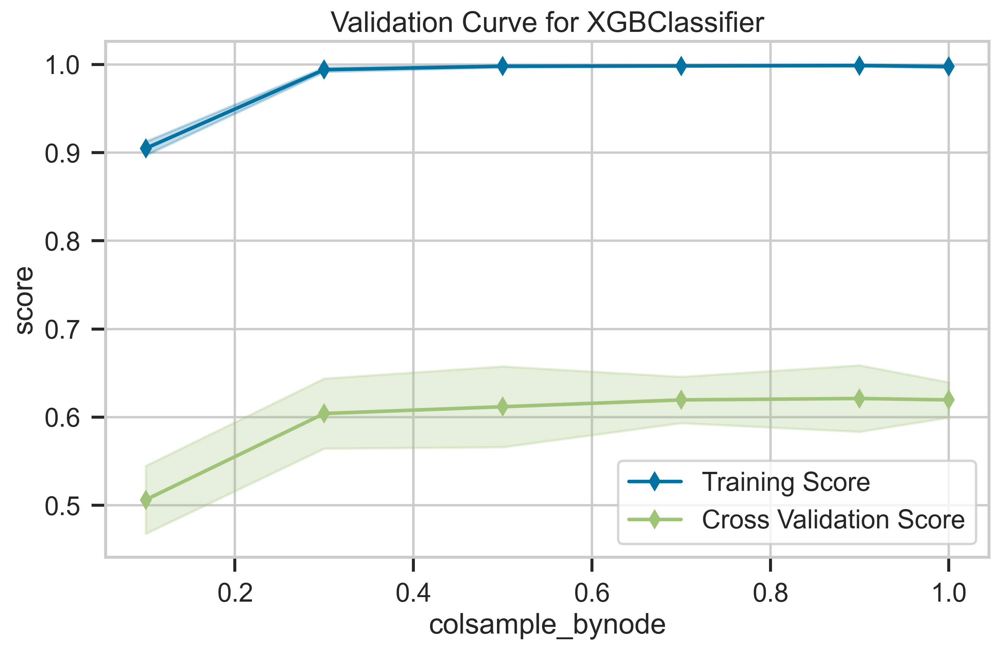

0.9


In [54]:
# Column sampling - percent of columns to use in...
# - colsample_bytree - for boosting round
# - colsample_bylevel - for tree level
# - colsample_bynode - for node
hyper_tuning_validation_curve("colsample_bynode", [.1, .3, .5, .7, .9, 1])

### Observations
- We got best score when colsample_bynode =0.9

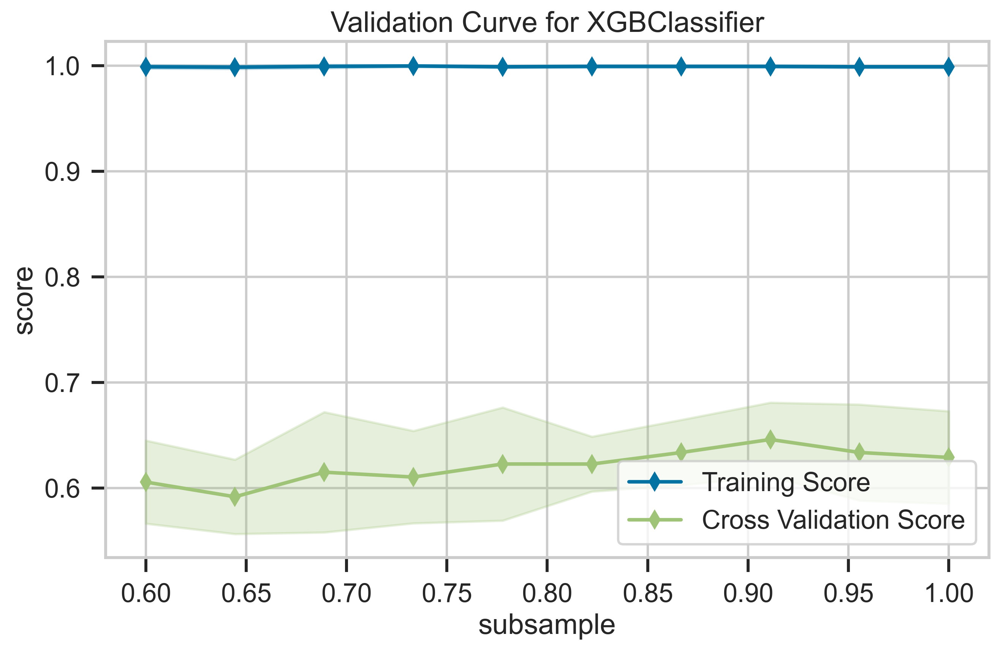

0.9111111111111111


In [264]:
# subsample - percent of samples (not features) to use for each round
hyper_tuning_validation_curve("subsample",np.linspace(0.6, 1,10))

### Observations
- We got best score when colsample_bynode =0.91

### Default XGBoost params were
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=4,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)

- reg_alpha=0, 
- reg_lambda=1,
- learning_rate=0.300000012
- gamma=0
- n_estimators=100
- max_depth=6
- n_jobs=4
- random_state=1
- colsample_bylevel=1,
- colsample_bynode=1, 
- colsample_bytree=1,
- subsample=1,

### GridSearch hyper param tuning

In [265]:
%%time
# if learning rate (default .1) goes down, may need more boosting rounds to fit
# note n_estimators is dependent on other params and should be tuned after or use early_stopping_rounds on .fit
params = {'reg_lambda': [.11],  
          'reg_alpha': [.22],
          'learning_rate': [.77], # makes each boost more conservative (0 - no shrinkage) 
          'gamma': [0],
          'n_estimators': [180, 450 ],
          'max_depth': [7],
          'colsample_bylevel': [.9], # use 90% of columns in boost step
          'colsample_bytree': [.9], 
          'colsample_bynode': [.9],
          'subsample': [.91],
          'random_state': [1],
          'n_jobs': [4]          
          
          }
xgb_hyper_params = xgboost.XGBClassifier(eval_metric='logloss')
cv = GridSearchCV(xgb_hyper_params,
      params).fit(X_train, y_train, eval_set=[(X_test, y_test)] ) 

[0]	validation_0-logloss:0.40340
[1]	validation_0-logloss:0.34546
[2]	validation_0-logloss:0.32681
[3]	validation_0-logloss:0.31044
[4]	validation_0-logloss:0.29913
[5]	validation_0-logloss:0.29679
[6]	validation_0-logloss:0.30122
[7]	validation_0-logloss:0.29822
[8]	validation_0-logloss:0.29867
[9]	validation_0-logloss:0.28974
[10]	validation_0-logloss:0.28759
[11]	validation_0-logloss:0.28948
[12]	validation_0-logloss:0.28365
[13]	validation_0-logloss:0.28346
[14]	validation_0-logloss:0.28207
[15]	validation_0-logloss:0.28525
[16]	validation_0-logloss:0.28487
[17]	validation_0-logloss:0.27762
[18]	validation_0-logloss:0.28367
[19]	validation_0-logloss:0.28232
[20]	validation_0-logloss:0.28332
[21]	validation_0-logloss:0.28201
[22]	validation_0-logloss:0.27842
[23]	validation_0-logloss:0.28296
[24]	validation_0-logloss:0.28191
[25]	validation_0-logloss:0.28614
[26]	validation_0-logloss:0.28798
[27]	validation_0-logloss:0.28493
[28]	validation_0-logloss:0.28796
[29]	validation_0-loglos

In [266]:
cv.best_params_

{'colsample_bylevel': 0.9,
 'colsample_bynode': 0.9,
 'colsample_bytree': 0.9,
 'gamma': 0,
 'learning_rate': 0.77,
 'max_depth': 7,
 'n_estimators': 450,
 'n_jobs': 4,
 'random_state': 1,
 'reg_alpha': 0.22,
 'reg_lambda': 0.11,
 'subsample': 0.91}

In [267]:
# score xgboost with hyperparams
xgb_grid = xgboost.XGBClassifier(**cv.best_params_, eval_metric='logloss')
xgb_grid.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=0.9,
              colsample_bynode=0.9, colsample_bytree=0.9, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.77, max_delta_step=0,
              max_depth=7, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=450, n_jobs=4,
              num_parallel_tree=1, random_state=1, reg_alpha=0.22,
              reg_lambda=0.11, scale_pos_weight=1, subsample=0.91,
              tree_method='exact', validate_parameters=1, verbosity=None)

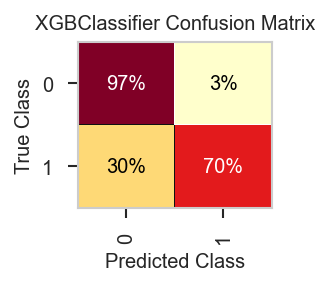

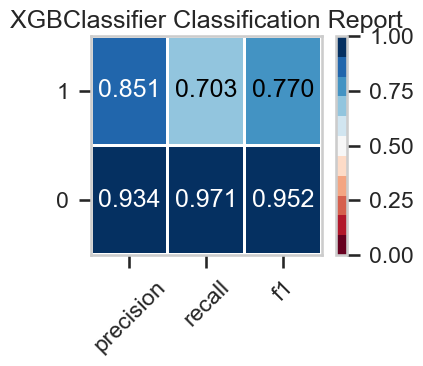

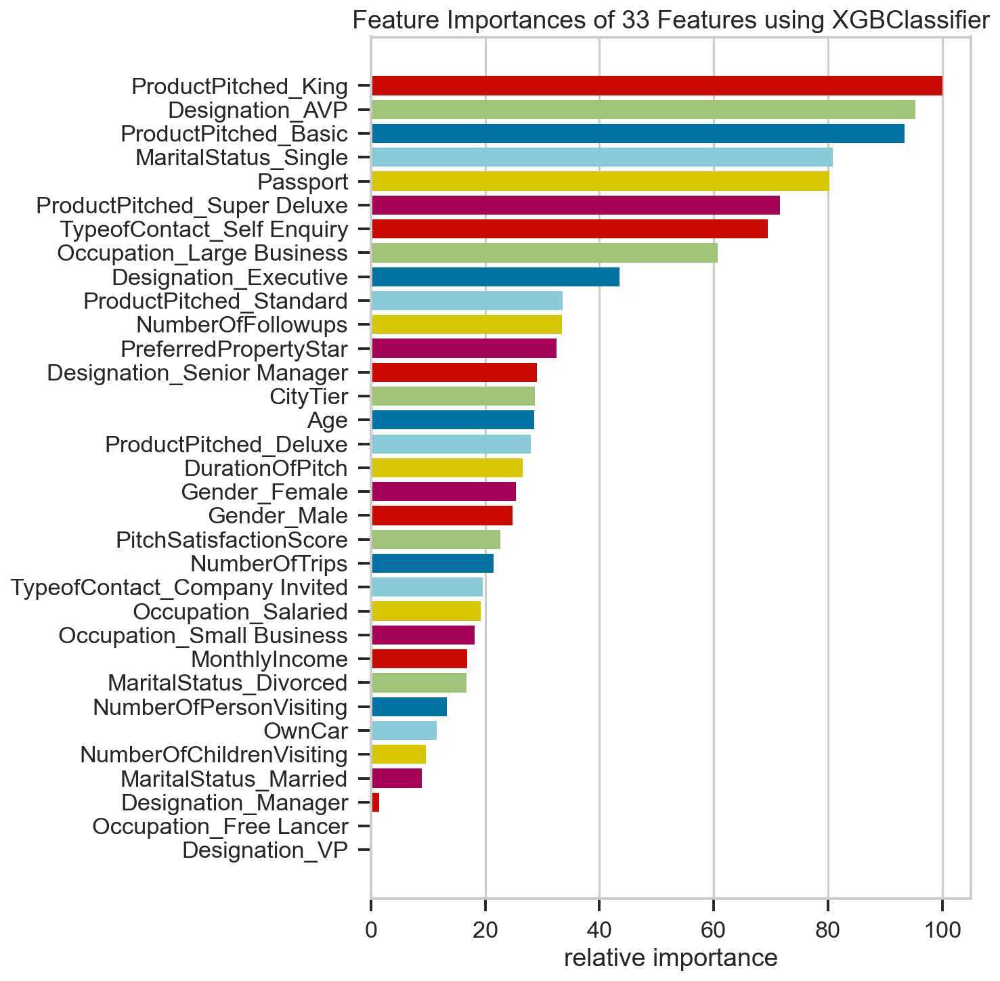

In [268]:
all_metrics["XGBoostGridSearch"] = get_metrics(xgb_grid)

### Observations from Default XG boost
From confusion matrix
- Overall False negatives are 30% which is less compared to pruned Decision Tree. Let's see if we can reduce this percentage even further.
- True positives are 70% which is good improvement.

From classification report
- Recall score for customers who took the product is 70%.
- Recall score for customers who did not take the product is 98%. 

Top 5 features of importane are
- Customers with ProdcutPitched_Basic, with passport, Marital Status as Single, CityTier and Occupation as Large Business.

### Observations from hyper parameter tuned XB Boost
From confusion matrix
- Overall False negatives are 30% which is only 1% more than the default XG boost model.
- True positives are 70% which is 1% less than default XG boost model.

From classification report
- Recall score for customers who took the product is 70% which is 1% less than the default XG boost model.
- Recall score for customers who did not take the product is 98% which is almost same as default XG boost model.

Top 5 features of importane are
- Customers with ProdcutPitched_King, Designation_AVP, ProductPitched_Basic, MaritalStatus_Single and passport. These are different than default XG Boost Model.

Conclusion:
- Since there is not difference in scores, I will use default XG Boost algorithm itself for my predictions.

### AUC

In [269]:
metrics.roc_auc_score(y_test, xgb.predict(X_test))

0.8416611908151719

In [270]:
metrics.roc_auc_score(y_train, xgb.predict(X_train))

0.9984472049689441

### Observations
- Area under curve is 84% for xgboost model.

### Plot roc for decision tree, random forest and xgboost classifiers

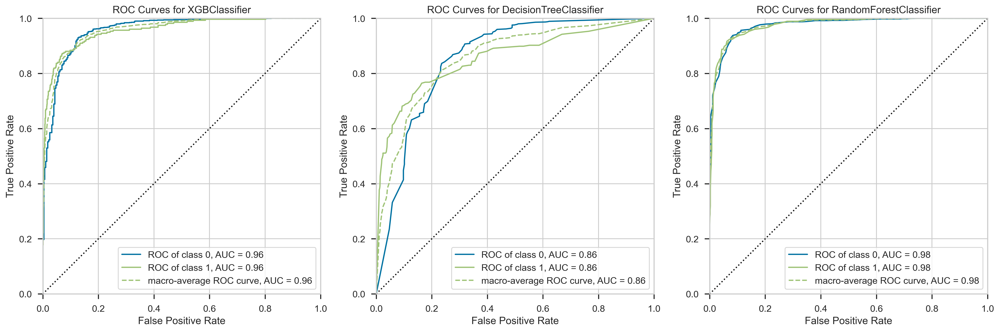

In [272]:

with sns.plotting_context('notebook'):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20,6), dpi=300)
    # xgboost
    xgb_viz = classifier.ROCAUC(xgb, ax=ax1, micro=False)
    xgb_viz.fit(X_train, y_train)
    xgb_viz.score(X_test, y_test)
    xgb_viz.finalize()
   
    # decision tree
    dtc_viz = classifier.ROCAUC(dtc, ax=ax2, micro=False)
    dtc_viz.fit(X_train, y_train)
    dtc_viz.score(X_test, y_test)
    dtc_viz.finalize()
    
    # random forest
    rfc_viz = classifier.ROCAUC(rfc, ax=ax3, micro=False)
    rfc_viz.fit(X_train, y_train)
    rfc_viz.score(X_test, y_test)
    rfc_viz.finalize()
        

In [274]:
print(f"xgboost:{xgb_viz.score_}, decision tree: {dtc_viz.score_}, random forest:{rfc_viz.score_}")

xgboost:0.9582128497662245, decision tree: 0.8556355393091502, random forest:0.9754428826696825


### Observations
- AUC for XGBoost and RandomForest are almost equal. Here random forest does better than xgboost.

### Class Prediction Error 
Class Prediction Error chart that shows the support for each class in the
fitted classification model displayed as a stacked bar. Each bar is segmented
to show the distribution of predicted classes for each class. It is initialized
with a fitted model and generates a class prediction error chart on draw.

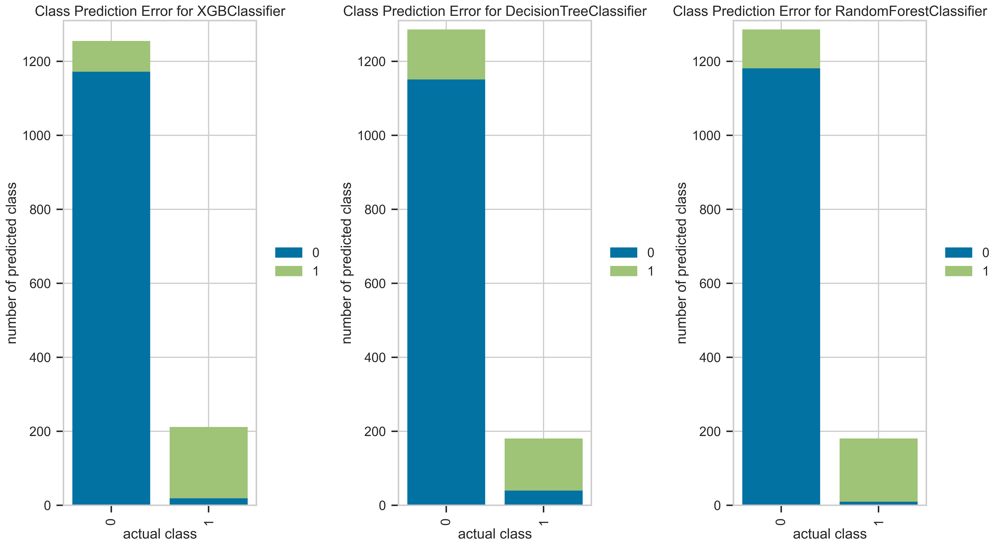

In [347]:
with sns.plotting_context('talk'):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20,10), dpi=300)
    cm_viz = classifier.ClassPredictionError(xgb, ax=ax1)
    cm_viz.score(X_test, y_test)
    cm_viz.finalize()
    
    dtc_viz = classifier.ClassPredictionError(dtc, ax=ax2)
    dtc_viz.score(X_test, y_test)
    dtc_viz.finalize()
    
    rfc_viz = classifier.ClassPredictionError(rfc, ax=ax3)
    rfc_viz.score(X_test, y_test)
    rfc_viz.finalize()

In [276]:
print(f"xgboost:{cm_viz.score_}, decision tree: {dtc_viz.score_}, random forest:{rfc_viz.score_}")

xgboost:0.9304703476482618, decision tree: 0.8807089297886844, random forest:0.9216087252897068


### Observations
Overall XGboost performs better than Random forest.

### Precision Recall Curve
Precision-Recall curves are a metric used to evaluate a classifier's quality,
particularly when classes are very imbalanced. The precision-recall curve
shows the tradeoff between precision, a measure of result relevancy, and
recall, a measure of completeness. For each class, precision is defined as
the ratio of true positives to the sum of true and false positives, and
recall is the ratio of true positives to the sum of true positives and false
negatives.


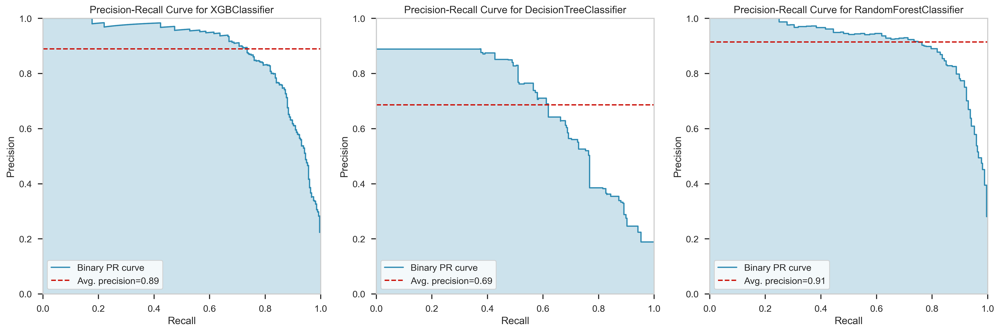

In [277]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20,6), dpi=300)
    cm_viz = classifier.PRCurve(xgb, ax=ax1)
    cm_viz.fit(X_train, y_train)
    cm_viz.score(X_test, y_test)
    cm_viz.finalize()
    
    dtc_viz = classifier.PRCurve(dtc, ax=ax2)
    dtc_viz.fit(X_train, y_train)
    dtc_viz.score(X_test, y_test)
    dtc_viz.finalize()
    
    rfc_viz = classifier.PRCurve(rfc, ax=ax3)
    rfc_viz.fit(X_train, y_train)
    rfc_viz.score(X_test, y_test)
    rfc_viz.finalize()

### Observations
Avg Presion is slightly higher for Random Forest Calssifier than xg_boost. 

### Discrimination Threshold
discrimination threshold. It displays how precision, recall, f1 score, and queue rate change as we change the threshold at which we decide class prediction. The output of the machine learning model for classification problems is generally probability and we decide class based on some threshold on probability. The sklearn has put the threshold generally at 0.5 which means that if the probability is greater than 0.5 then we take the class as positive class else negative class.

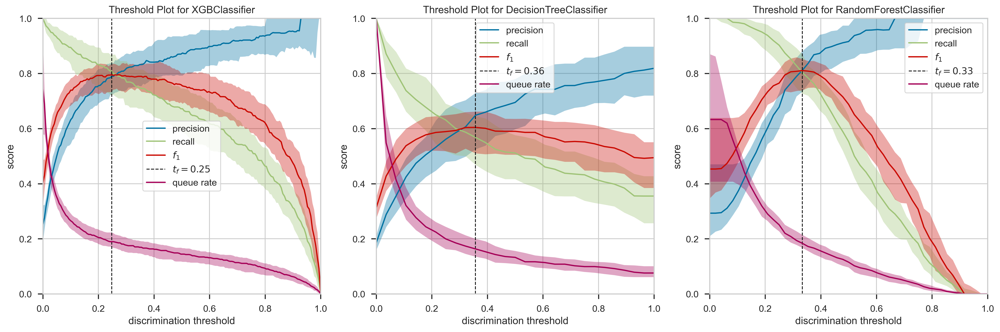

In [278]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20,6), dpi=300)
    cm_viz = classifier.DiscriminationThreshold(xgb, ax=ax1)
    cm_viz.fit(X_train, y_train)
    cm_viz.score(X_test, y_test)
    cm_viz.finalize()
    
    dtc_viz = classifier.DiscriminationThreshold(dtc, ax=ax2)
    dtc_viz.fit(X_train, y_train)
    dtc_viz.score(X_test, y_test)
    dtc_viz.finalize()
    
    rfc_viz = classifier.DiscriminationThreshold(rfc, ax=ax3)
    rfc_viz.fit(X_train, y_train)
    rfc_viz.score(X_test, y_test)
    rfc_viz.finalize()

### Observations
optimal threshold values are
- xgboost - 0.25
- decision tree - 0.36
- random forest - 0.33

In [279]:
# calculate predicted probabilities for dependent variable using all models
y_train_xgb =  (xgb.predict_proba(X_train)[:,1]>=0.25)
y_test_xgb = (xgb.predict_proba(X_test)[:,1]>=0.25)

y_train_dtc =  (dtc.predict_proba(X_train)[:,1]>=0.36)
y_test_dtc = (dtc.predict_proba(X_test)[:,1]>=0.36)

y_train_rfc =  (rfc.predict_proba(X_train)[:,1]>=0.33)
y_test_rfc = (rfc.predict_proba(X_test)[:,1]>=0.33)

### Confusion Matrix with optimal threshold

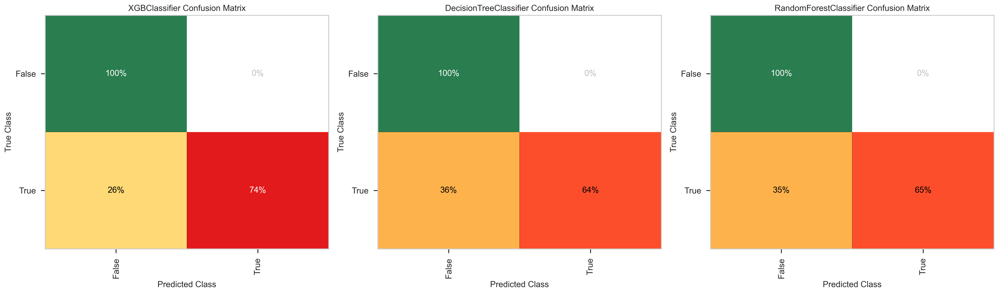

In [280]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20,6), dpi=300)
    cm_viz = classifier.ConfusionMatrix(xgb, ax=ax1, percent=True)
    cm_viz.fit(X_train, y_train_xgb)
    cm_viz.score(X_test, y_test_xgb)
    cm_viz.finalize()
    
    dtc_viz = classifier.ConfusionMatrix(dtc, ax=ax2, percent=True)
    dtc_viz.fit(X_train, y_train_dtc)
    dtc_viz.score(X_test, y_test_dtc)
    dtc_viz.finalize()
    
    rfc_viz = classifier.ConfusionMatrix(rfc, ax=ax3, percent=True)
    rfc_viz.fit(X_train, y_train_rfc)
    rfc_viz.score(X_test, y_test_rfc)
    rfc_viz.finalize()

### Observations
- xgboost classifier outperformed all the models and with optimal threshold of 0.25, the percentage of flase postives reduced from 30% to 26%.

### Classification Report with optimal threshold

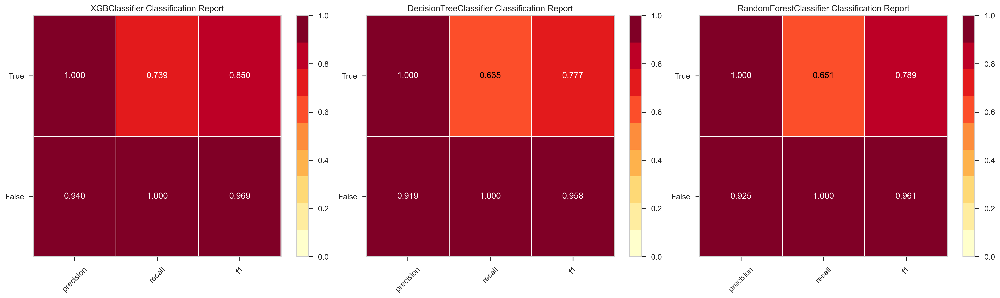

In [281]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20,6), dpi=300)
    cm_viz = classifier.ClassificationReport(xgb, ax=ax1, percent=True)
    cm_viz.fit(X_train, y_train_xgb)
    cm_viz.score(X_test, y_test_xgb)
    cm_viz.finalize()
    
    dtc_viz = classifier.ClassificationReport(dtc, ax=ax2, percent=True)
    dtc_viz.fit(X_train, y_train_dtc)
    dtc_viz.score(X_test, y_test_dtc)
    dtc_viz.finalize()
    
    rfc_viz = classifier.ClassificationReport(rfc, ax=ax3, percent=True)
    rfc_viz.fit(X_train, y_train_rfc)
    rfc_viz.score(X_test, y_test_rfc)
    rfc_viz.finalize()
    
    all_metrics["XGBoostOptimalThresholdOf0.23"] = cm_viz.scores_
    all_metrics["DecisionTreeOptimalThresholdOf0.35"] = dtc_viz.scores_
    all_metrics["RandomForestOptimalThresholdOf0.29"] = rfc_viz.scores_

### Observations
- In terms of Recall score XGBoost is 73% and it outperformed other models.

In [ ]:
### Observations
- There are 83 records that are misclassified as Falso Negatives. Out of which 80 of them ProductPitched_Basic, 

### Feature Importance with Optimal Threshold

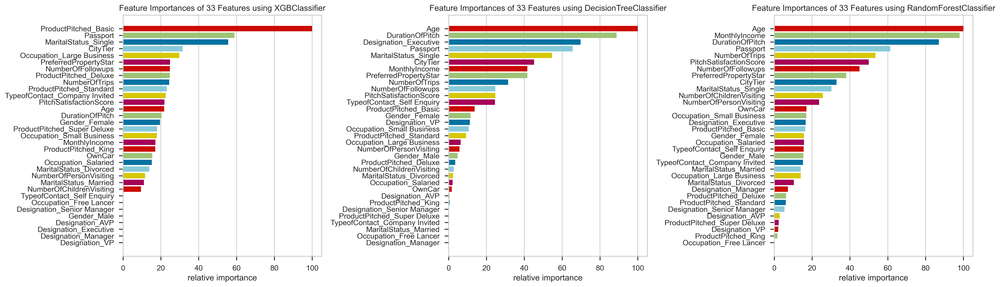

In [282]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20,6), dpi=300)
    cm_viz = features.FeatureImportances(xgb, ax=ax1, percent=True)
    cm_viz.fit(X_train, y_train_xgb)
    cm_viz.score(X_test, y_test_xgb)
    cm_viz.finalize()
    
    dtc_viz = features.FeatureImportances(dtc, ax=ax2, percent=True)
    dtc_viz.fit(X_train, y_train_dtc)
    dtc_viz.score(X_test, y_test_dtc)
    dtc_viz.finalize()
    
    rfc_viz = features.FeatureImportances(rfc, ax=ax3, percent=True)
    rfc_viz.fit(X_train, y_train_rfc)
    rfc_viz.score(X_test, y_test_rfc)
    rfc_viz.finalize()

In [283]:
print(f"top 5 features for optimal threshold \nxgboost: {list(cm_viz.features_[-5:])[::-1]},\ndecisionTree:{list(dtc_viz.features_[-5:])[::-1]},\nrandomForest:{list(rfc_viz.features_[-5:])[::-1]}")

top 5 features for optimal threshold 
xgboost: ['ProductPitched_Basic', 'Passport', 'MaritalStatus_Single', 'CityTier', 'Occupation_Large Business'],
decisionTree:['Age', 'DurationOfPitch', 'Designation_Executive', 'Passport', 'MaritalStatus_Single'],
randomForest:['Age', 'MonthlyIncome', 'DurationOfPitch', 'Passport', 'NumberOfTrips']


### Observations
Top 5 features for optimal threshold 
- xgboost: ['ProductPitched_Basic', 'Passport', 'MaritalStatus_Single', 'CityTier', 'Occupation_Large Business'],
- decisionTree:['Age', 'DurationOfPitch', 'Designation_Executive', 'Passport', 'MaritalStatus_Single'],
- randomForest:['Age', 'MonthlyIncome', 'DurationOfPitch', 'Passport', 'NumberOfTrips']

### Observations
- Interms of predicting the customers who took the Product, i.e., productTaken=1 xgboost outperforms other models. Based on the above output I would prefer xgboost as my togo model.

### Learning Curve: Do we have enough data? 
Based on the above metrics, I picked xgboost as my model. Even with hyper parameter tuning, I did not get better performance, I want to see if the data provided is enough for my model.

The visualizer evaluates cross-validated training and test scores for different training set sizes. These curves are plotted so that the x-axis is the training set size and the y-axis is the score.

The cross-validation generator splits the whole dataset k times, scores are averaged over all k runs for the training subset. The curve plots the mean score for the k splits, and the filled in area suggests the variability of the cross-validation by plotting one standard deviation above and below the mean for each split.

If the training and cross-validation scores converge together as more data is added, then the model will probably not benefit from more data. If the training score is much greater than the validation score then the model probably requires more training examples in order to generalize more effectively.

The curves are plotted with the mean scores, however variability during cross-validation is shown with the shaded areas that represent a standard deviation above and below the mean for all cross-validations. If the model suffers from error due to bias, then there will likely be more variability around the training score curve. If the model suffers from error due to variance, then there will be more variability around the cross validated score.

https://www.scikit-yb.org/en/latest/api/model_selection/learning_curve.html

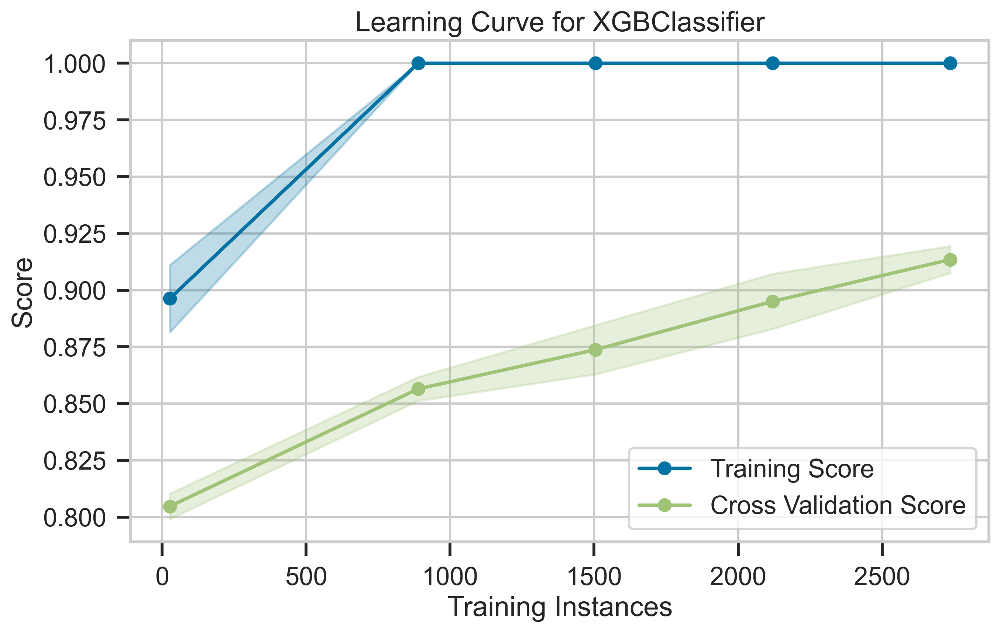

In [284]:
with sns.plotting_context('talk'):
    fig = plt.subplots(figsize=(10,6), dpi=300)
    lc_viz = ms.LearningCurve(xgb,train_sizes=[0.01  , 0.325, 0.55 , 0.775, 1.   ],)
    lc_viz.fit(X_train, y_train_xgb)
    lc_viz.show()

### Observations
- The training score is much greater than the validation score then the model probably requires more training examples in order to generalize more effectively
- Also the model suffers from error due to variance, that is why there is more variability around the cross validation score

## Interpreting Results	Predicting Results

### Feature Importance

    How the importance is calculated: either "weight", "gain", or "cover"

    * "weight" is the number of times a feature appears in a tree
    * "gain" is the average gain of splits which use the feature
    * "cover" is the average coverage of splits which use the feature, where coverage is defined as the number of samples affected by the split

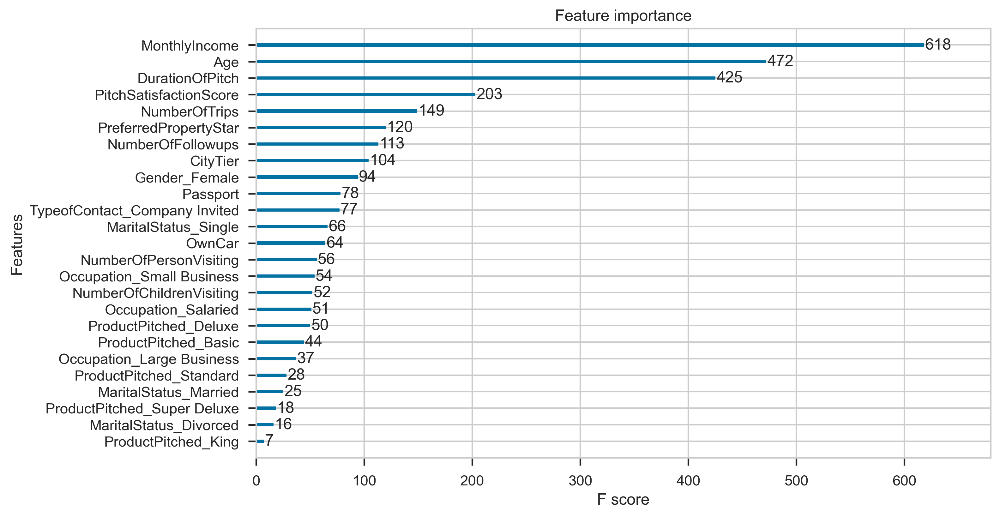

In [285]:
# importance_type - weight - # times a feature appears in a tree
with sns.plotting_context('notebook'):
    fig, ax = plt.subplots(figsize=(10,6), dpi=300)
    xgboost.plot_importance(xgb, ax=ax, importance_type='weight')

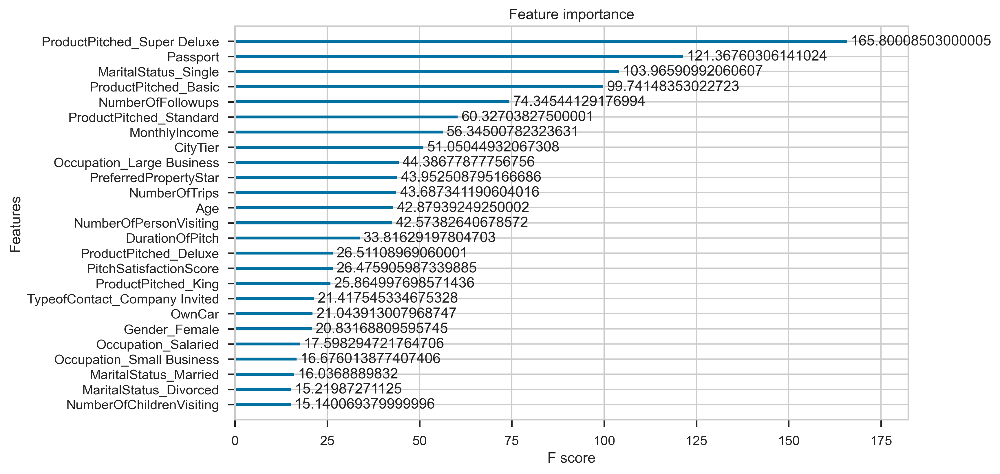

In [286]:
# importance_type - cover - weighted # of times a feature is 
# used for a split (weighted by # samples affected)
with sns.plotting_context('notebook'):
    fig, ax = plt.subplots(figsize=(10,6), dpi=300)
    xgboost.plot_importance(xgb, ax=ax, importance_type='cover')

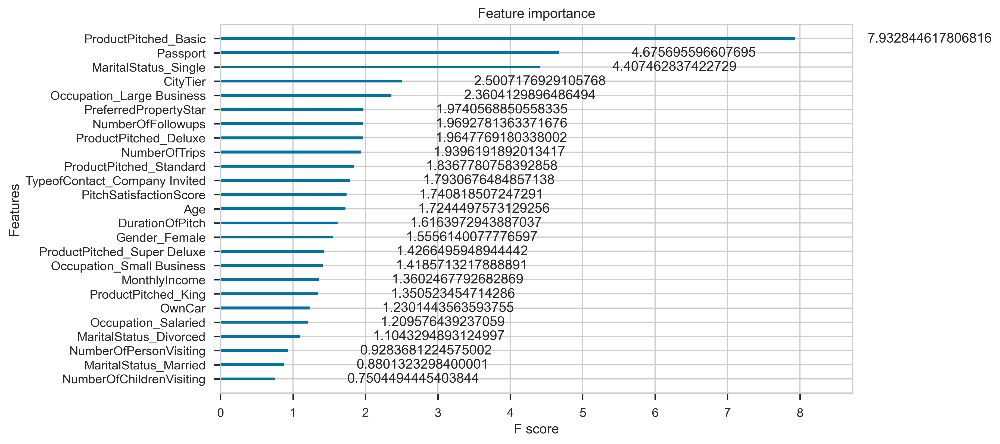

In [287]:
# importance_type - gain - average training loss reduction when
# feature used
with sns.plotting_context('notebook'):
    fig, ax = plt.subplots(figsize=(10,6), dpi=300)
    xgboost.plot_importance(xgb, ax=ax, importance_type='gain')

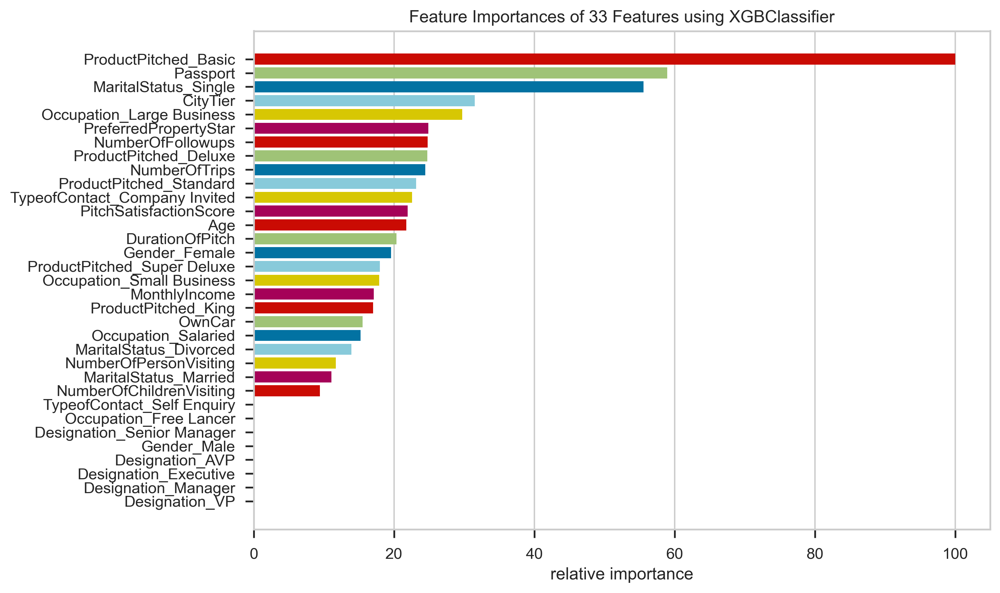

In [288]:
with sns.plotting_context('notebook'):
    fig, ax = plt.subplots(figsize=(10, 6), dpi=300)
    fi_viz = features.FeatureImportances(xgb)
    fi_viz.fit(X_train, y_train_xgb)
    fi_viz.show()

### Observations
- Feature importnace matches with feature_importance plot with importance_type = 'gain'. i.e., average training loss reduction when feature is used
- Top 5 features for optimal threshold are
 ['ProductPitched_Basic', 'Passport', 'MaritalStatus_Single', 'CityTier', 'Occupation_Large Business'],

### SHAP (SHapley Additive exPlantations)
Shoule be *globally* consistent and accurate

In [289]:
# initialize shap javascript obj
shap.initjs()

In [290]:
shap_ex = shap.TreeExplainer(xgb)
vals = shap_ex.shap_values(X_train)

In [291]:
X_train.iloc[[0, 1]]

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
3234,34.0,1,12.0,3,5.0,3.0,6.0,0,3,0,1.0,25797.0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0
657,29.0,1,13.0,3,4.0,3.0,7.0,0,5,1,0.0,17532.0,0,1,0,0,0,1,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0


In [292]:
xgb.predict(X_train.iloc[[0, 8]])

array([0, 1])

In [293]:
# use matplotlib if having js issues
# blue - ProductTaken = 0
# red - ProductTaken = 1
shap.force_plot(shap_ex.expected_value, 
               vals[0,:], X_train.iloc[0])#, matplotlib=True,)

### Observations
- base value is -1.79. Anything below that will predict PrductTaken=0 and vice versa.
- In the above plot Blue arrows pushed more than Red ones.
- Influential features for not taking the Product are DurationOfPitch, ProductPitched_Basic, MonthlyIncome, Non Executive, Lower City Tier, No Passport etc

In [294]:
# use matplotlib if having js issues
# blue - ProductTaken = 0
# red - ProductTaken = 1
shap.force_plot(shap_ex.expected_value, 
               vals[8,:], X_train.iloc[8])#, matplotlib=True,)

### Observations
- base value is -1.798 Anything below that will predict PrductTaken=0 and vice versa.
- In the above plot Red arrows pushed more than Blue ones.
- Influential features for taking the Product are Passport=yes, ProductPitched_Basic, NumberOfTrips, MonthlyIncome, NumberOfFollowups=5 etc

### Let's see what is contributing for False Negatives

In [468]:
X_test = X_test.reset_index(drop=True)

In [487]:
xbg_predictions = (xgb.predict_proba(X_test)[:,1] >= 0.25)
print(len(xbg_predictions), len(y_test))
indices = []
wrong_preditions = pd.DataFrame()
for i in range(len(y_test)): 
    if y_test.iloc[i] == 1 and not xbg_predictions[i]:
        print(i, y_test.iloc[i], xbg_predictions[i] )
        indices.append(i)
        wrong_preditions = pd.concat([wrong_preditions, X_test.iloc[[i]]])


1467 1467
7 1 False
24 1 False
119 1 False
120 1 False
197 1 False
249 1 False
282 1 False
338 1 False
345 1 False
353 1 False
362 1 False
415 1 False
446 1 False
451 1 False
454 1 False
478 1 False
484 1 False
561 1 False
562 1 False
574 1 False
614 1 False
617 1 False
624 1 False
657 1 False
669 1 False
715 1 False
718 1 False
744 1 False
817 1 False
840 1 False
858 1 False
862 1 False
881 1 False
894 1 False
979 1 False
982 1 False
1066 1 False
1189 1 False
1234 1 False
1275 1 False
1284 1 False
1301 1 False
1367 1 False
1385 1 False
1416 1 False
1429 1 False
1460 1 False


In [510]:
wrong_preditions

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
7,31.0,2,24.0,2,1.0,5.0,1.0,0,1,1,0.0,17956.0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0
24,46.0,3,16.0,3,3.0,4.0,6.0,0,1,0,2.0,22314.0,0,1,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,1,0
119,34.0,1,17.0,3,6.0,3.0,2.0,0,5,0,1.0,22086.0,0,1,0,0,0,1,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0
120,51.0,3,16.0,3,3.0,4.0,6.0,0,1,1,2.0,28142.0,0,1,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,1,0
197,30.0,1,21.0,3,4.0,3.0,2.0,1,5,1,1.0,26231.0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0
249,28.0,1,13.0,3,3.0,5.0,4.0,1,3,0,2.0,21674.0,0,1,0,0,1,0,0,1,1,0,0,0,0,0,0,1,0,1,0,0,0
282,56.0,1,9.0,4,4.0,3.0,7.0,1,2,1,3.0,33408.5,0,1,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1
338,56.0,1,13.0,3,3.0,3.0,1.0,0,4,1,2.0,17339.0,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0
345,34.0,1,22.0,3,4.0,3.0,2.0,1,5,0,1.0,32288.0,0,1,0,0,0,1,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0
353,33.0,2,26.0,3,3.0,4.0,1.0,1,3,0,1.0,18669.0,0,1,0,0,0,1,1,0,1,0,0,0,0,0,1,0,0,1,0,0,0


In [521]:
print(f"Total number of False Negatives: {len(wrong_preditions)}")
print(f" number of ProductPitched_Basic: {len(wrong_preditions.loc[(wrong_preditions.ProductPitched_Basic ==1) ])}")
print(f" number of Passport==1: {len(wrong_preditions.loc[(wrong_preditions.Passport ==1) ])}")
print(f" Unique CityTier:{len(wrong_preditions.loc[wrong_preditions.CityTier == 1])}")
print(f" Occupation_Salaried:{len(wrong_preditions.loc[wrong_preditions.Occupation_Salaried == 1])} ") 
print(f" number of Gender_Male:{len(wrong_preditions.loc[wrong_preditions.Gender_Male == 1])} ") 
print(f" Frequent Male Age:{wrong_preditions.loc[(wrong_preditions.Gender_Male == 1), 'Age'].mode()}" )
print(f" number of Gender_Female:{len(wrong_preditions.loc[wrong_preditions.Gender_Female == 1])} ") 
print(f" Frequent Female Age:{wrong_preditions.loc[(wrong_preditions.Gender_Female == 1), 'Age'].mode()}" )

Total number of False Negatives: 47
 number of ProductPitched_Basic: 23
 number of Passport==1: 25
 Unique CityTier:31
 Occupation_Salaried:23 
 number of Gender_Male:29 
 Frequent Male Age:0    34.0
dtype: float64
 number of Gender_Female:18 
 Frequent Female Age:0    33.0
dtype: float64


,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
1416,33.0,1.0,14.0,3.0,3.0,5.0,2.0,1.0,3.0,0.0,2.0,19739.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0


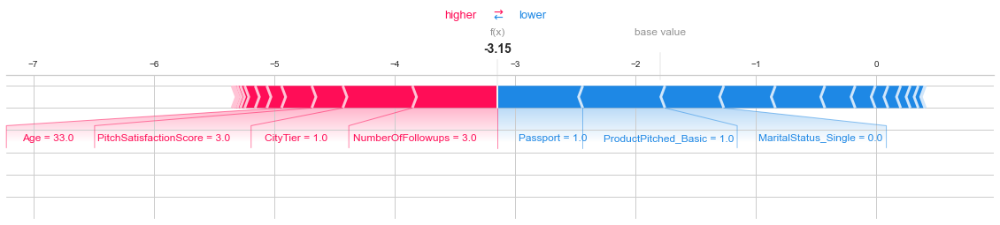

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
862,33.0,1.0,12.0,3.0,2.0,3.0,5.0,1.0,1.0,0.0,2.0,21110.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0


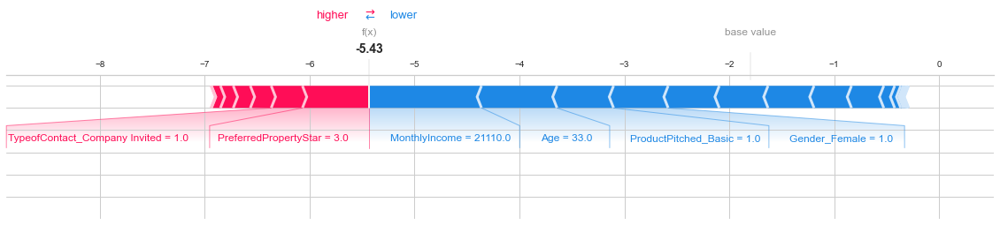

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
1429,42.0,1.0,15.0,4.0,4.0,5.0,3.0,1.0,3.0,0.0,3.0,22781.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0


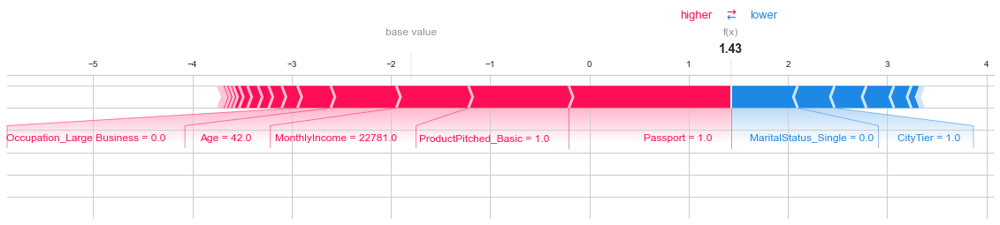

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
1460,30.0,3.0,6.0,3.0,4.0,5.0,2.0,0.0,4.0,1.0,1.0,24714.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


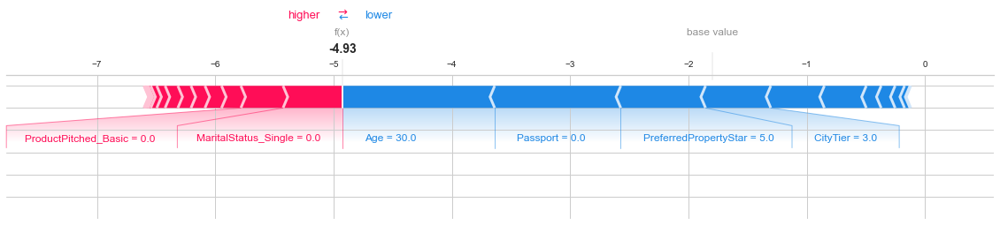

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
120,51.0,3.0,16.0,3.0,3.0,4.0,6.0,0.0,1.0,1.0,2.0,28142.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


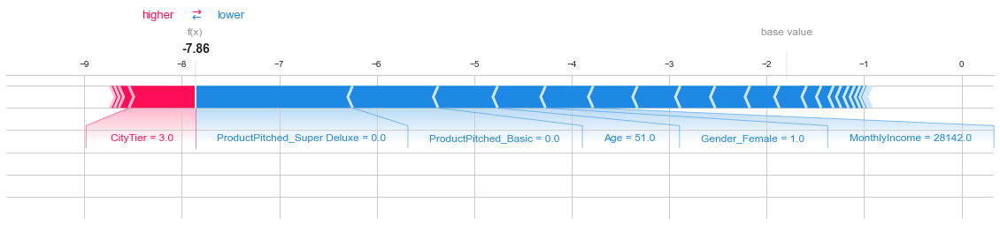

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
1234,28.0,2.0,29.0,3.0,5.0,4.0,3.0,0.0,1.0,1.0,1.0,21541.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0


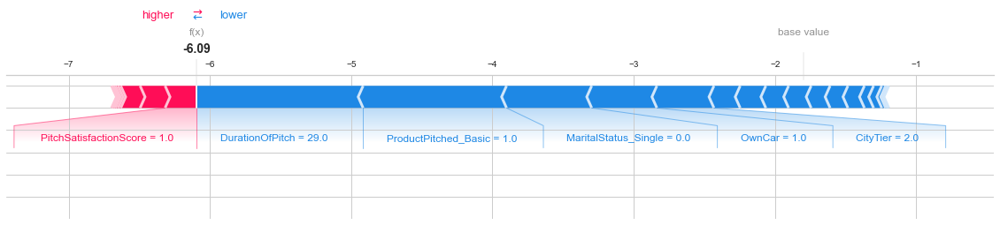

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
840,53.0,1.0,8.0,3.0,4.0,3.0,1.0,0.0,5.0,1.0,2.0,25169.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0


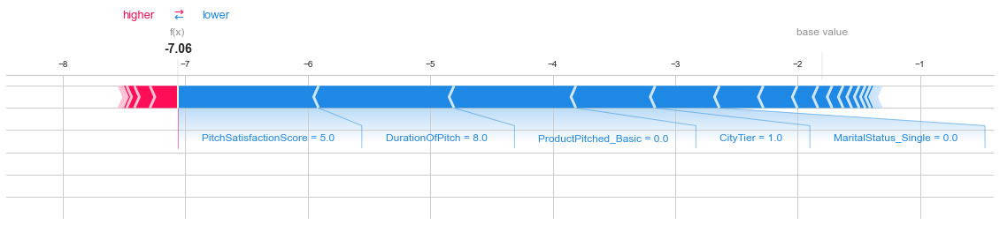

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
249,28.0,1.0,13.0,3.0,3.0,5.0,4.0,1.0,3.0,0.0,2.0,21674.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0


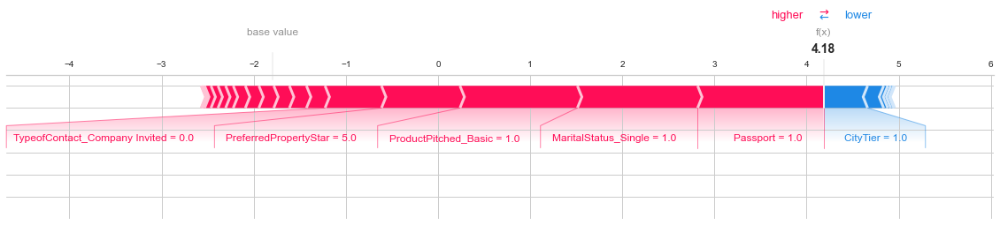

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
338,56.0,1.0,13.0,3.0,3.0,3.0,1.0,0.0,4.0,1.0,2.0,17339.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0


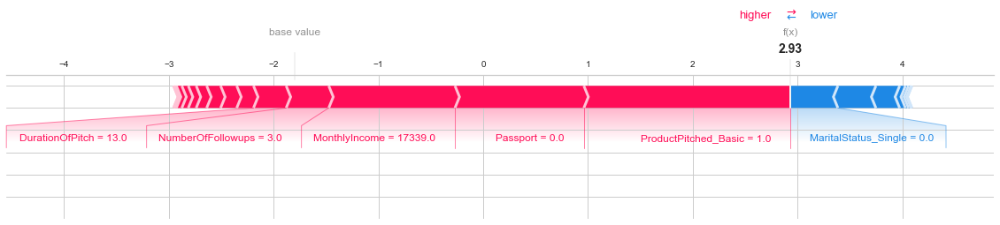

,Age,CityTier,DurationOfPitch,NumberOfPersonVisiting,NumberOfFollowups,PreferredPropertyStar,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,MonthlyIncome,TypeofContact_Company Invited,TypeofContact_Self Enquiry,Occupation_Free Lancer,Occupation_Large Business,Occupation_Salaried,Occupation_Small Business,Gender_Female,Gender_Male,ProductPitched_Basic,ProductPitched_Deluxe,ProductPitched_King,ProductPitched_Standard,ProductPitched_Super Deluxe,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Designation_AVP,Designation_Executive,Designation_Manager,Designation_Senior Manager,Designation_VP
415,56.0,1.0,9.0,4.0,4.0,3.0,7.0,1.0,1.0,1.0,1.0,33408.5,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0


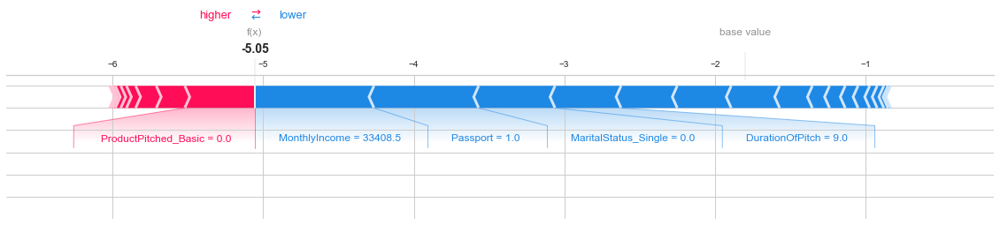

In [489]:
# sample 10 values from wrong predictions
for idx, row in wrong_preditions.sample(10).iterrows():
    # blue - ProductTaken = 0
    # red - ProductTaken = 1
    display(pd.DataFrame(row).T)
    shap.force_plot(shap_ex.expected_value, 
               vals[idx,:], row, matplotlib=True,)

### Observations
- Eventhough some features are pushing to ProductTaken=1, models predicts them as 0. Let's explore more  

In [404]:
# blue - ProductTaken = 0
# red - ProductTaken = 1
shap.force_plot(shap_ex.expected_value, 
               vals[1312,:], X_train.iloc[1312])#, matplotlib=True,)

### Observations
- base value is -2 Anything below that will predict PrductTaken=0 and vice versa.
- In the above plot Blue arrows pushed more than red ones. There are few exceptions to that rule though. It is interesting why model Predicted them as False, even though there is a strong push push to predict it is True 


### Use SHAP to find feature importance

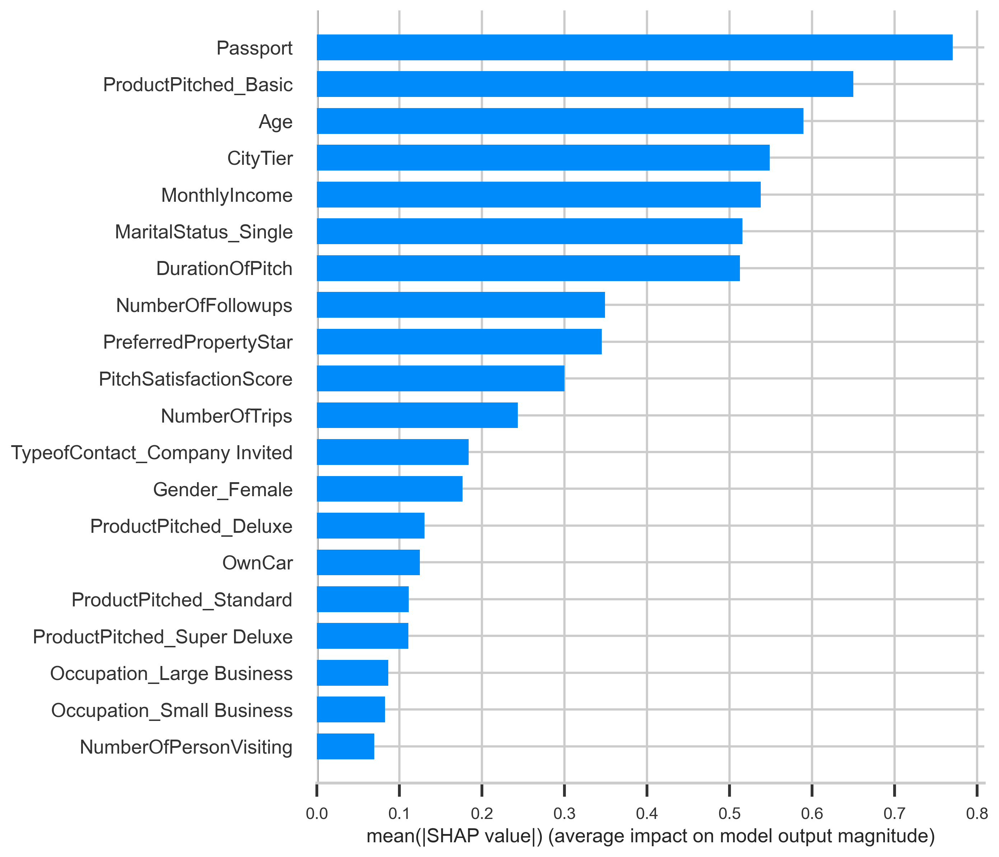

In [295]:
# Summarizes above. Wider variance in SHAP -> More important to model
with sns.plotting_context('talk'):
    fig, ax = plt.subplots(figsize=(10,6), dpi=300)
    shap.summary_plot(vals, X_train, plot_type='bar')

### Observations
- This is similar to Feature Importance

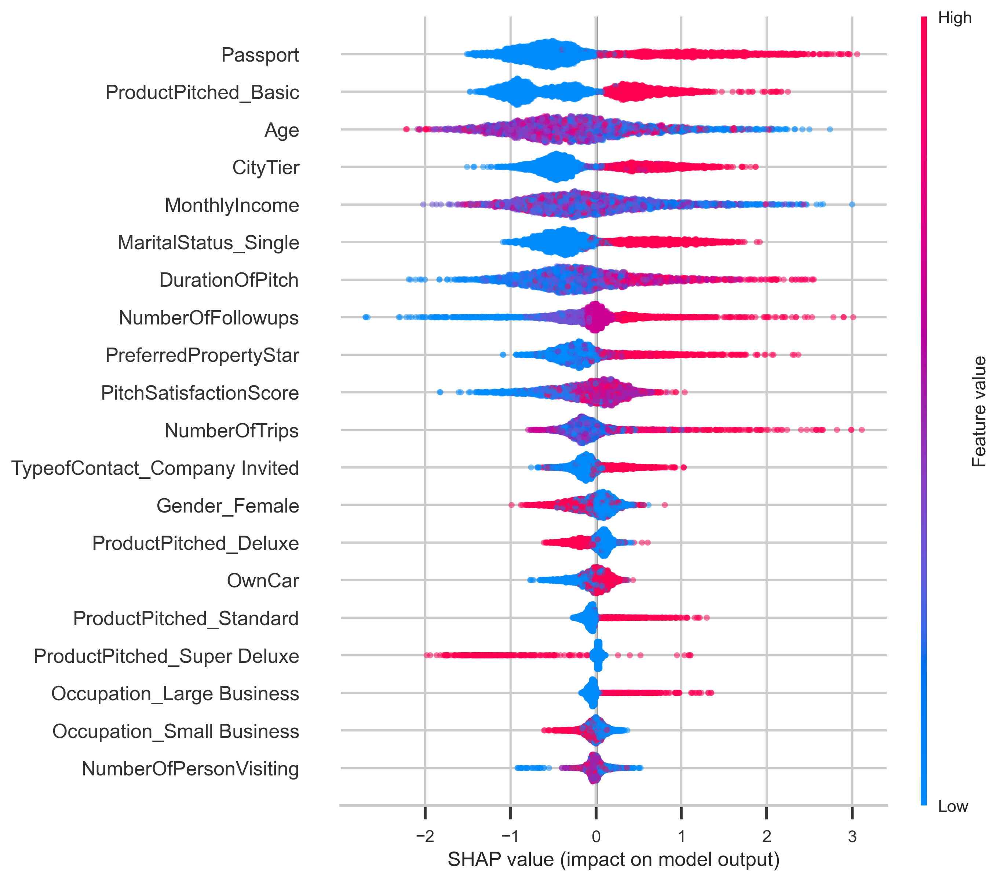

In [296]:
# In this case color is not label, but value of feature
# Higher SHAP - more SE
# High exp - raises SE
# Low R - raises DS - R only has NaN and 1, considers 1 to be "low"
# High Edu - raises DS

with sns.plotting_context('talk'):
    fig, ax = plt.subplots(figsize=(10,6), dpi=300)
    shap.summary_plot(vals, X_train, alpha=.5)

### Observations
Main features that influence customers in taking Product
- Owns Passport
- ProductPitched as Basic
- Higher CityTier 
- MaritalStatus as Single
- Higher NumberOfFollowups 
- Higher PreferredPropertyStar
- Higher NumberOfTrips
- Lower MonthyIncome
- TypeOfContact is Company Invited
- ProductPitched as Standard
- Occupation as Large Business


Features that has negative influence in taking Product
- ProductPitched as Super Deluxe
- Lower PitchSatisfactionScore

Features that has slightly negative influence in taking Product
- Female customers
- customers who don't OwnCar
- Occupation as Small Business
- Less NumberOfPersonVisiting

Feature that has influence on model, but can't be use to determine the purchare of Product are 
- Age
- DurationOfPitch

### Stacking classifier

In [523]:
estimators = [('Decision Tree',dtc),('Random Forest',rfc), ('XG Boosting',xgb)]

final_estimator = xgb

stacking_classifier= StackingClassifier(estimators=estimators,final_estimator=final_estimator)

stacking_classifier.fit(X_train,y_train)

StackingClassifier(estimators=[('Decision Tree',
                                DecisionTreeClassifier(max_depth=8)),
                               ('Random Forest',
                                RandomForestClassifier(random_state=1)),
                               ('XG Boosting',
                                XGBClassifier(base_score=0.5, booster='gbtree',
                                              colsample_bylevel=1,
                                              colsample_bynode=1,
                                              colsample_bytree=1,
                                              eval_metric='logloss', gamma=0,
                                              gpu_id=-1, importance_type='gain',
                                              interaction_constraints='',
                                              le...
                                                 eval_metric='logloss', gamma=0,
                                                 gpu_id=-1,
       

### Get optimal threshold 

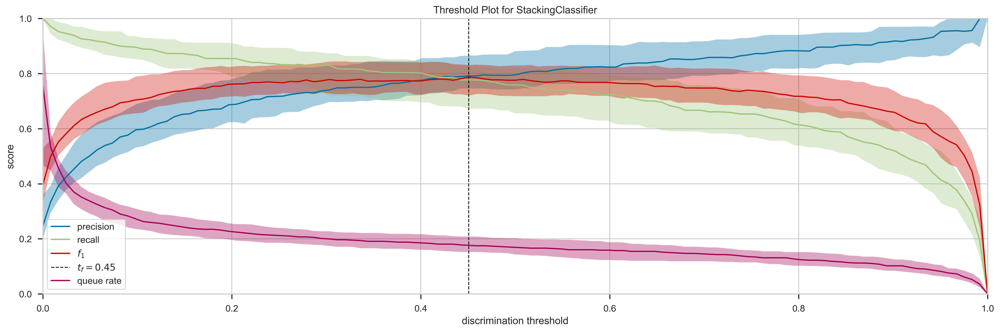

In [525]:
with sns.plotting_context('notebook'):
    fig, (ax1) = plt.subplots(ncols=1, figsize=(20,6), dpi=300)
    stk_viz = classifier.DiscriminationThreshold(stacking_classifier, ax=ax1)
    stk_viz.fit(X_train, y_train)
    stk_viz.score(X_test, y_test)
    stk_viz.finalize()
    

### Observations
- Optimal threshold is 0.45

### Get confusion matrices

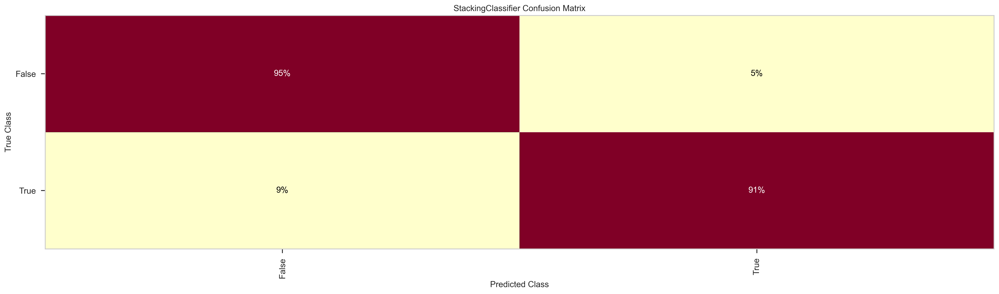

In [526]:
y_train_stacking =  (xgb.predict_proba(X_train)[:,1]>=0.45)
y_test_stacking = (xgb.predict_proba(X_test)[:,1]>=0.45)

with sns.plotting_context('notebook'):
    fig, (ax1) = plt.subplots(ncols=1, figsize=(20,6), dpi=300)
    stk_viz = classifier.ConfusionMatrix(stacking_classifier, ax=ax1, percent=True)
    stk_viz.fit(X_train, y_train_stacking)
    stk_viz.score(X_test, y_test_stacking)
    stk_viz.finalize()

### Observations
- This outperforms single XGBoost model!!! Let's compare them side by side

### Confusion matrices for stacking and XGBoost classifier

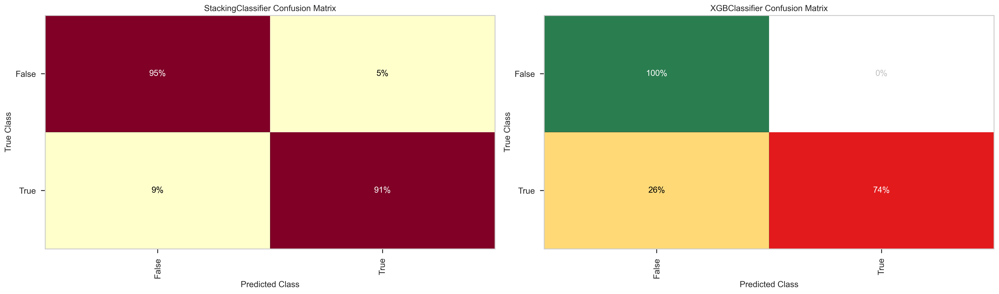

In [528]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20,6), dpi=300)
    stk_viz = classifier.ConfusionMatrix(stacking_classifier, ax=ax1, percent=True)
    stk_viz.fit(X_train, y_train_stacking)
    stk_viz.score(X_test, y_test_stacking)
    stk_viz.finalize()
    
    xgb_viz = classifier.ConfusionMatrix(xgb, ax=ax2, percent=True)
    xgb_viz.fit(X_train, y_train_xgb)
    xgb_viz.score(X_test, y_test_xgb)
    xgb_viz.finalize()

### Observations
Stacking classifier has 
- only 9% False Negatives where as XGBoost has 26% of them
- Also True Postive rate is 91% when compared to 74% with XGBoost

### ClassificationReport for stacking and XGBoost classifier

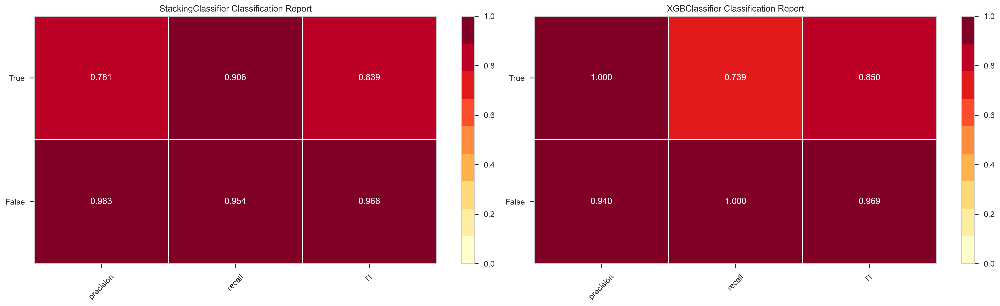

In [529]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20,6), dpi=300)
    stk_rep_viz = classifier.ClassificationReport(stacking_classifier, ax=ax1, percent=True)
    stk_rep_viz.fit(X_train, y_train_stacking)
    stk_rep_viz.score(X_test, y_test_stacking)
    stk_rep_viz.finalize()
    
    xgb_rep_viz = classifier.ClassificationReport(xgb, ax=ax2, percent=True)
    xgb_rep_viz.fit(X_train, y_train_xgb)
    xgb_rep_viz.score(X_test, y_test_xgb)
    xgb_rep_viz.finalize()
    
    
    all_metrics["XGBoostOptimalThresholdOf0.23"] = xgb_rep_viz.scores_
    all_metrics["StackingOptimalThresholdOf0.45"] = stk_rep_viz.scores_

### Observations
- StackingClassifier has less precision when compared to XGBoost. It is OK to have False Postives for our use cases, because we can try next time.
- False Negatives or Recall is what we are concerned about. Since will False Negatives we will lose our business and would impact us financially.
- Comparitively StackingClassifier has 90% Recall score compared to 74% with XGBoost classifier. This is an improvement of more than 15% so I would pick stacking model as my togo model!!



### Feature Importances for Stacking vrs XGBoost classifier

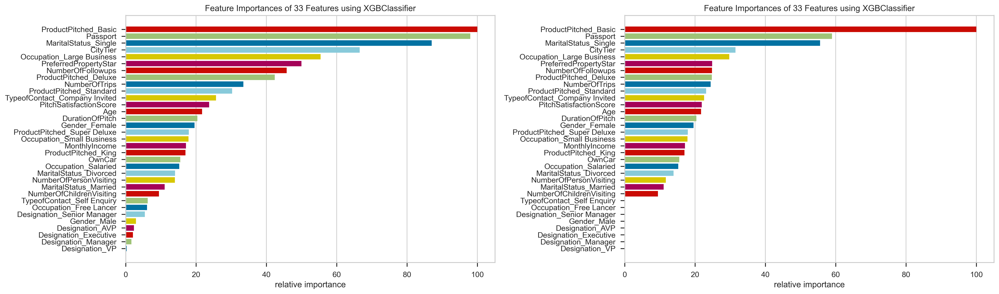

In [557]:
with sns.plotting_context('notebook'):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20,6), dpi=300)
    
    for i, est in enumerate(stacking_classifier.estimators_):
        cm_viz = features.FeatureImportances(est, ax=ax1, percent=True)
        cm_viz.fit(X_train, y_train_stacking)
        cm_viz.score(X_test, y_test_stacking)
        cm_viz.finalize()
    
    fi_viz = features.FeatureImportances(xgb, ax=ax2, percent=True)
    fi_viz.fit(X_train, y_train_xgb)
    fi_viz.score(X_test, y_test_xgb)
    fi_viz.finalize()

### Observations
- Stacking Classifier added few more features to the model prediction compared to XGBoost. This explains it performed better in terms of predicting False Negatives.

### Exploring the feature Importance even More using SHAP library

In [570]:
# initialize shap javascript obj
shap.initjs()

In [572]:
for i, est in enumerate(stacking_classifier.estimators_):
    shap_ex_stk = shap.TreeExplainer(est)
    vals_stk = shap_ex_stk.shap_values(X_train)

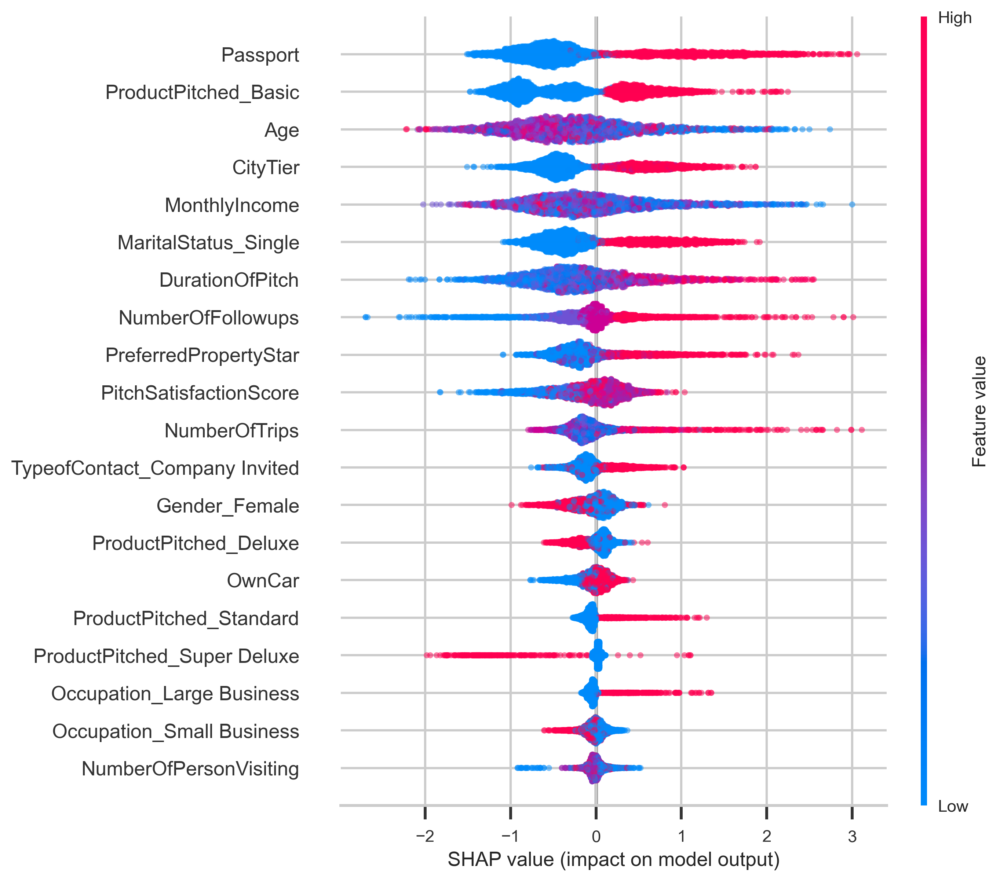

In [574]:
# In this case color is not label, but value of feature
# Higher SHAP - ProductTaken = 1
with sns.plotting_context('talk'):
    fig, ax = plt.subplots(figsize=(10,6), dpi=300)
    shap.summary_plot(vals_stk, X_train, alpha=.5)

### Observations
Main features that influence customers in taking Product
- Owns Passport
- ProductPitched as Basic
- Younger Age
- Higher CityTier 
- Lower MonthlyIncome
- MaritalStatus as Single
- Higher NumberOfFollowups 
- Higher PreferredPropertyStar
- Higher NumberOfTrips
- Lower MonthyIncome
- TypeOfContact is Company Invited
- ProductPitched as Standard
- Occupation as Large Business

Features that has sight positive influence in taking Product
- Higher DurationOfPitch

Features that has negative influence in taking Product
- ProductPitched as Super Deluxe
- Lower PitchSatisfactionScore

Features that has slightly negative influence in taking Product
- Female customers
- customers who don't OwnCar
- Occupation as Small Business
- Less NumberOfPersonVisiting

Feature that has influence on model, but can't be use to determine the purchare of Product are 
- Age
- DurationOfPitch

### Feature dependency Plots

### PitchStatisfactionScore vrs ProductPitched_Basic

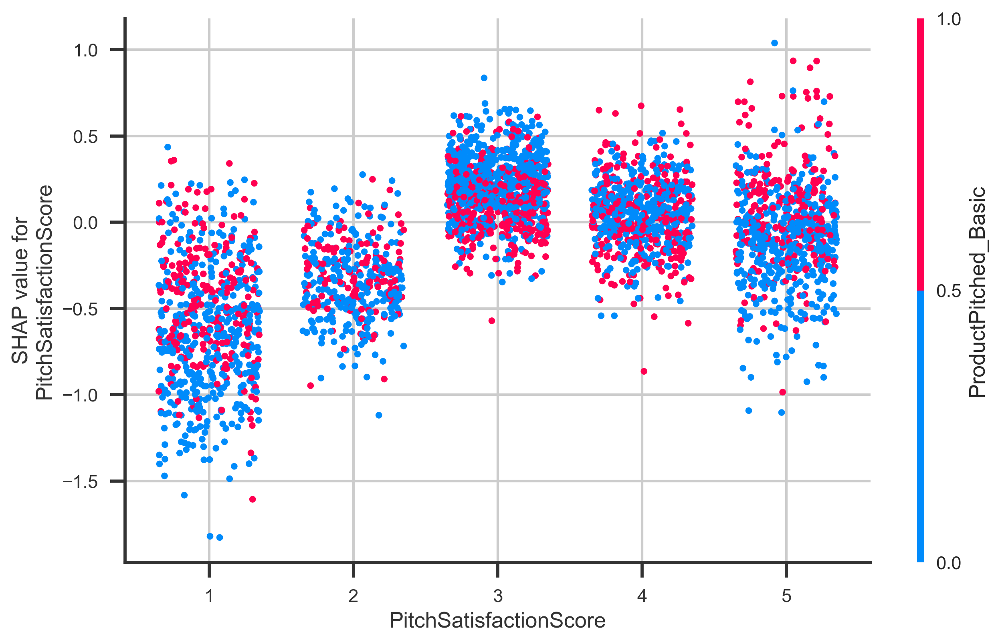

In [566]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('PitchSatisfactionScore', vals_stk, X_train, ax=ax, interaction_index='ProductPitched_Basic',   alpha=1, x_jitter=.7)

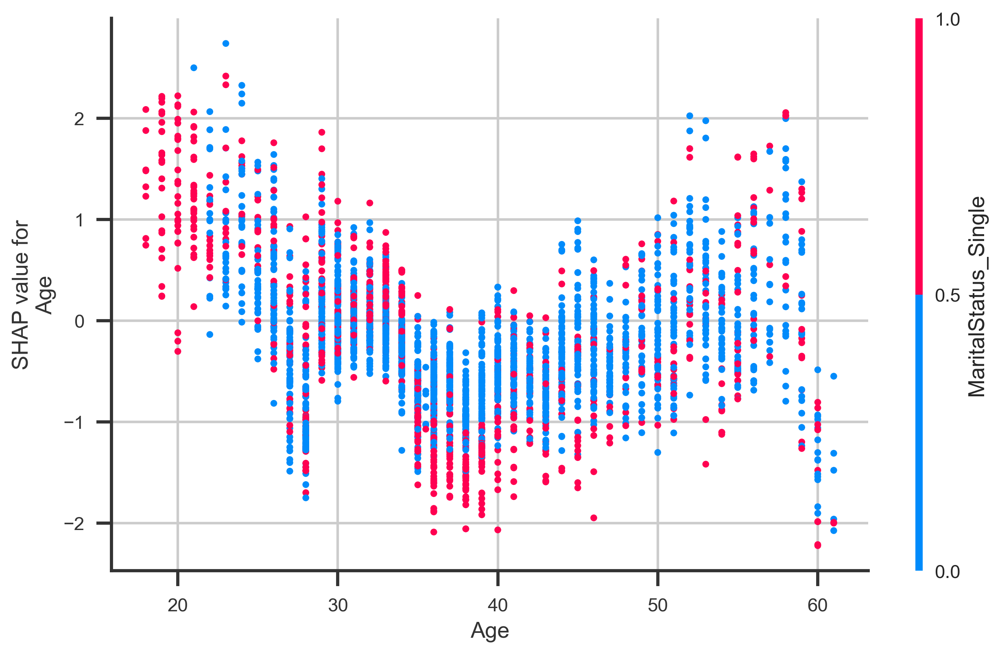

In [297]:
# Age dependence_plot
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1)

### Observations
- More singles with Age in between 18 and 22 tends to take Product.
- Middle Aged Singles, i.e., people between 35 to 40 tends not to take the Product

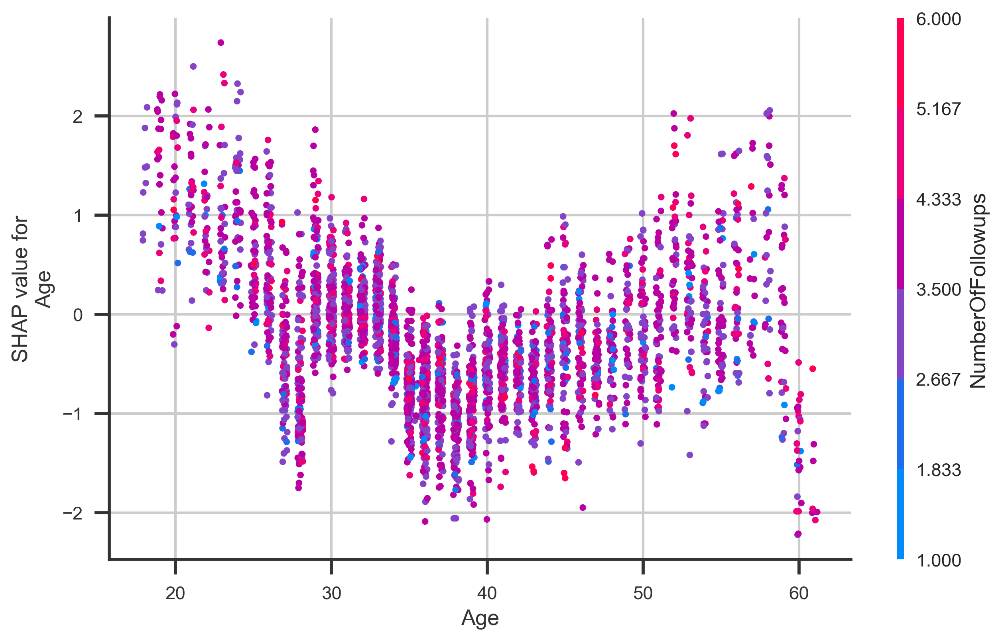

In [298]:
# Age dependence_plot with NumberOfFollowups
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='NumberOfFollowups', x_jitter=.7)

### Observations
- Looks like there even with higher NumberOfFollowups, customers in between Age groups of 25 to 30 and 35 to 45 tend not to buy the Product.
- Age groups in between 18 to 25, 30 to 35, 50 to 60 tend to respond to Purchase Product more. 
- Younger groups in between 18 to 25 less NumberOfFollowups


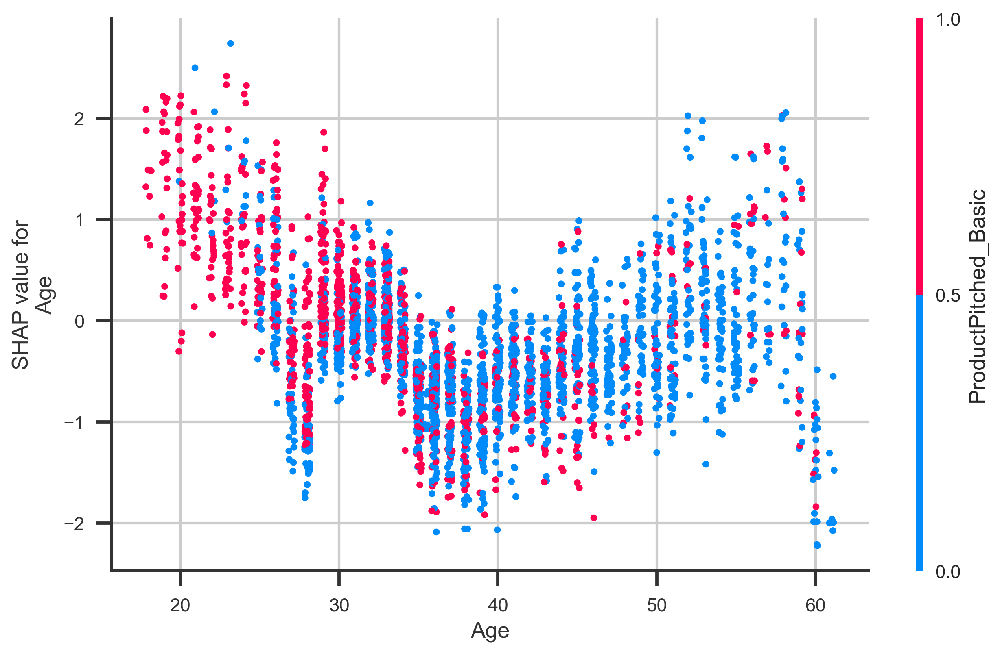

In [308]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Basic', x_jitter=.7)

### Observations
- Younger Aged customers in between 18 and 35 years picked Basic product

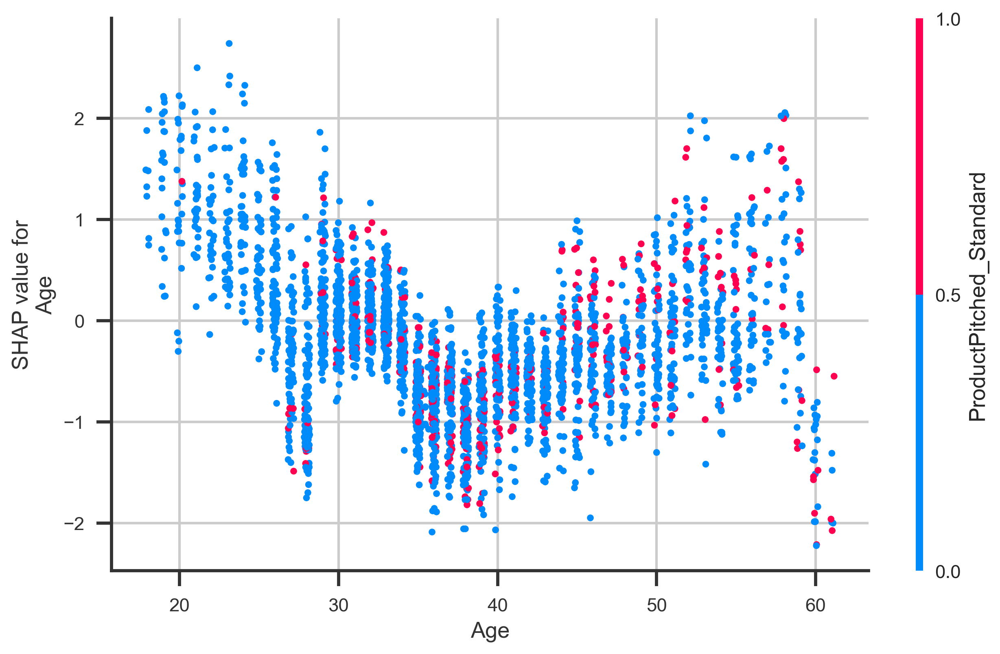

In [309]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Standard', x_jitter=.7)

### Observations
- Standard Product is popular among 45 to 60 Age groups

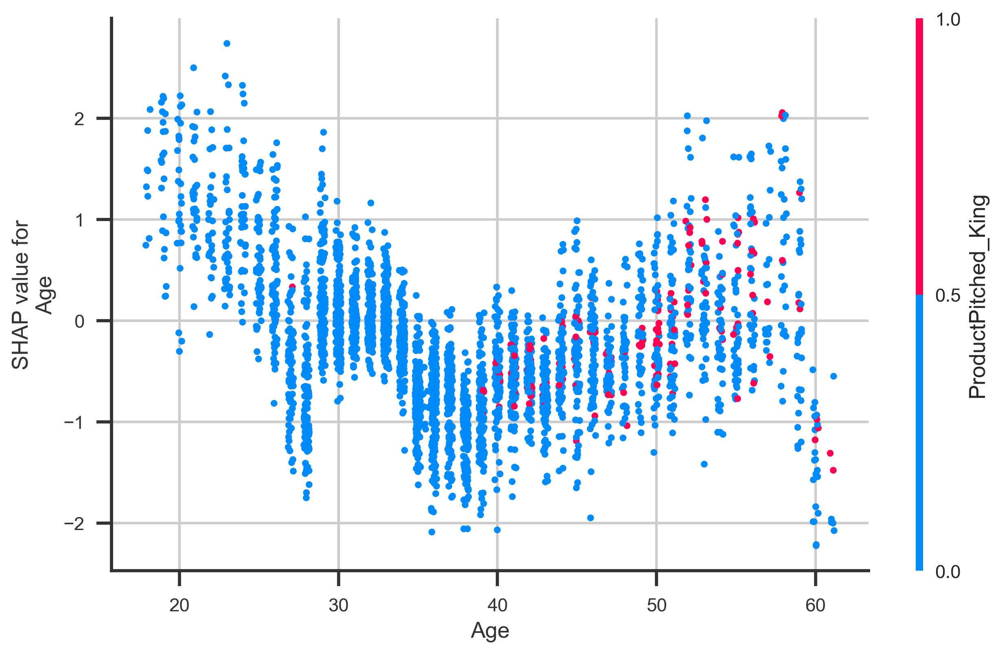

In [311]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_King', x_jitter=.7)

### Observations
King is the best Product for Age groups 50 to 60

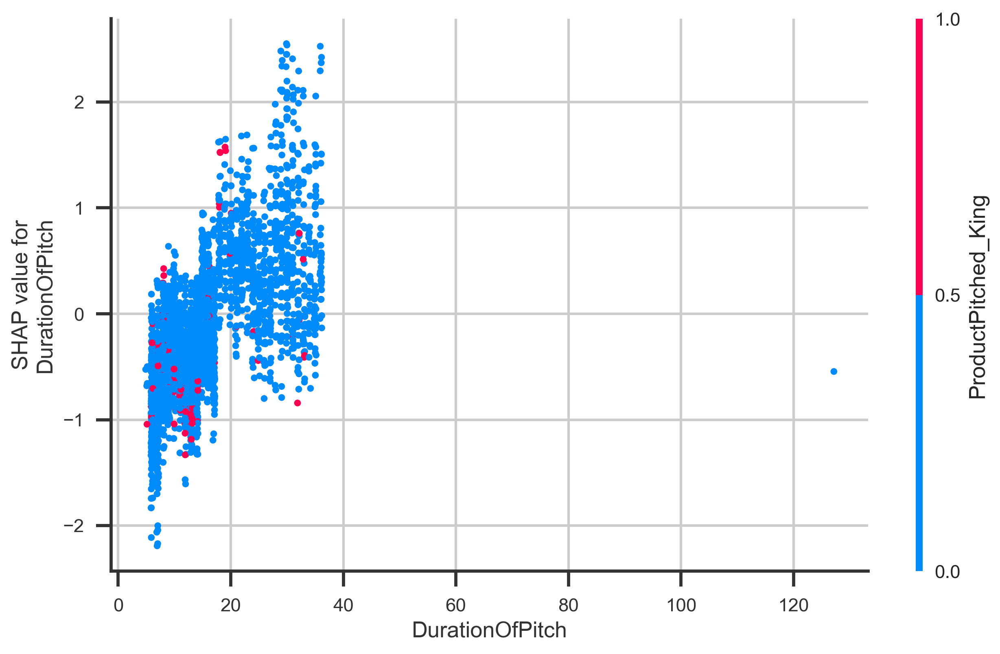

In [307]:
# Age dependence_plot
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('DurationOfPitch', vals, X_train, ax=ax, alpha=1, 
                         interaction_index='ProductPitched_King', x_jitter=.7)

### Observations
- Higher DurationOfPitch won't help to buy expensive Products. 

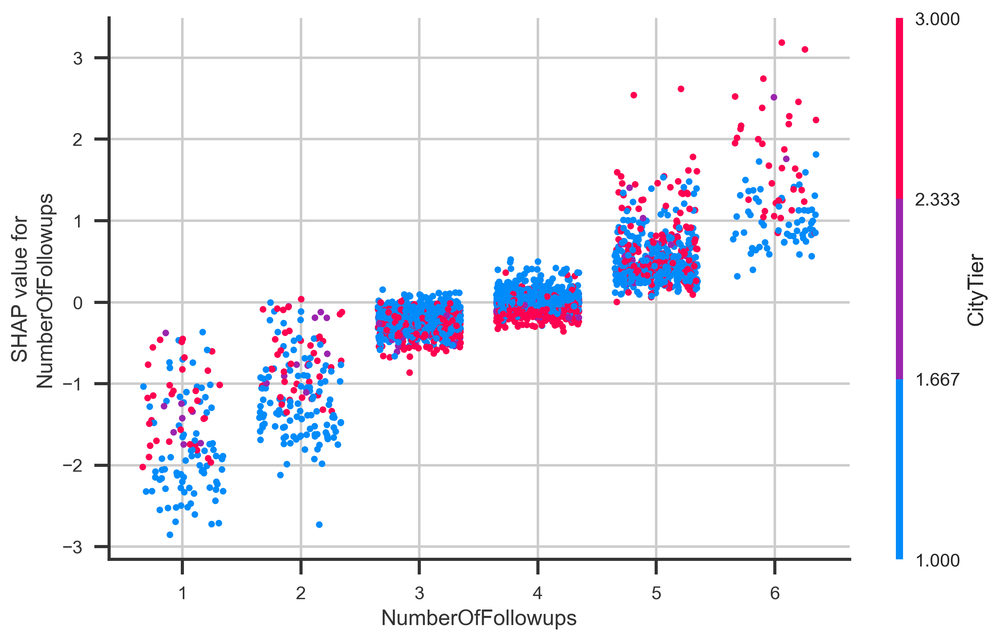

In [221]:
# NumberOfFollowups dependence_plot 
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfFollowups', vals, X_train, ax=ax, alpha=1,  x_jitter=.7)

### Observations
- Sweet spot for NumberOfFollowups is greaterthan or equal to 5

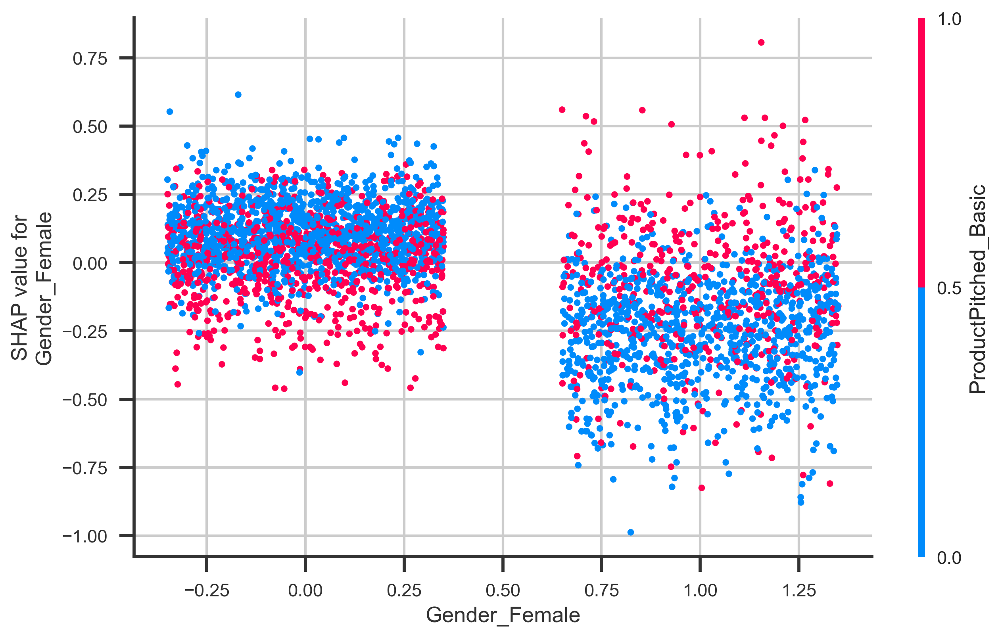

In [300]:
# NumberOfFollowups dependence_plot 
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Gender_Female', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Basic', x_jitter=.7)

### Observations
- Looks like Female customers who bought Package picked Basic Product.

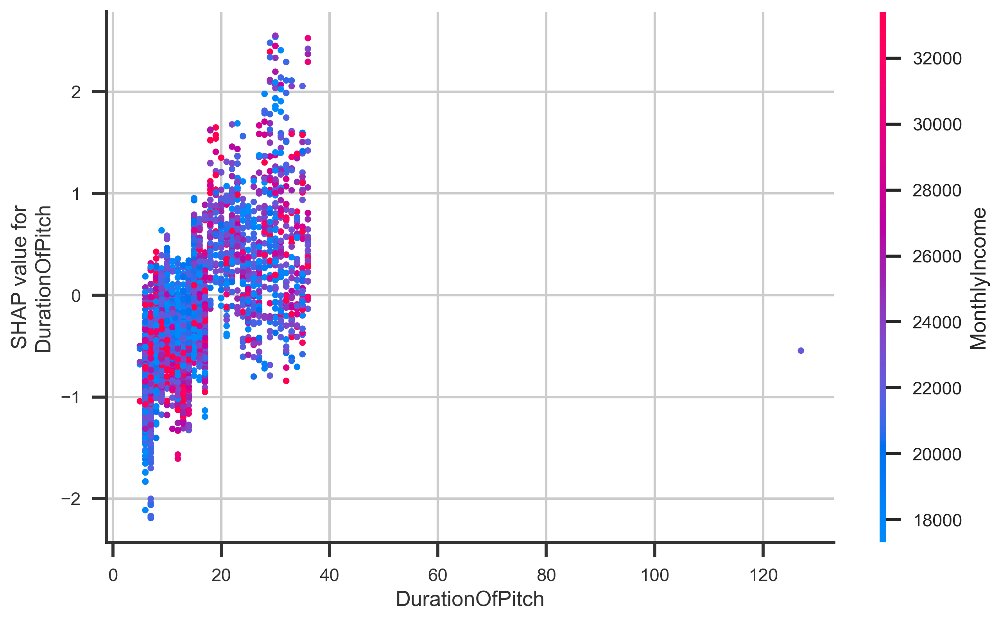

In [301]:
# DurationOfPitch dependence_plot
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('DurationOfPitch', vals, X_train, ax=ax, alpha=1)

### Observations
- People with MonthlyIncome greater than 25000, tend to purchase Product and these people may require DurationOfPtich in between 20 to 40 mins.

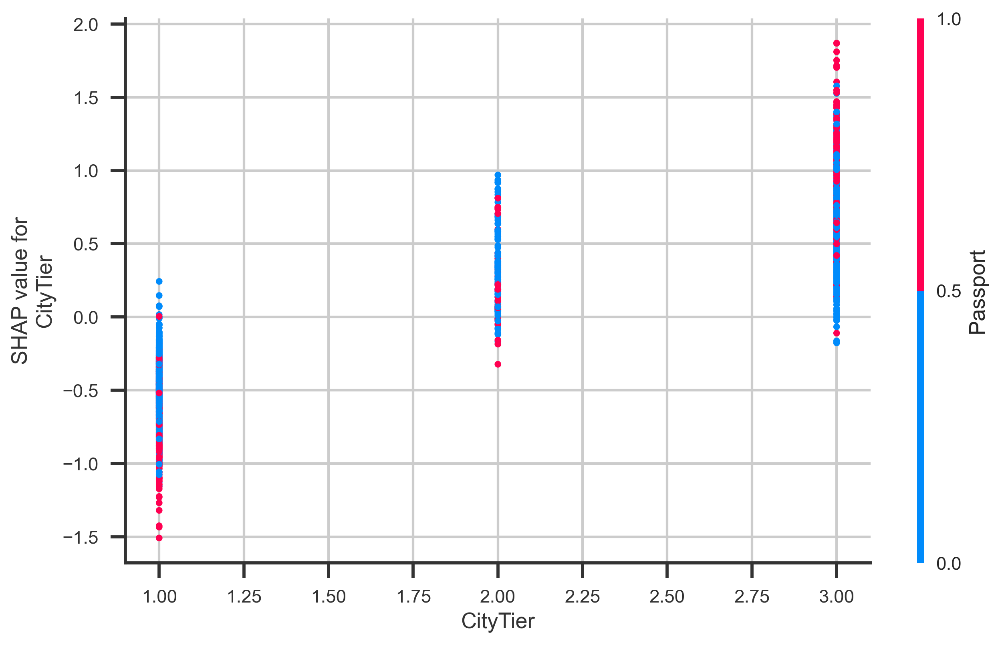

In [302]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('CityTier', vals, X_train, ax=ax, alpha=1)

### Observations
- Customers living in CityTier 2 and 3 test to Purchase Products.

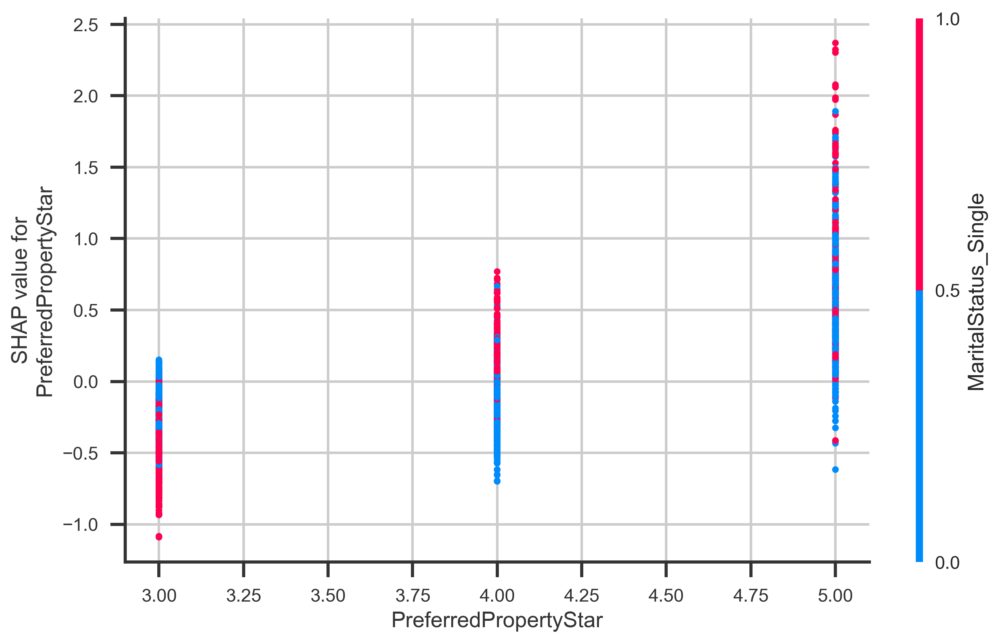

In [316]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('PreferredPropertyStar', vals, X_train, ax=ax, alpha=1)

### Observations
- Many singles who bought the Product preferred 4 and 5 star properties.
- However others who bought the Product showed interest towards 5 star properties.

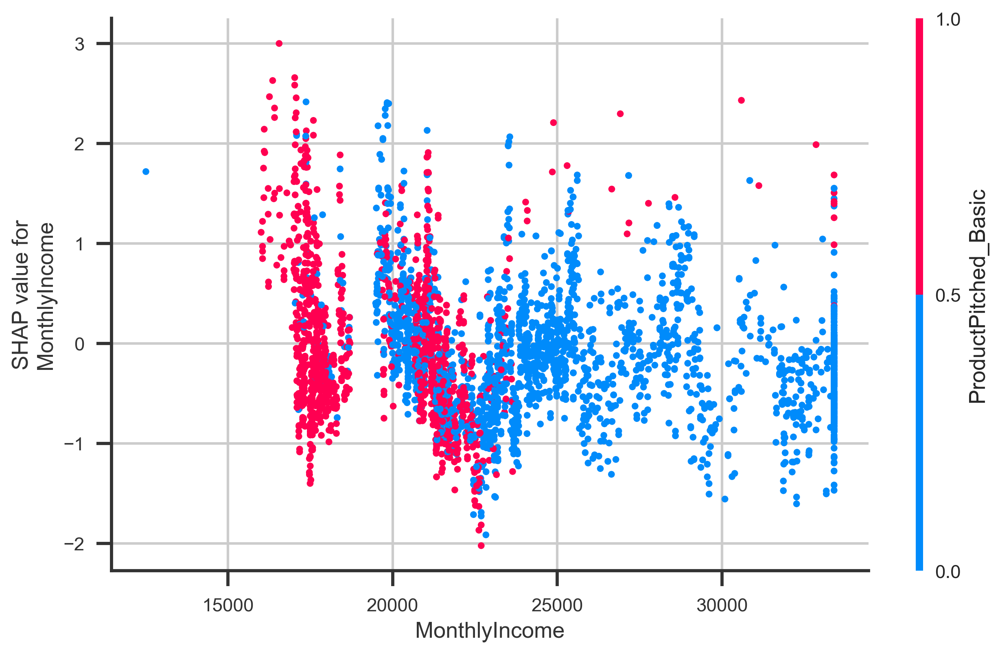

In [320]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Basic', x_jitter=.7)

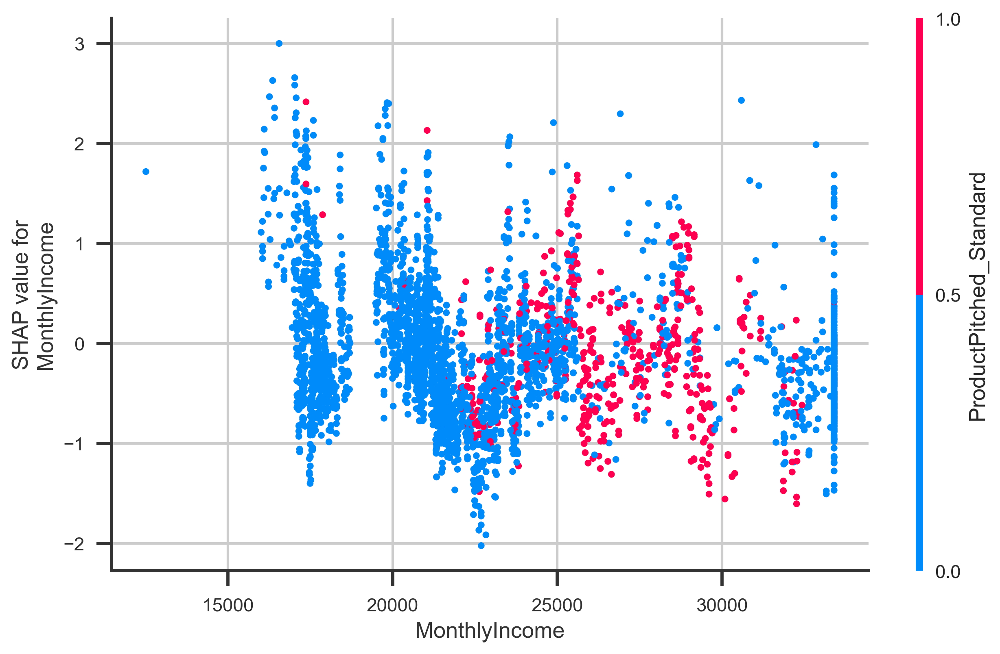

In [321]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Standard', x_jitter=.7)

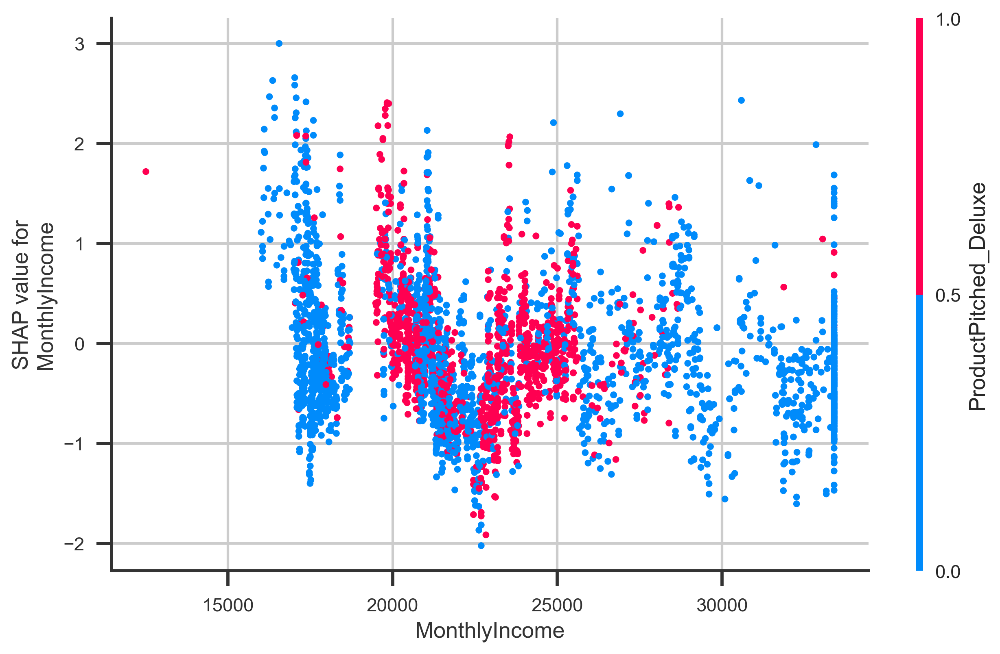

In [322]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Deluxe', x_jitter=.7)

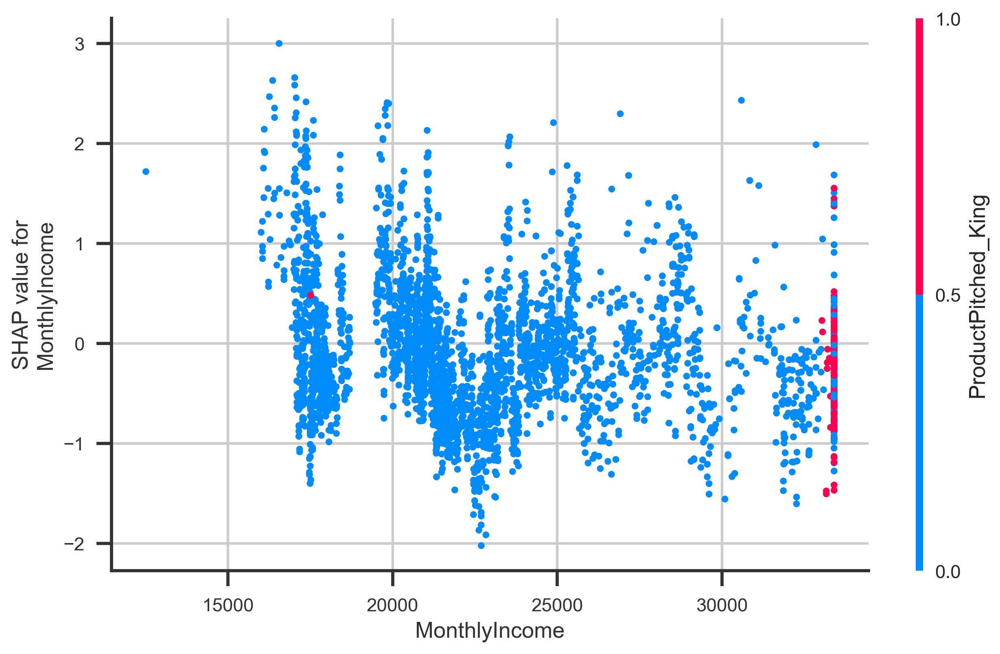

In [324]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_King', x_jitter=.7)

### Observations
- People with MonthlyIncome in between 15000 to 22000 tend to buy Basic product.
- People with MonthlyIncome in between 18000 to 25000 tend to buy Deluxe product.
- People with MonthlyIncome in between 25000 to 30000 tend to buy Standard product.
- People with MonthlyIncome about 30000 tend to buy King product. However it requires more data.

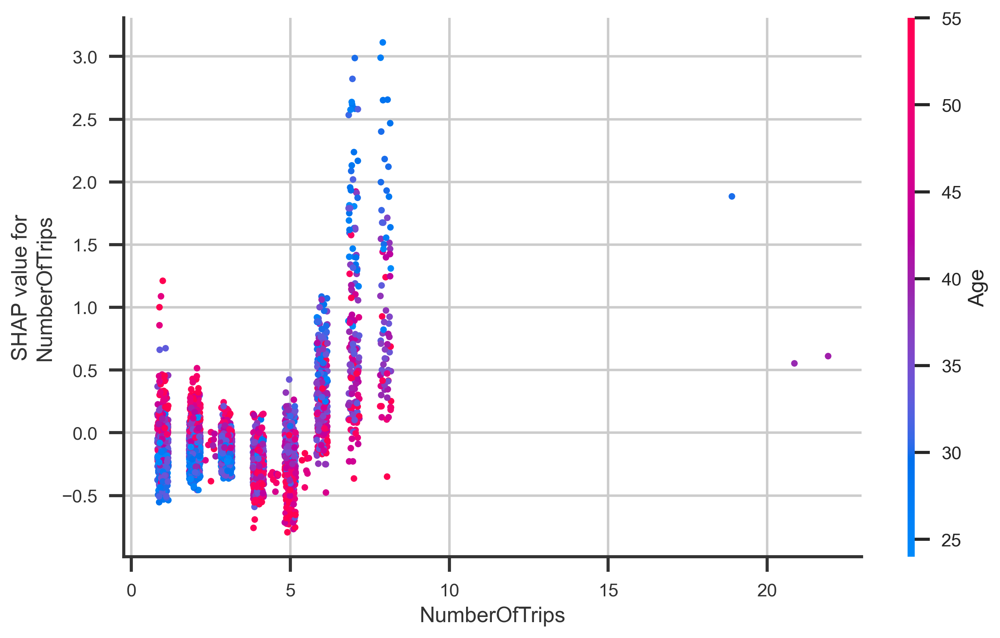

In [326]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, alpha=1, x_jitter=.7)

### Observations
- Higher NumberOfTrips is a strong indication of Person taking a Product
- Younger People tend to have higher NumberOfTripds

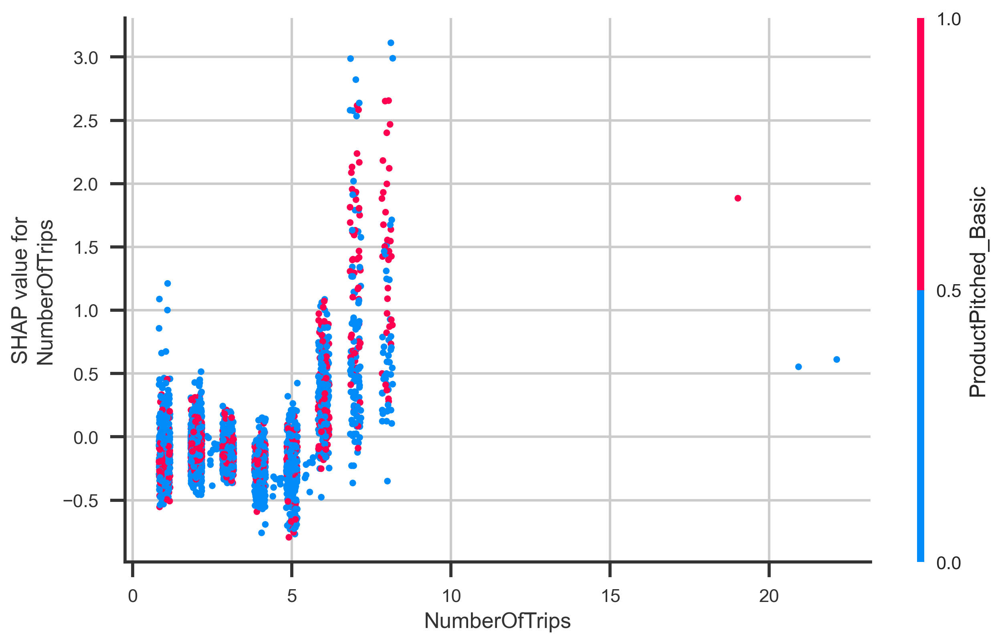

In [327]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_Basic', alpha=1, x_jitter=.7)

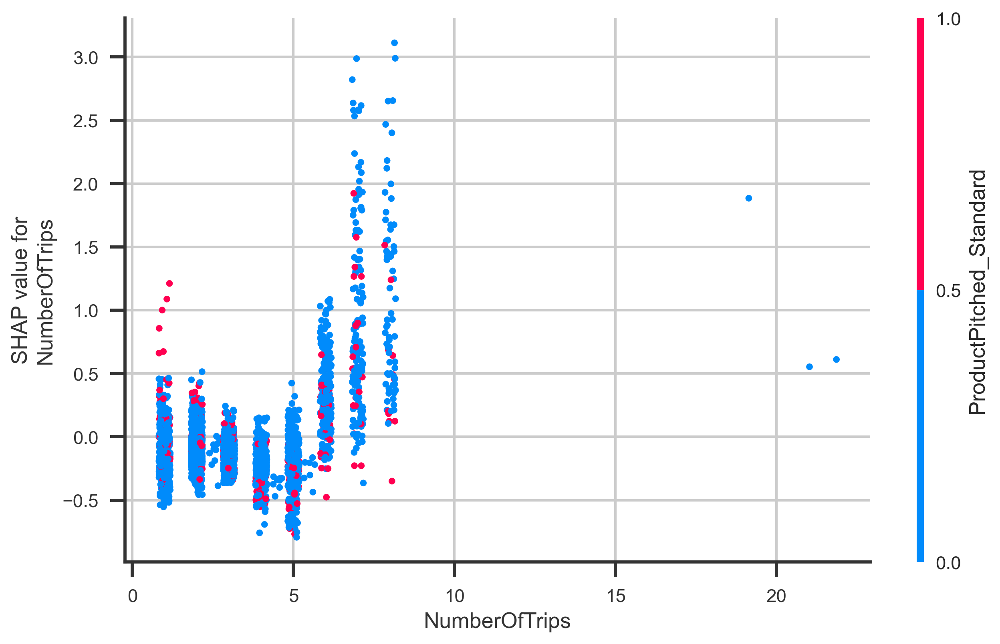

In [328]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_Standard', alpha=1, x_jitter=.7)

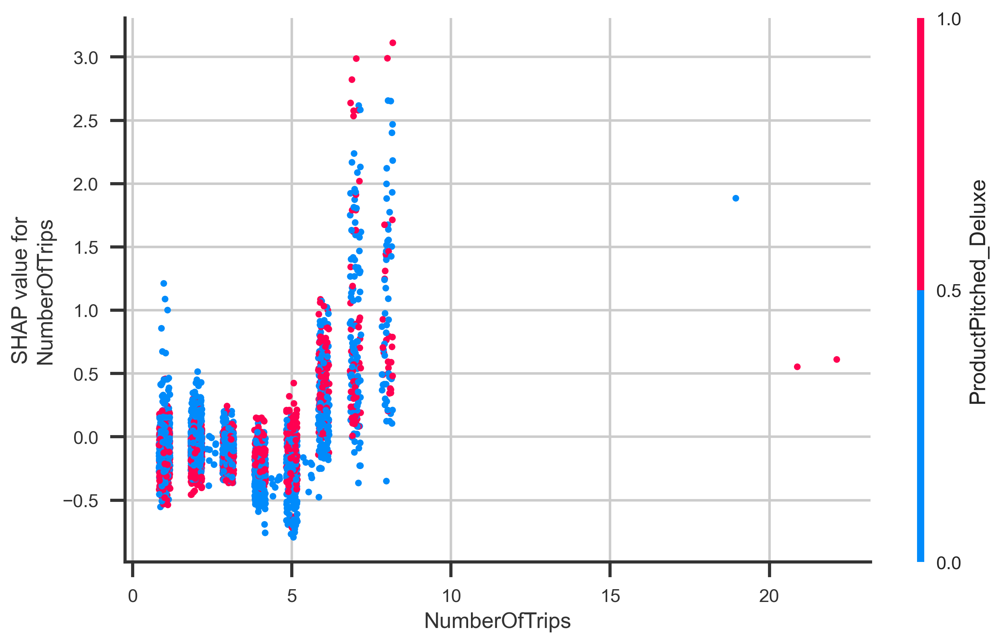

In [329]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_Deluxe', alpha=1, x_jitter=.7)

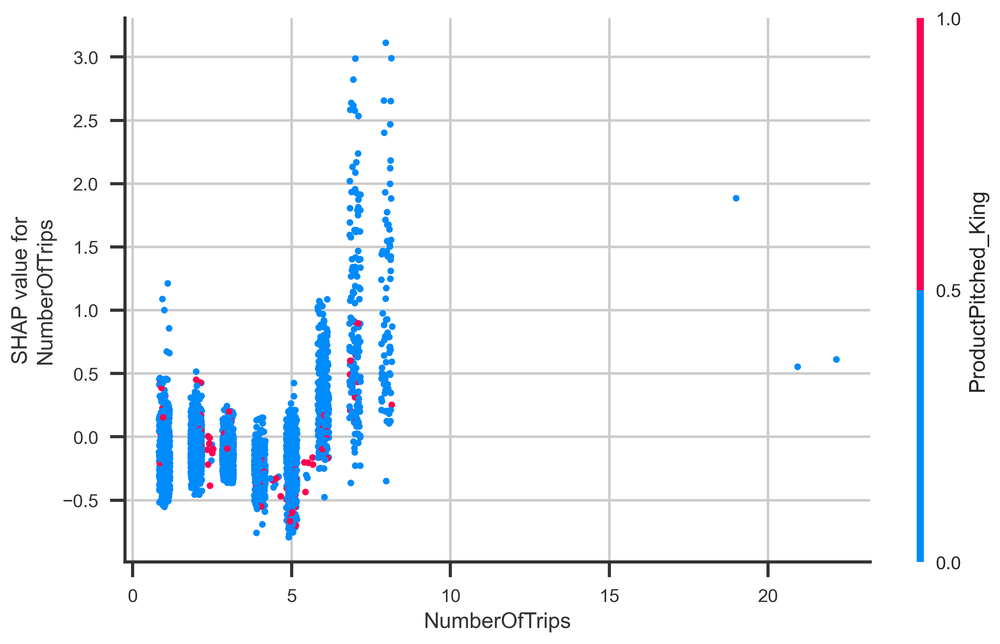

In [330]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_King', alpha=1, x_jitter=.7)

### Observations
- Customers with higher NumberOfTrips purchased Basic Product, followed by Deluxe

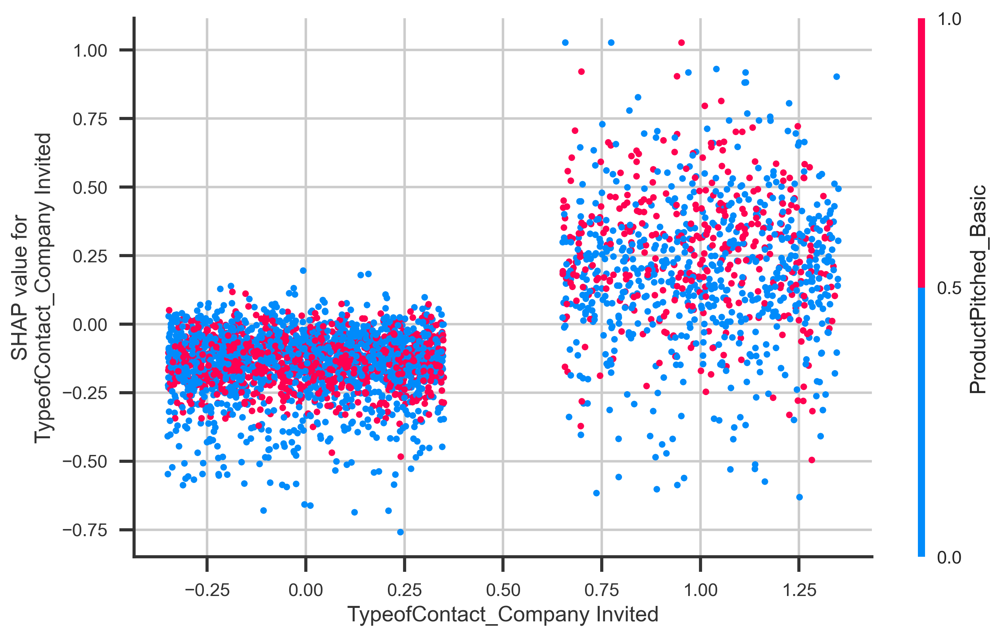

In [336]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('TypeofContact_Company Invited', vals, X_train, ax=ax,  interaction_index='ProductPitched_Basic', alpha=1, x_jitter=.7)

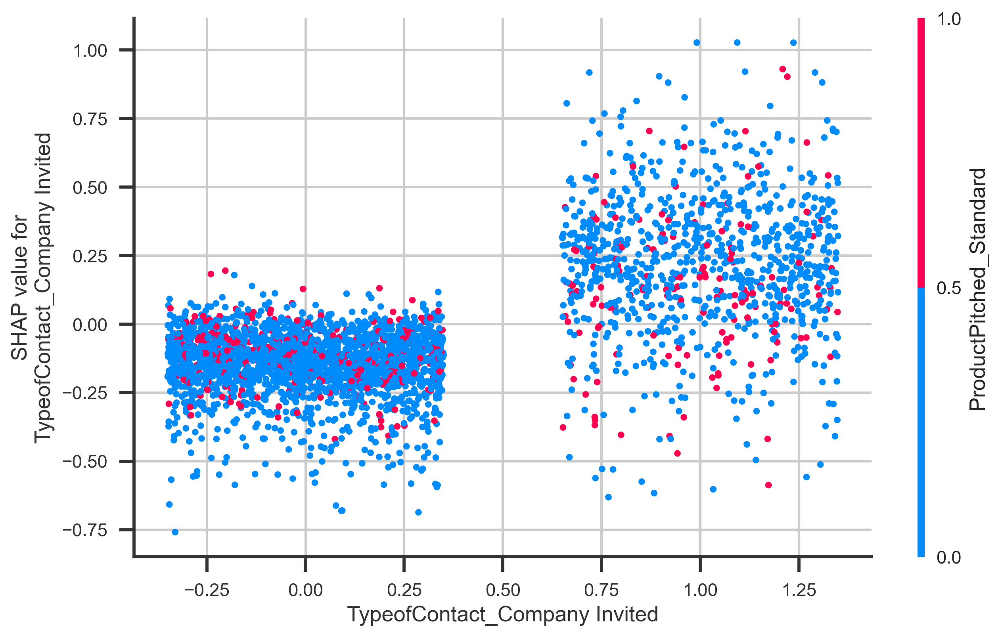

In [337]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('TypeofContact_Company Invited', vals, X_train, ax=ax,  interaction_index='ProductPitched_Standard', alpha=1, x_jitter=.7)

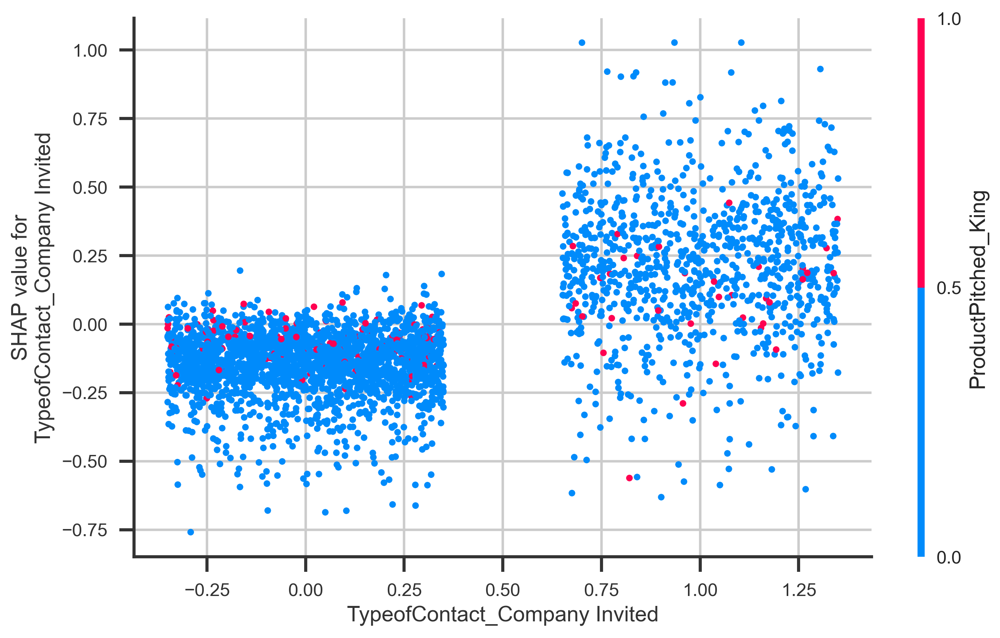

In [339]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('TypeofContact_Company Invited', vals, X_train, ax=ax,  interaction_index='ProductPitched_King', alpha=1, x_jitter=.7)

### Observations
- When TypeOfContact is Company Invited, people tend to buy the Product
- The popular among the mis Basic, followed by Standard and King.

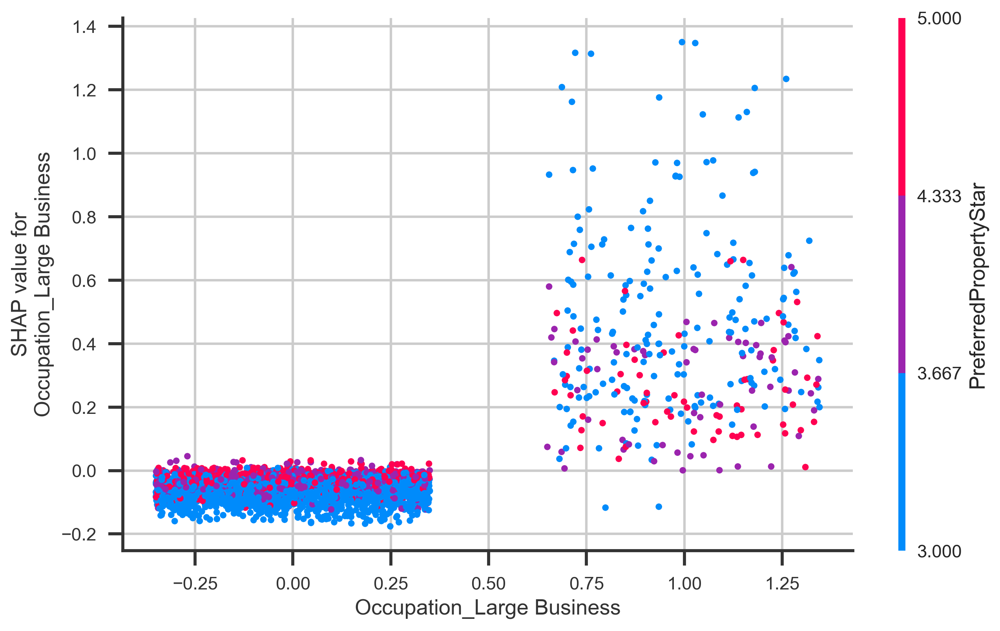

In [340]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,   alpha=1, x_jitter=.7)

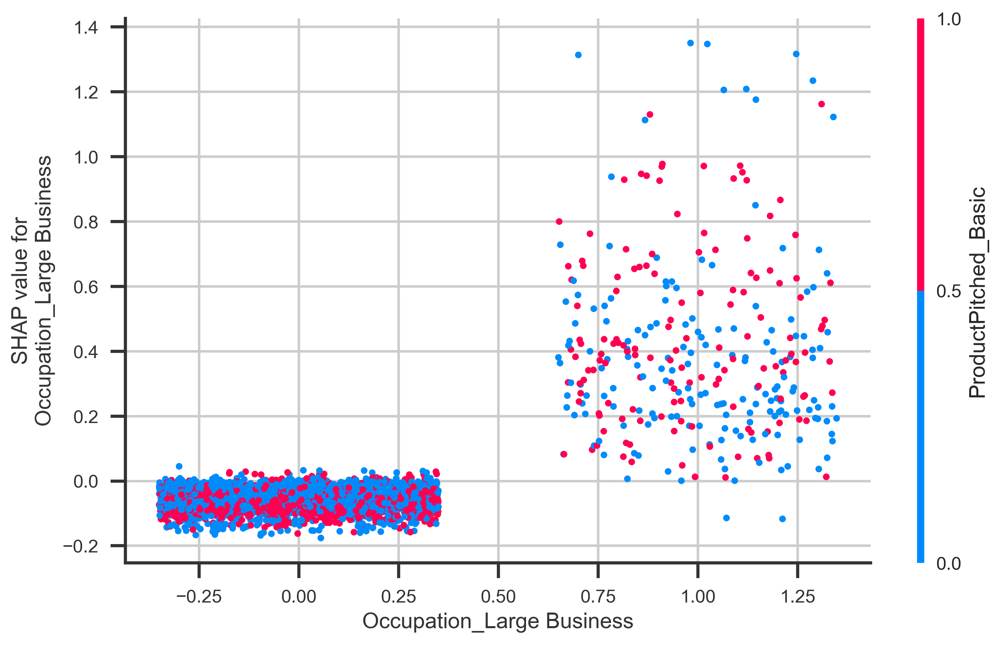

In [341]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,  interaction_index='ProductPitched_Basic', alpha=1, x_jitter=.7)

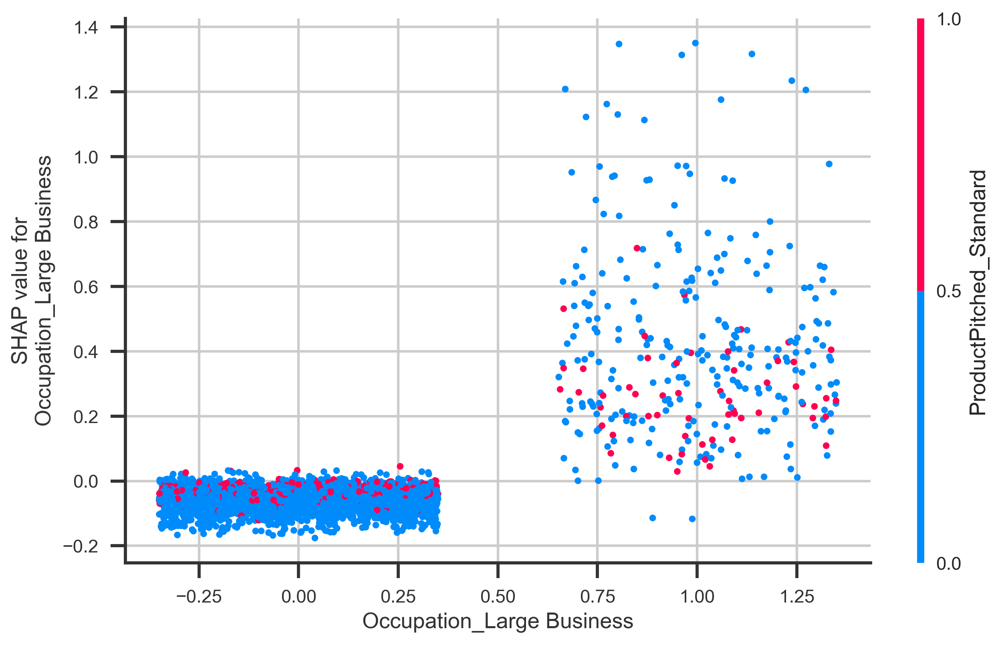

In [342]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,  interaction_index='ProductPitched_Standard', alpha=1, x_jitter=.7)

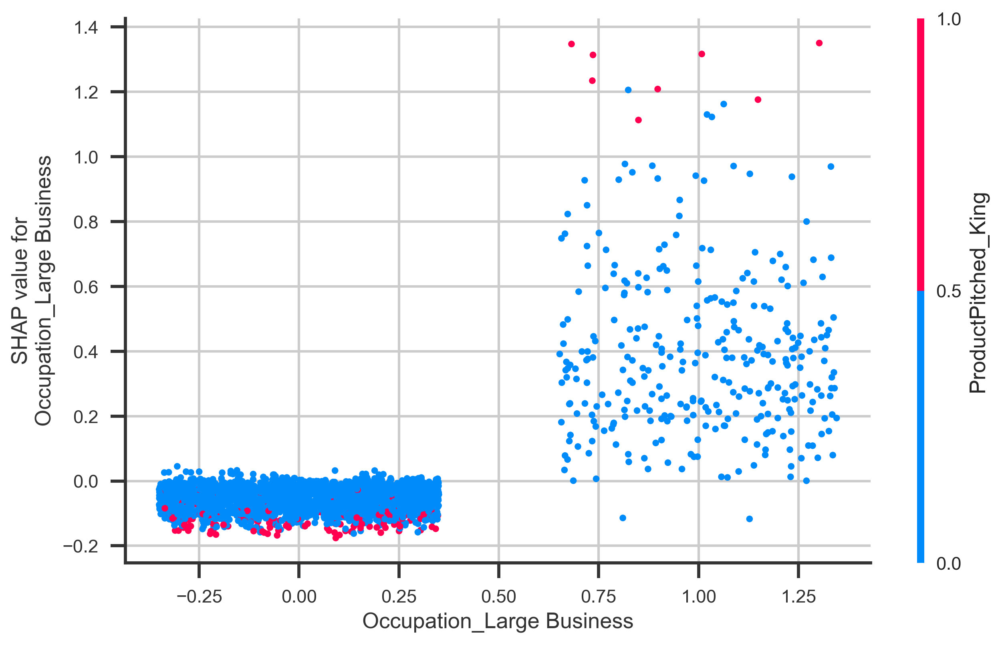

In [343]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,  interaction_index='ProductPitched_King', alpha=1, x_jitter=.7)

### Observations
- Large Business customers tend to buy Basic Product, followed by Standard and King
- This expains why they Prefer more 3 star properties.

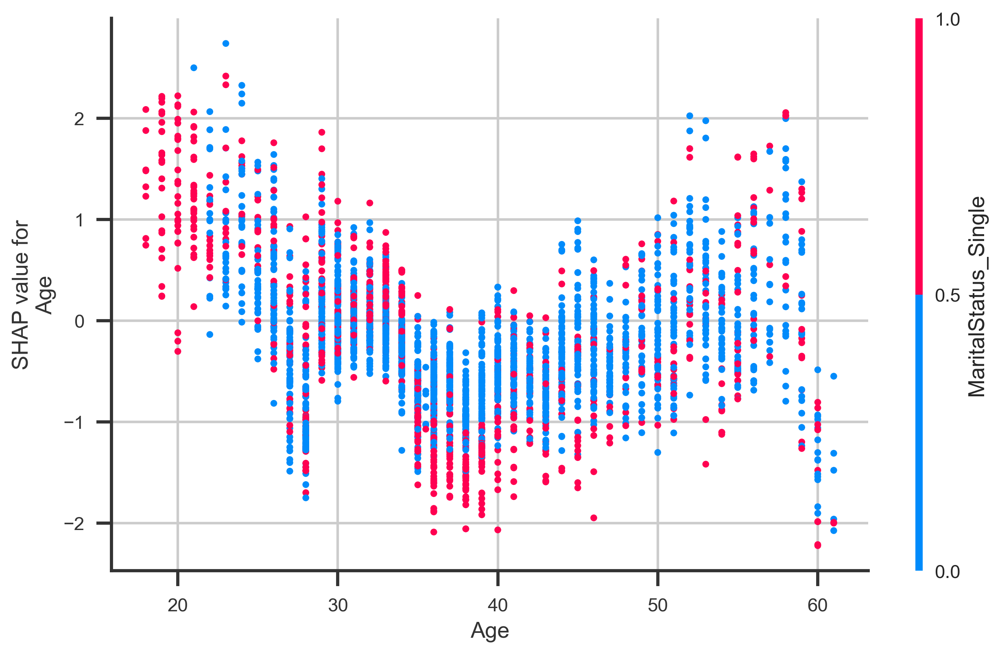

In [297]:
# Age dependence_plot
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1)

### Observations
- More singles with Age in between 18 and 22 tends to take Product.
- Middle Aged Singles, i.e., people between 35 to 40 tends not to take the Product

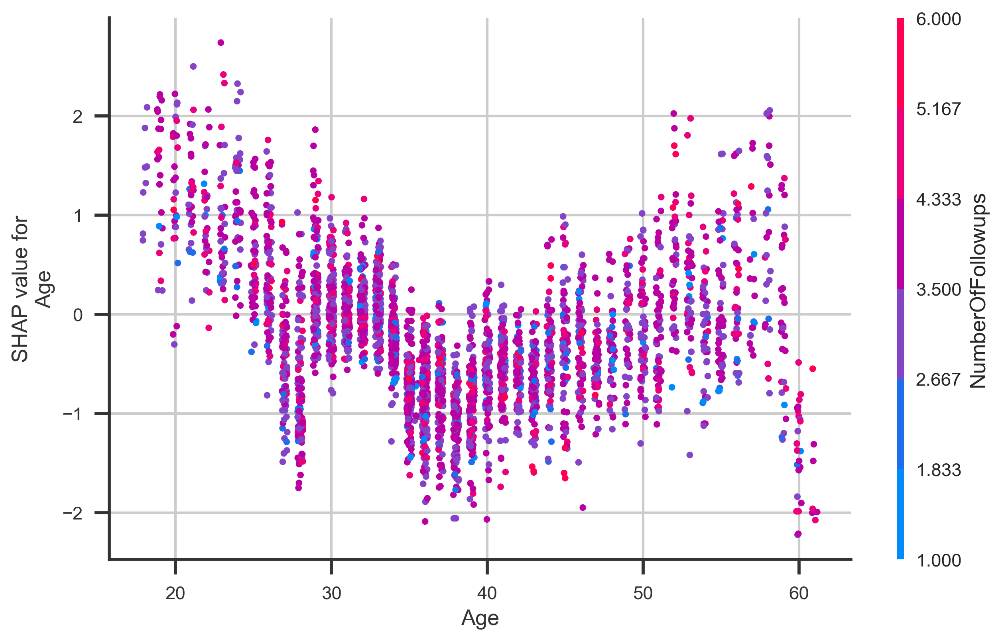

In [298]:
# Age dependence_plot with NumberOfFollowups
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='NumberOfFollowups', x_jitter=.7)

### Observations
- Looks like there even with higher NumberOfFollowups, customers in between Age groups of 25 to 30 and 35 to 45 tend not to buy the Product.
- Age groups in between 18 to 25, 30 to 35, 50 to 60 tend to respond to Purchase Product more. 
- Younger groups in between 18 to 25 less NumberOfFollowups


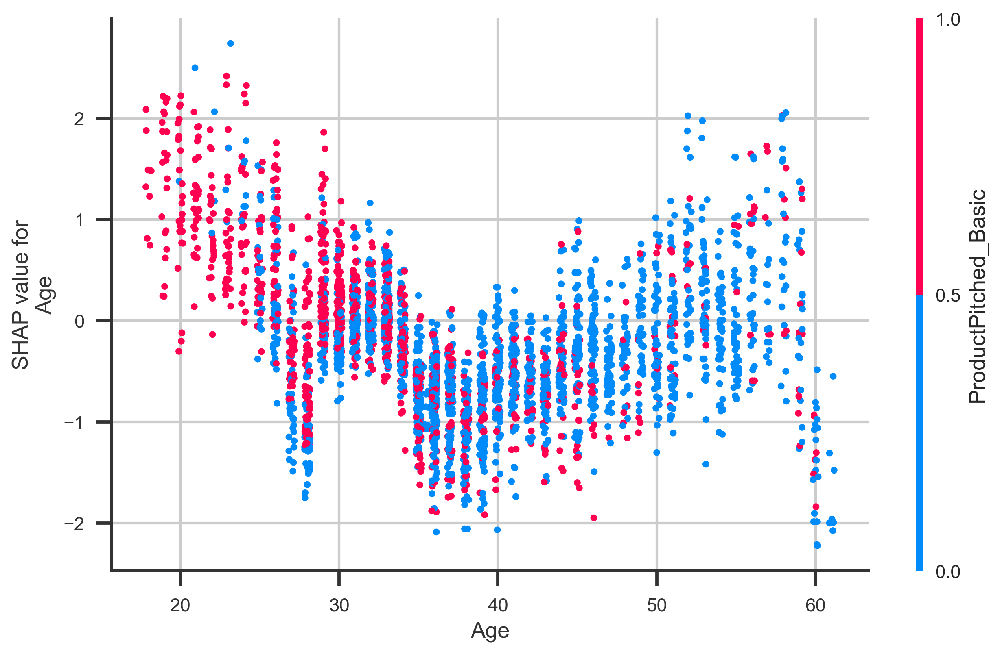

In [308]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Basic', x_jitter=.7)

### Observations
- Younger Aged customers in between 18 and 35 years picked Basic product

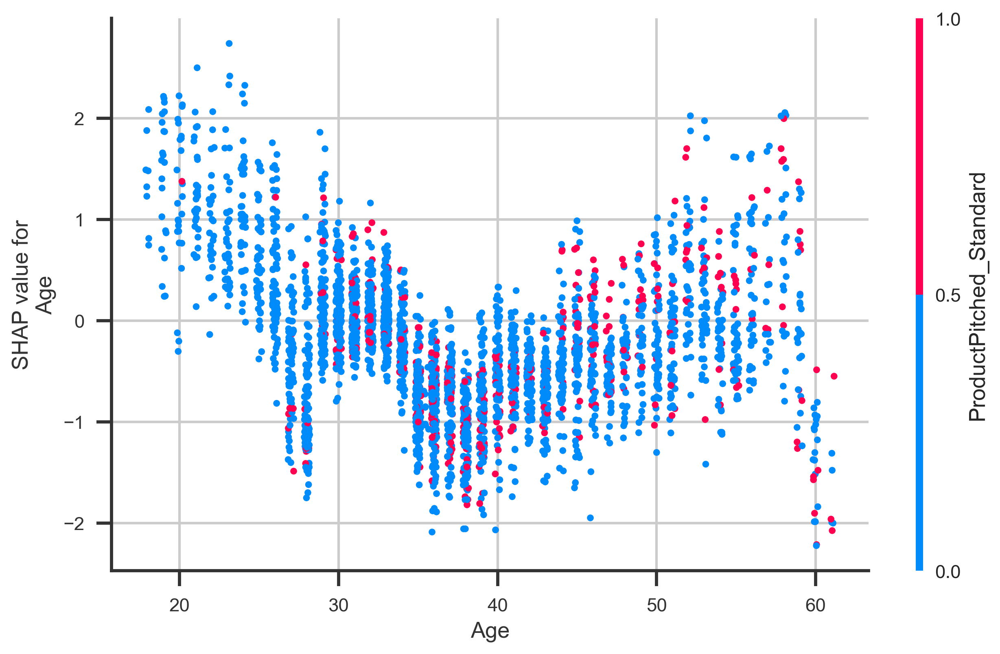

In [309]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Standard', x_jitter=.7)

### Observations
- Standard Product is popular among 45 to 60 Age groups

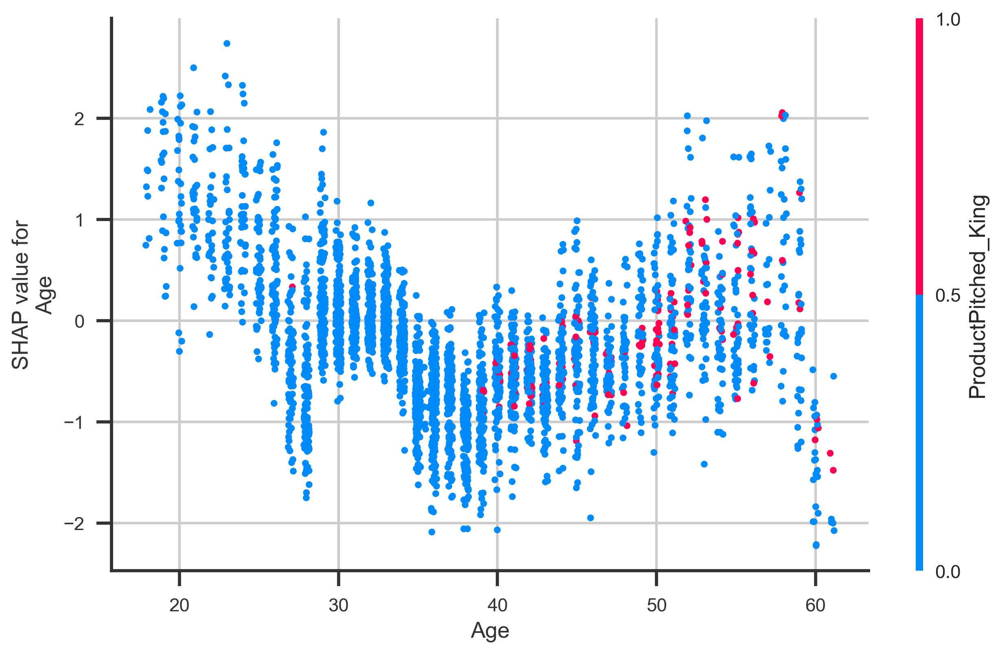

In [311]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Age', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_King', x_jitter=.7)

### Observations
King is the best Product for Age groups 50 to 60

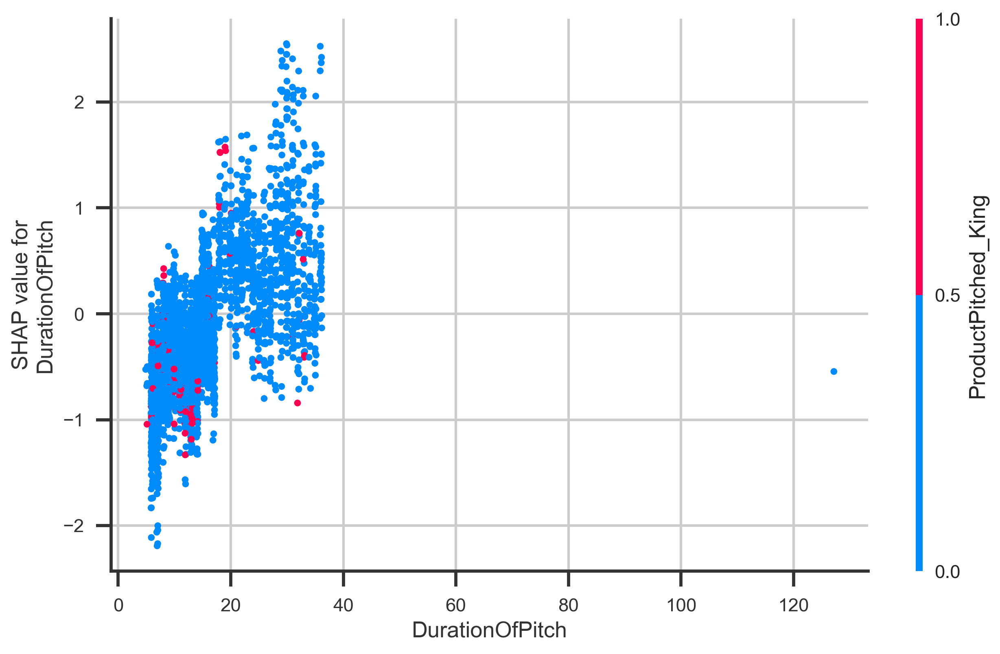

In [307]:
# Age dependence_plot
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('DurationOfPitch', vals, X_train, ax=ax, alpha=1, 
                         interaction_index='ProductPitched_King', x_jitter=.7)

### Observations
- Higher DurationOfPitch won't help to buy expensive Products. 

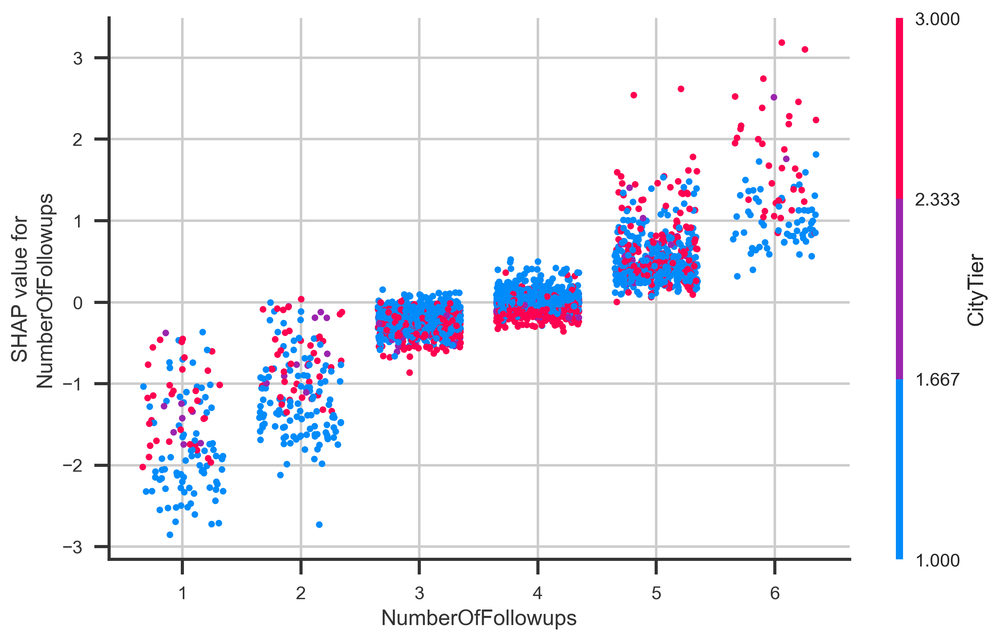

In [221]:
# NumberOfFollowups dependence_plot 
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfFollowups', vals, X_train, ax=ax, alpha=1,  x_jitter=.7)

### Observations
- Sweet spot for NumberOfFollowups is greaterthan or equal to 5

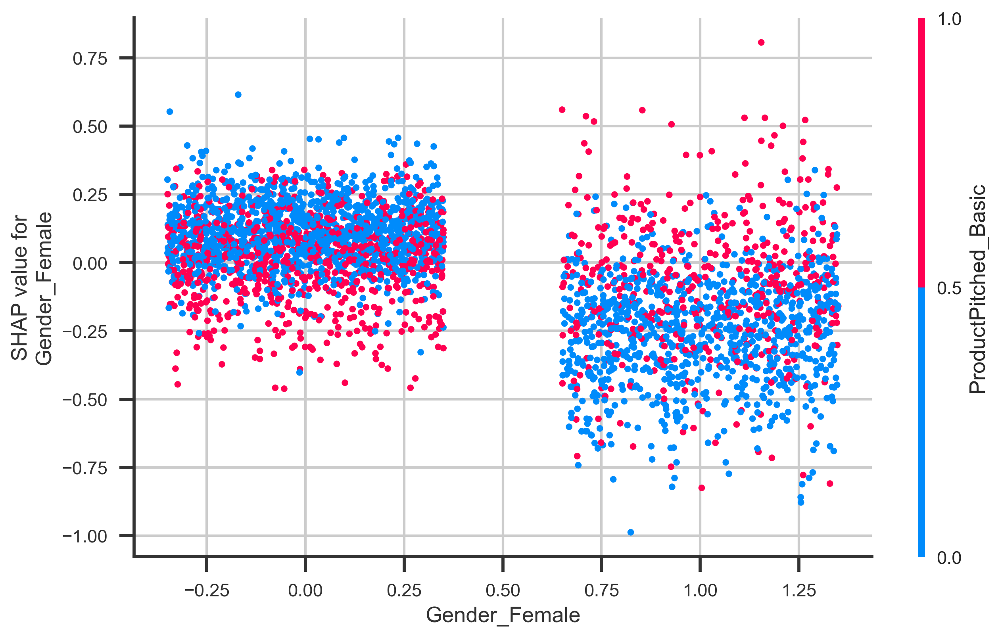

In [300]:
# NumberOfFollowups dependence_plot 
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Gender_Female', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Basic', x_jitter=.7)

### Observations
- Looks like Female customers who bought Package picked Basic Product.

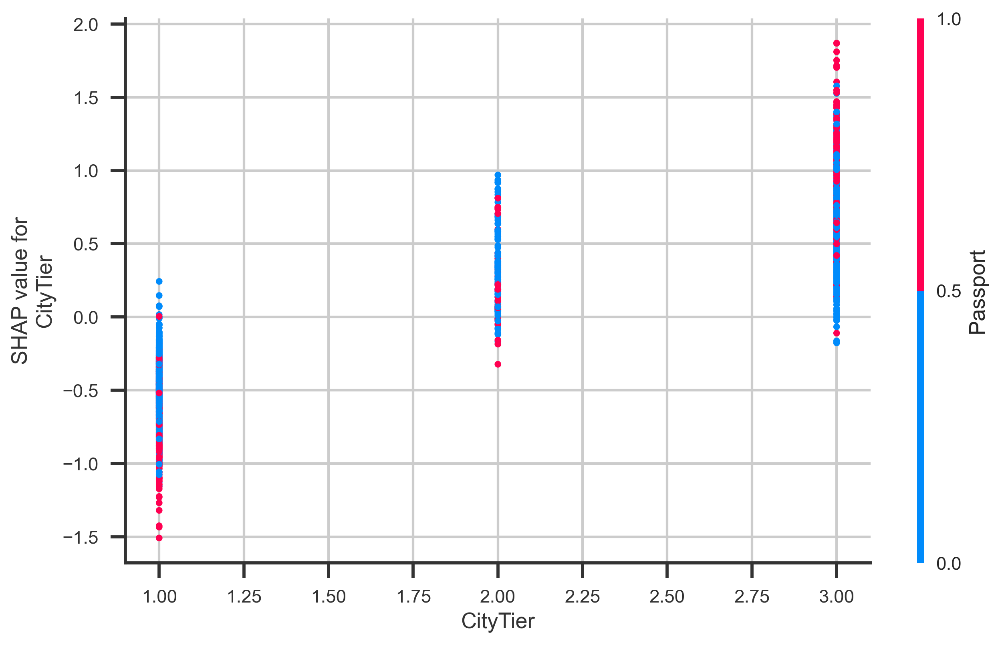

In [302]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('CityTier', vals, X_train, ax=ax, alpha=1)

### Observations
- Customers living in CityTier 2 and 3 test to Purchase Products.

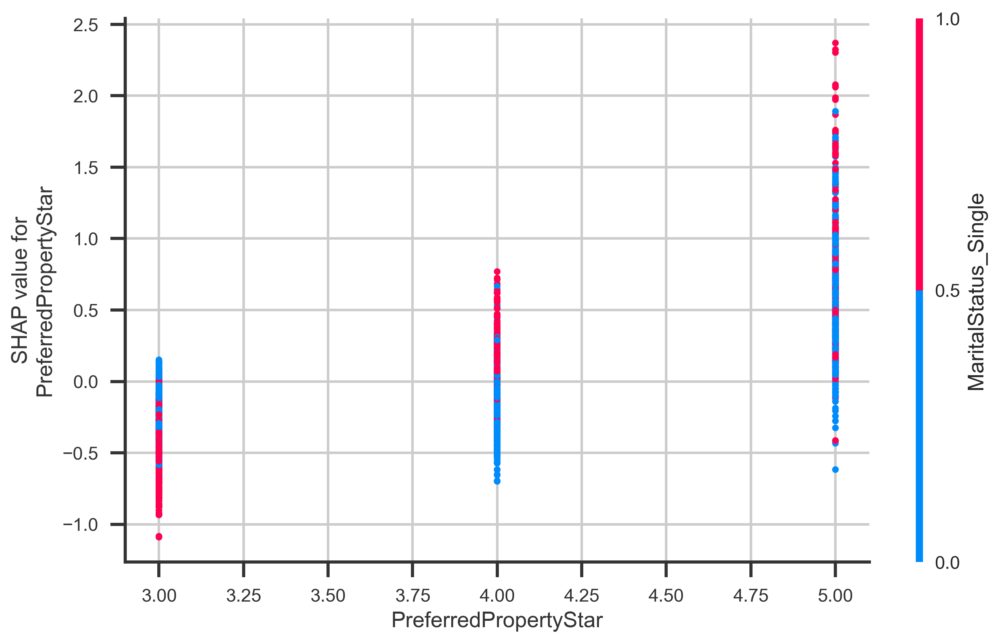

In [316]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('PreferredPropertyStar', vals, X_train, ax=ax, alpha=1)

### Observations
- Many singles who bought the Product preferred 4 and 5 star properties.
- However others who bought the Product showed interest towards 5 star properties.

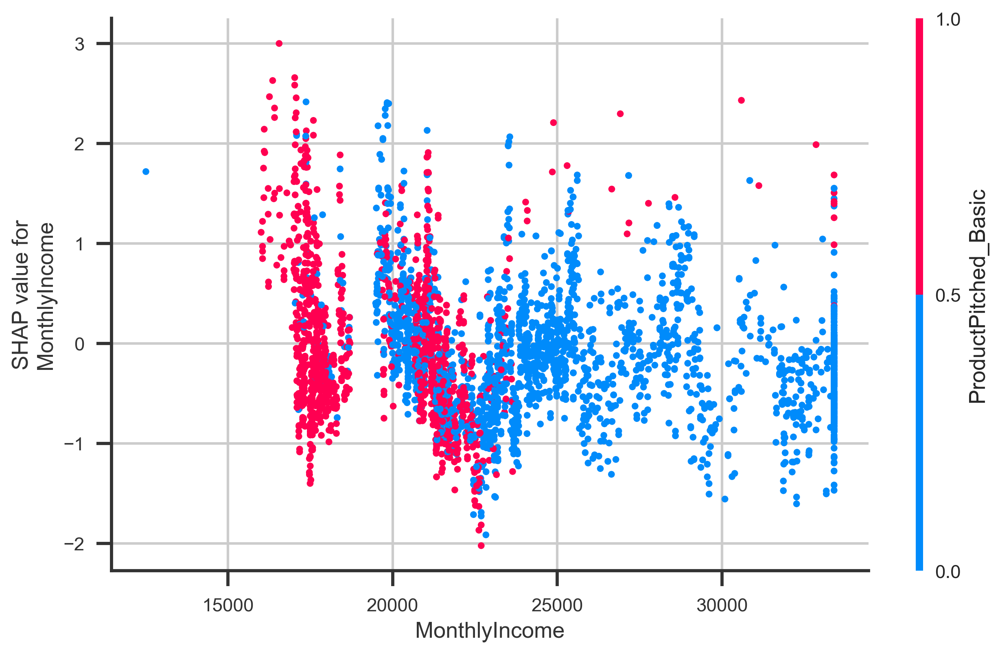

In [320]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Basic', x_jitter=.7)

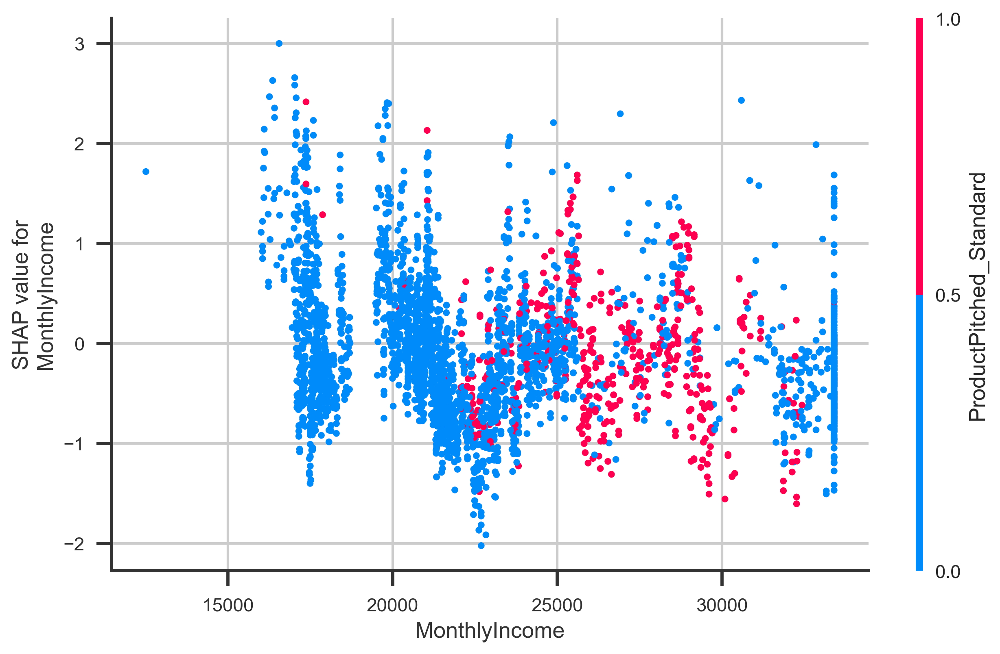

In [321]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Standard', x_jitter=.7)

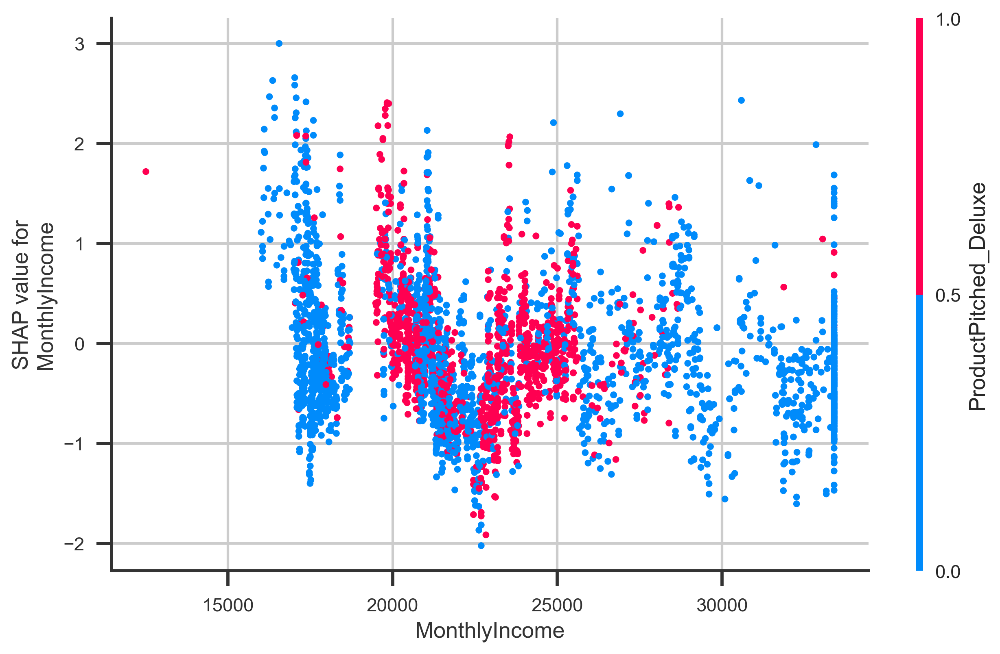

In [322]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_Deluxe', x_jitter=.7)

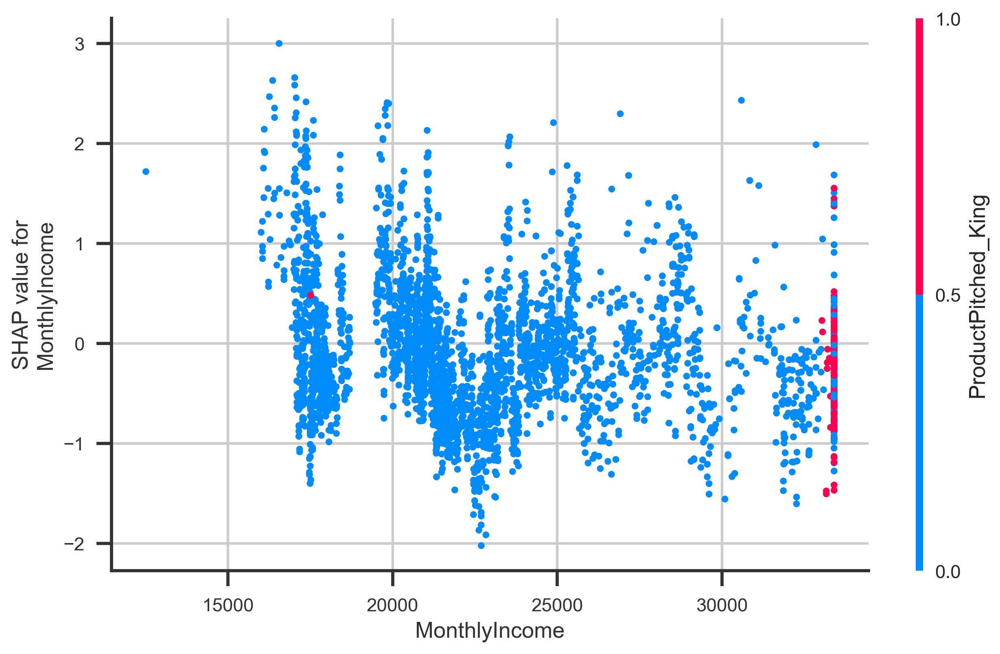

In [324]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('MonthlyIncome', vals, X_train, ax=ax, alpha=1, interaction_index='ProductPitched_King', x_jitter=.7)

### Observations
- People with MonthlyIncome in between 15000 to 22000 tend to buy Basic product.
- People with MonthlyIncome in between 18000 to 25000 tend to buy Deluxe product.
- People with MonthlyIncome in between 25000 to 30000 tend to buy Standard product.
- People with MonthlyIncome about 30000 tend to buy King product. However it requires more data.

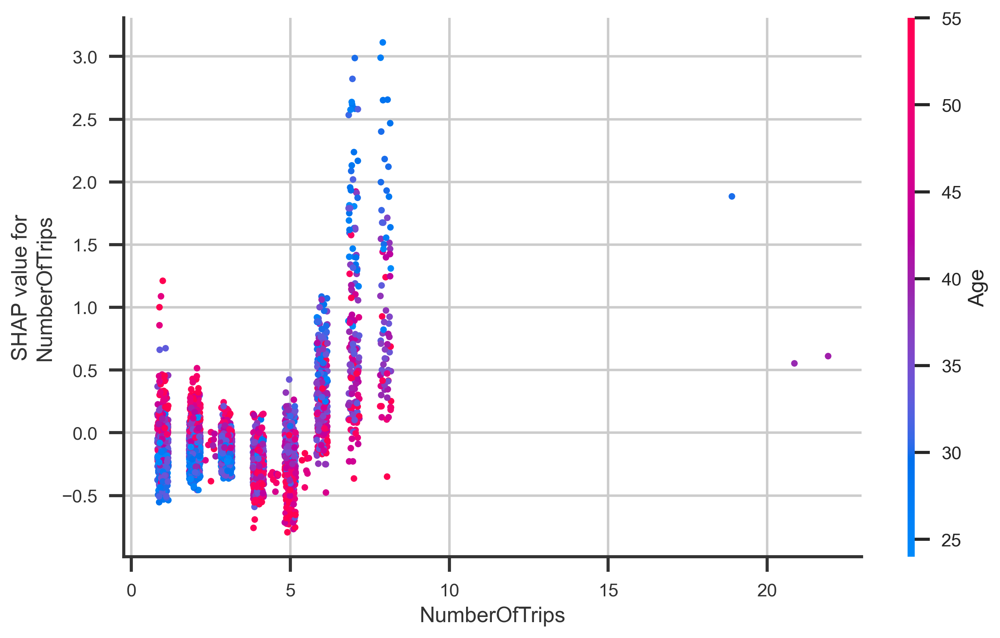

In [326]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, alpha=1, x_jitter=.7)

### Observations
- Higher NumberOfTrips is a strong indication of Person taking a Product
- Younger People tend to have higher NumberOfTripds

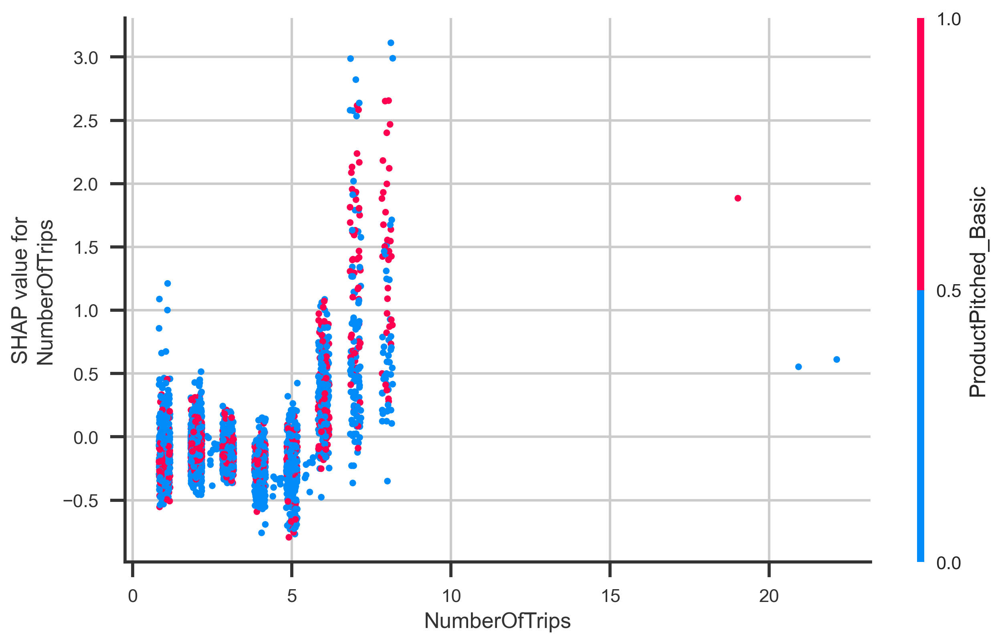

In [327]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_Basic', alpha=1, x_jitter=.7)

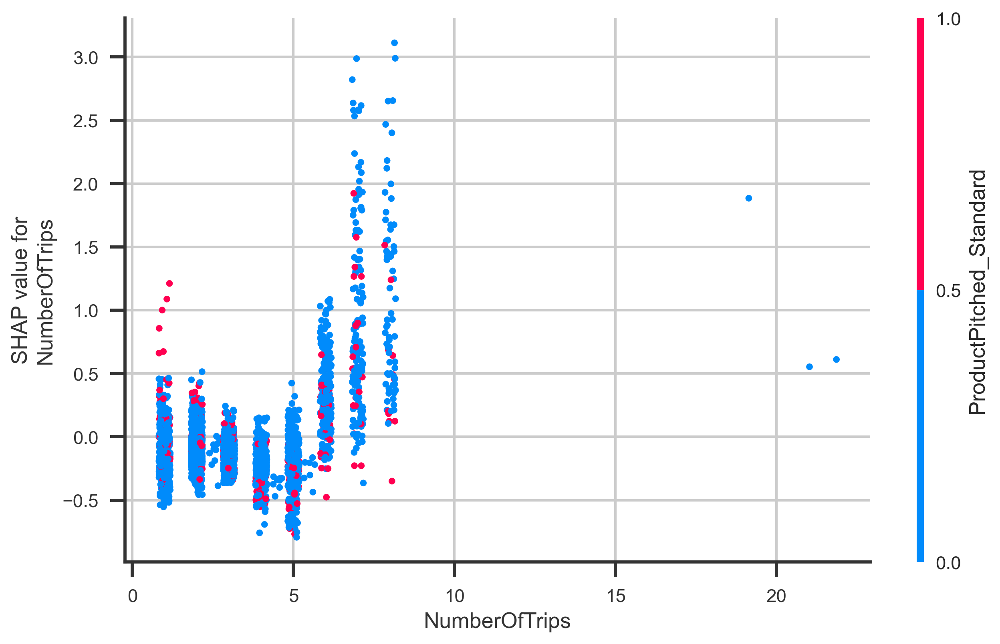

In [328]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_Standard', alpha=1, x_jitter=.7)

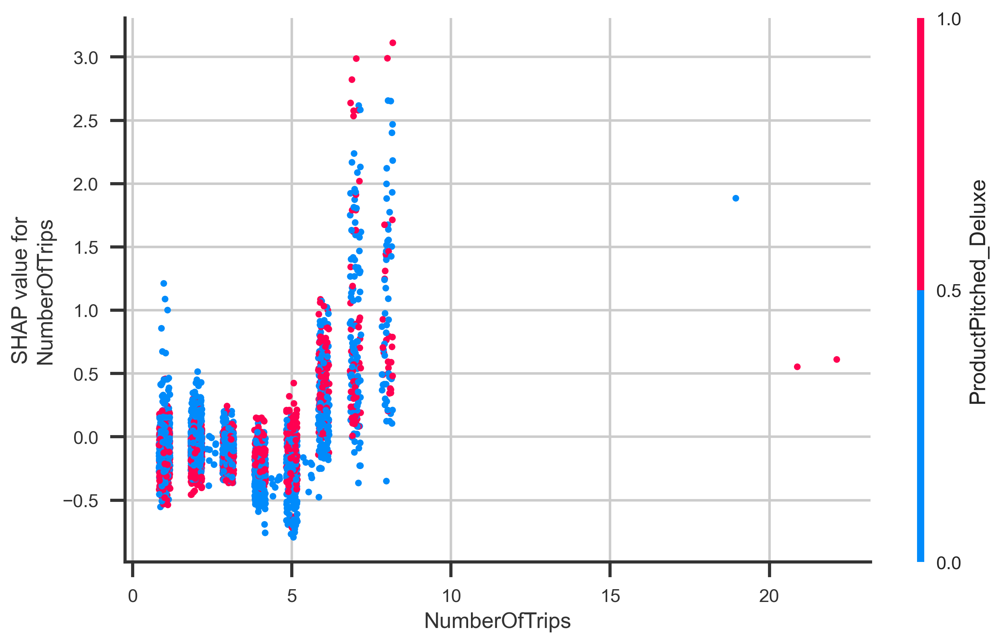

In [329]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_Deluxe', alpha=1, x_jitter=.7)

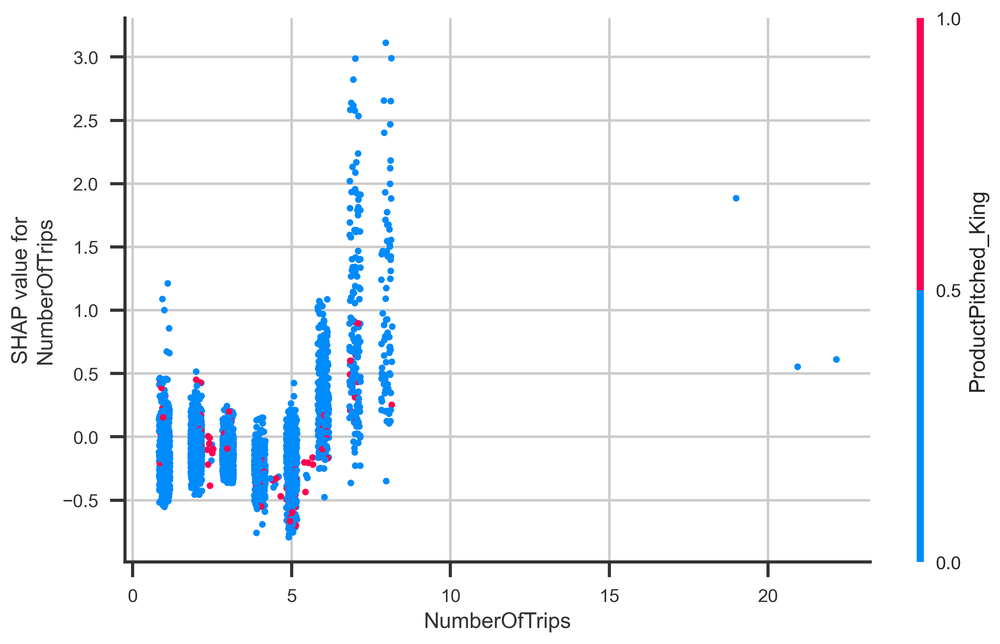

In [330]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('NumberOfTrips', vals, X_train, ax=ax, interaction_index='ProductPitched_King', alpha=1, x_jitter=.7)

### Observations
- Customers with higher NumberOfTrips purchased Basic Product, followed by Deluxe

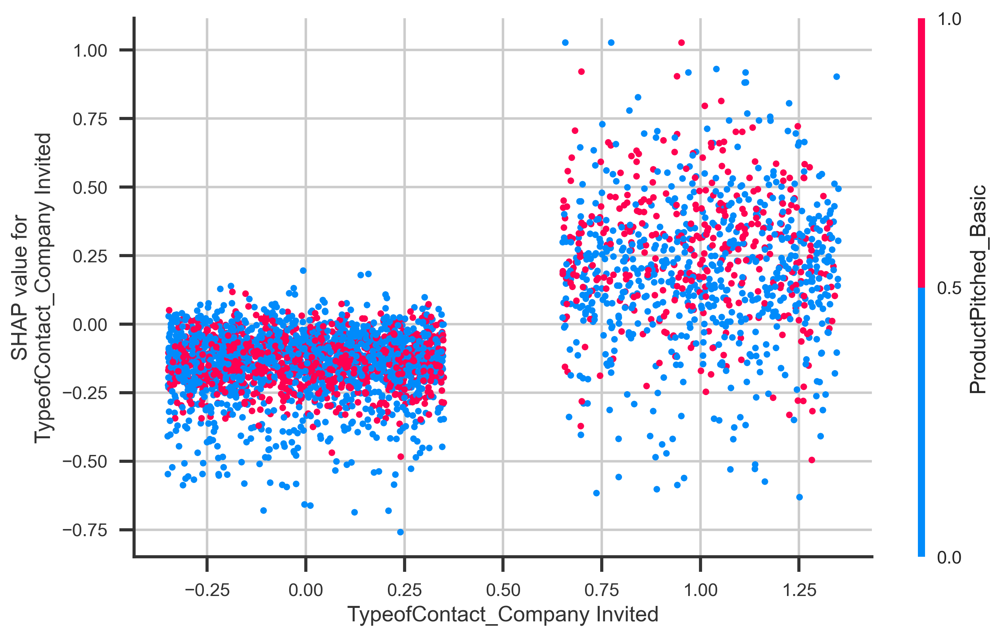

In [336]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('TypeofContact_Company Invited', vals, X_train, ax=ax,  interaction_index='ProductPitched_Basic', alpha=1, x_jitter=.7)

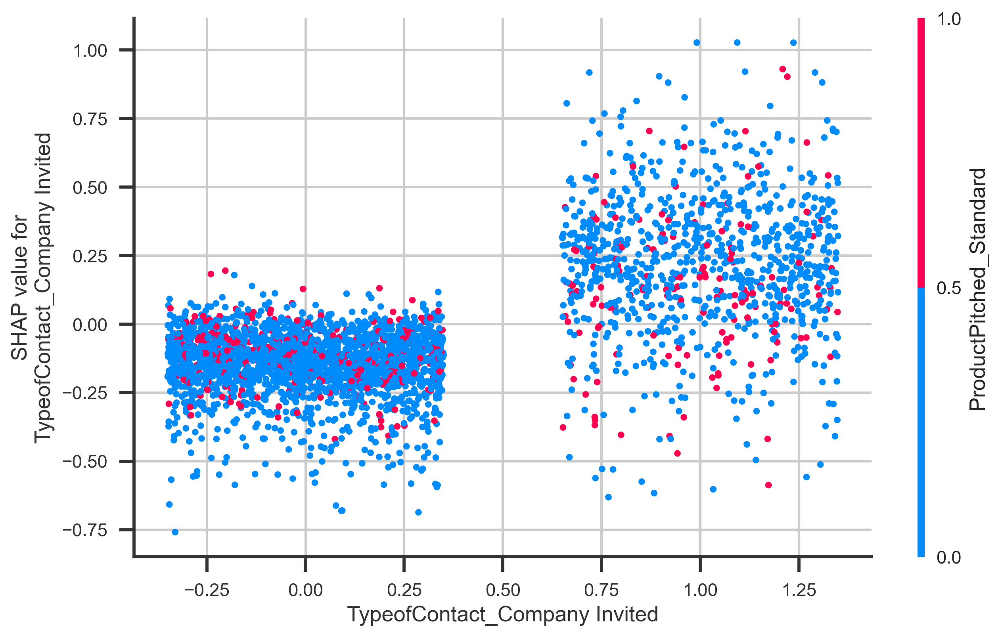

In [337]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('TypeofContact_Company Invited', vals, X_train, ax=ax,  interaction_index='ProductPitched_Standard', alpha=1, x_jitter=.7)

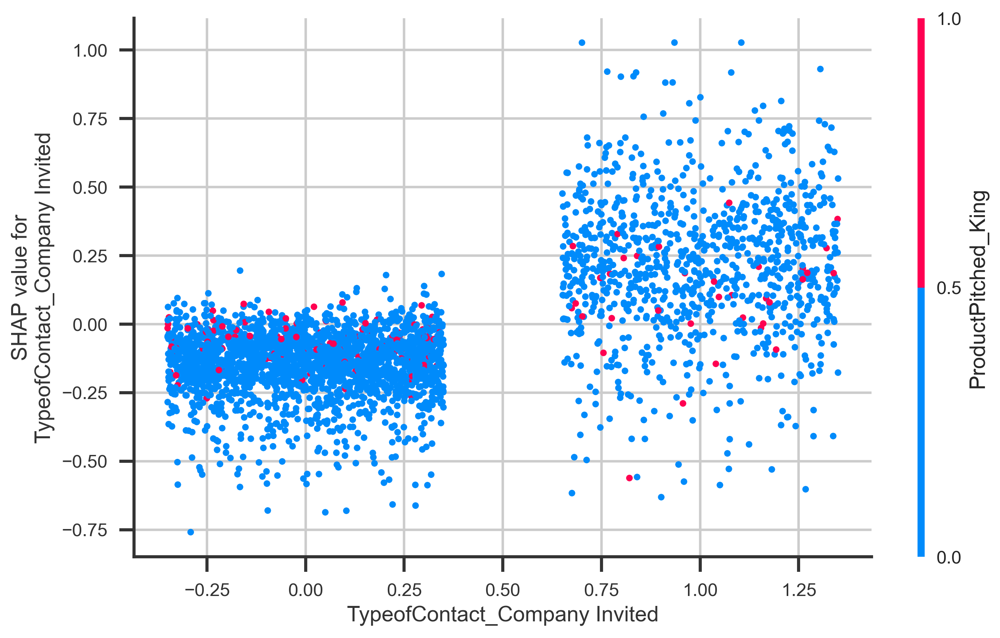

In [339]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('TypeofContact_Company Invited', vals, X_train, ax=ax,  interaction_index='ProductPitched_King', alpha=1, x_jitter=.7)

### Observations
- When TypeOfContact is Company Invited, people tend to buy the Product
- The popular among the mis Basic, followed by Standard and King.

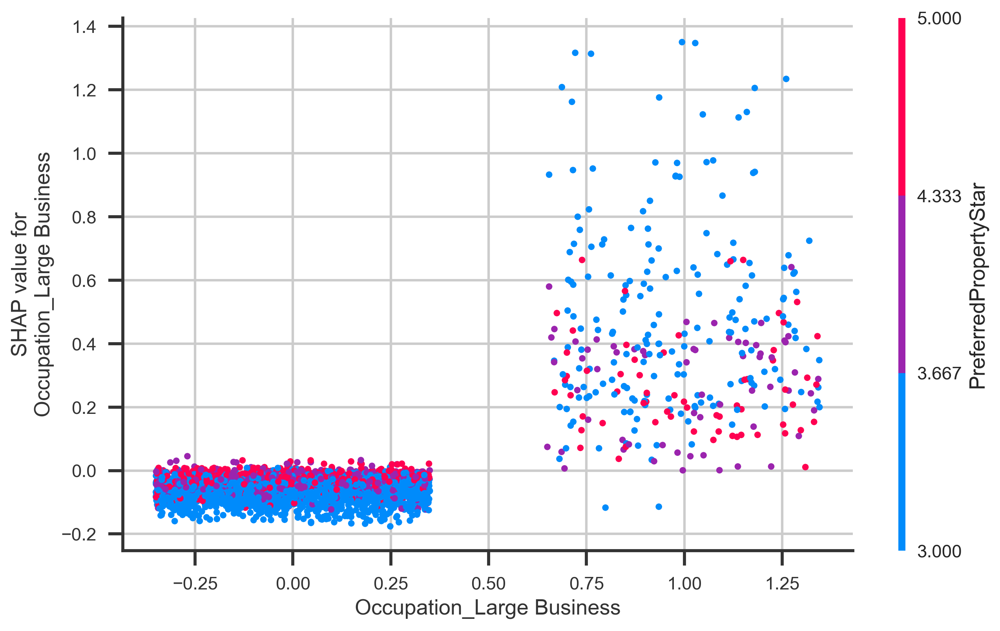

In [340]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,   alpha=1, x_jitter=.7)

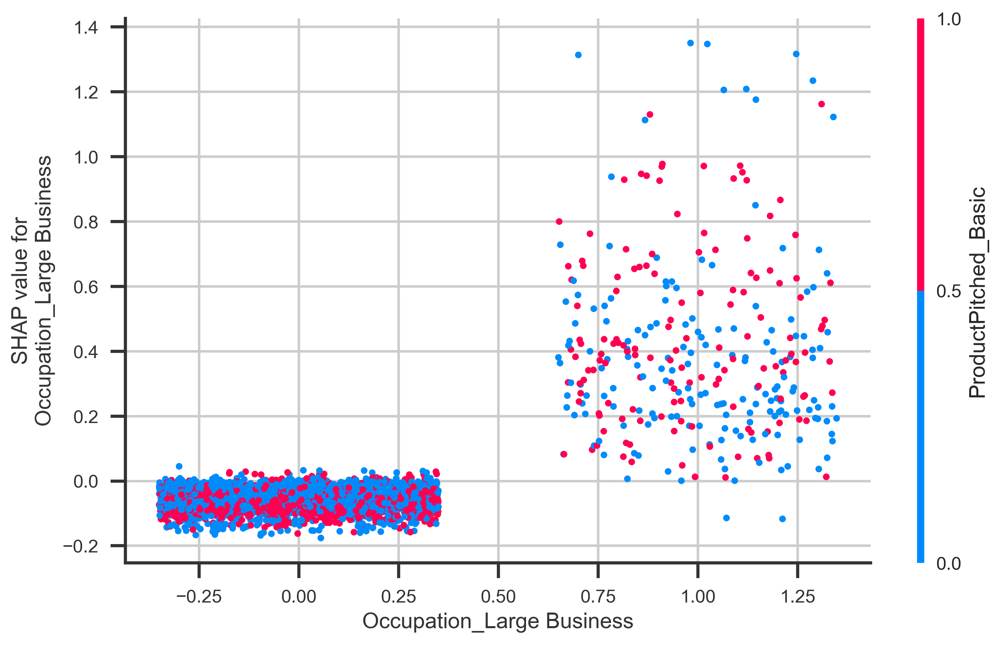

In [341]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,  interaction_index='ProductPitched_Basic', alpha=1, x_jitter=.7)

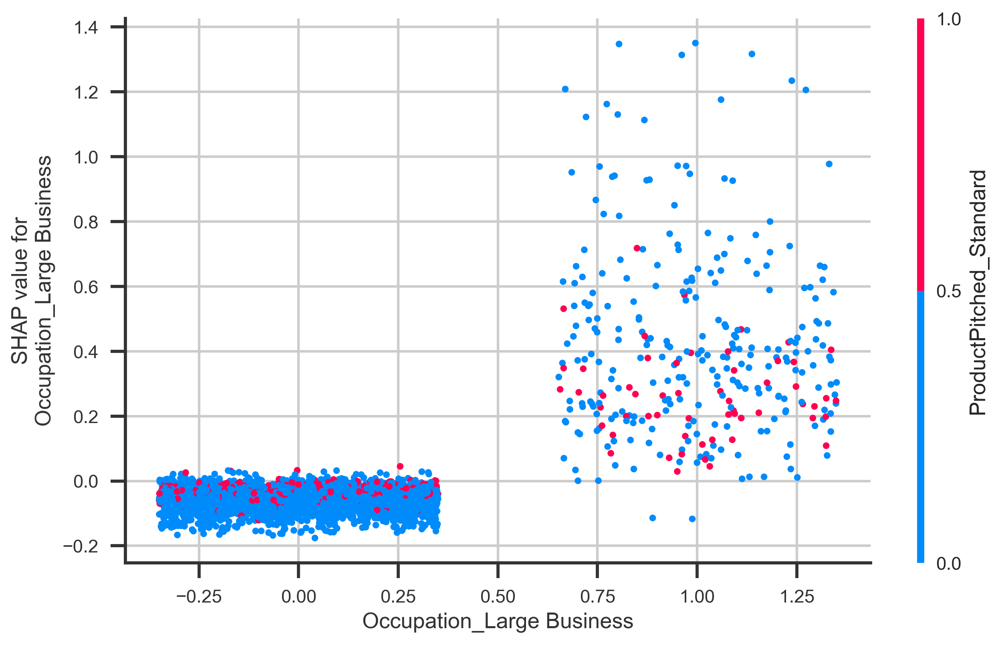

In [342]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,  interaction_index='ProductPitched_Standard', alpha=1, x_jitter=.7)

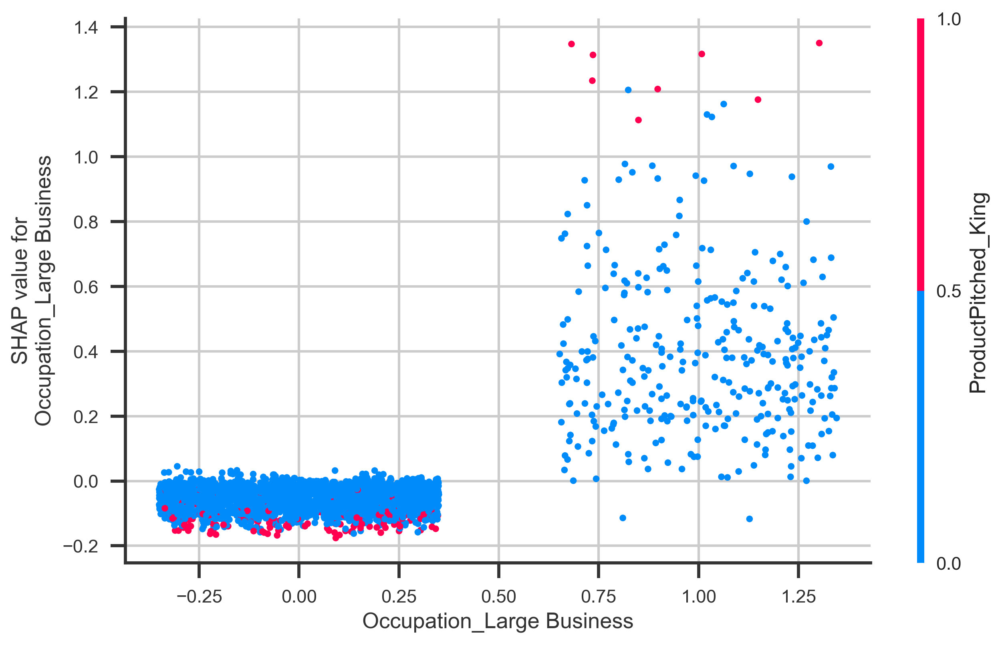

In [343]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('Occupation_Large Business', vals, X_train, ax=ax,  interaction_index='ProductPitched_King', alpha=1, x_jitter=.7)

### Observations
- Large Business customers tend to buy Basic Product, followed by Standard and King
- This expains why they Prefer more 3 star properties.

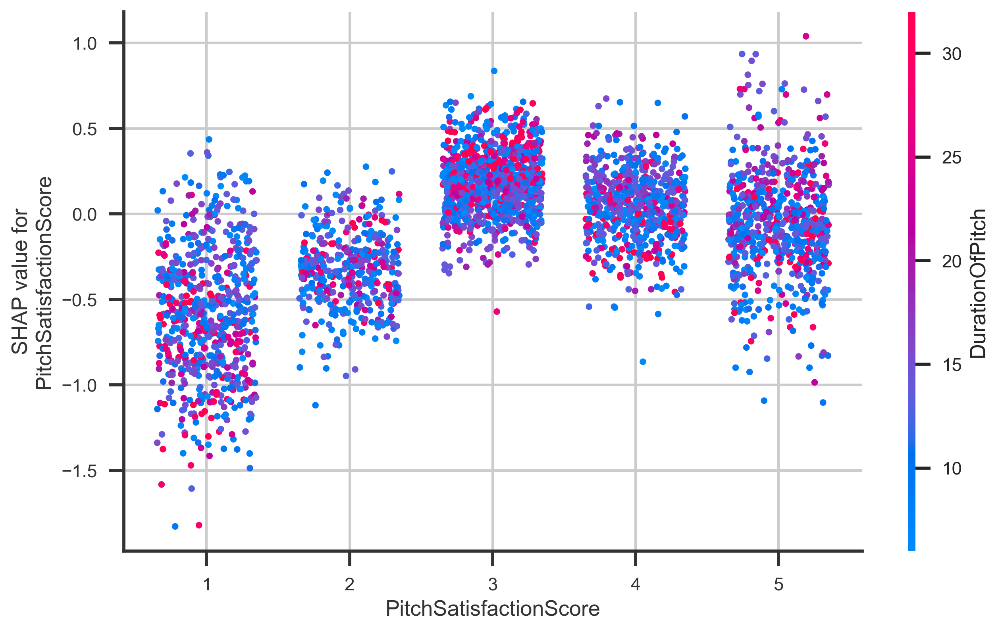

In [568]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('PitchSatisfactionScore', vals_stk, X_train, ax=ax, interaction_index='DurationOfPitch',   alpha=1, x_jitter=.7)

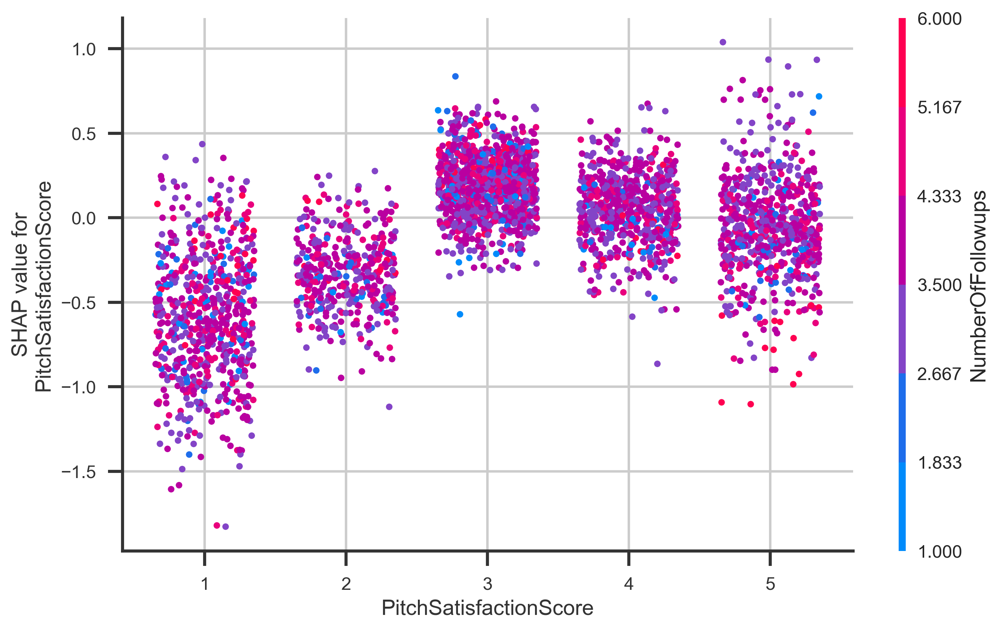

In [569]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('PitchSatisfactionScore', vals_stk, X_train, ax=ax, interaction_index='NumberOfFollowups',   alpha=1, x_jitter=.7)

### Observations
- Customers who give PitchSatisfactionScore of
- 3 and 4 purchase Product. 
- 1 and 2 won't purchase product
- 5 has 50% chance of purchasing even with higher number of followups

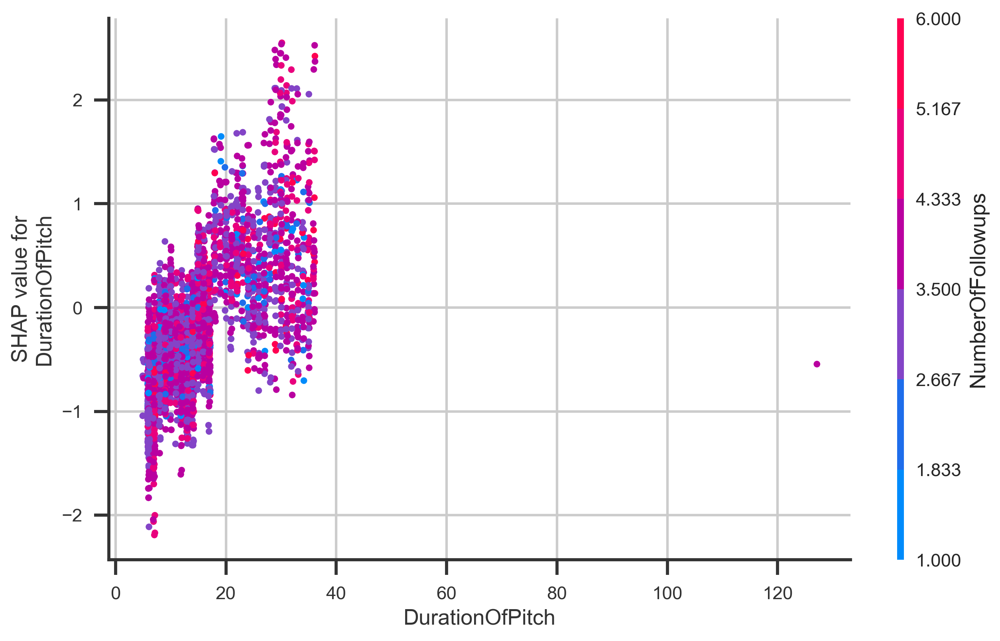

In [573]:
with sns.plotting_context('talk'):
    fig, ax= plt.subplots(figsize=(10,6), dpi=300)
    shap.dependence_plot('DurationOfPitch', vals_stk, X_train, ax=ax, interaction_index='NumberOfFollowups',   alpha=1, x_jitter=.7)

### Observations
- Customers tend to buy product when the DurationOfPitch is in between 20 to 40 mins. Along with that higher number of followups may help

## Business Insights and Recommendations

* We have been able to build a predictive model:
  a) The company can use this model to identify the customers who can purchase the Product
  b) Based on that, they can target the right people to contact and also reduce the costs of Number of followup calls.
  c) They can also eliminate or improvise on existing packages that are least popular among customers and try to introduce new packages for the interested customers.

* Factors that drive the product Purchase are 
- Owns Passport
- ProductPitched as Basic
- Younger Age
- Higher CityTier 
- Lower MonthlyIncome
- MaritalStatus as Single
- Higher NumberOfFollowups 
- Higher PreferredPropertyStar
- Higher NumberOfTrips
- Lower MonthyIncome
- TypeOfContact is Company Invited
- ProductPitched as Standard
- Occupation as Large Business

* Owns Passport: 
    - Customers who owns passport may travel more and tend to buy more Products. 
    - We can also bring new international packages for recommend them to these customers.
* ProductPitched: 
    - Most popular Products are Basic and Standard
    - Least Popular Product is Super Deluxe. Infact When this Product is pitched, customers tend not to buy the Product. So we can deprecate this Product and create a new one based on the customer interests or trend.    
* CityTier: 
    - Customers from tier 2 and 3 cities tend to purchase products. 
    - This makes sense because these customers may be stresses out a lot in their day-to-day activities. Also we may introduce health packages to these people
* MaritalStatus as Single:
    - More singles with Age in between 18 and 22 tends to take Product.
    - Singles with Age in between 35 to 40 tends not to take the Product.
* NumberOfFollowups
    - Younger groups in between 18 to 25 less NumberOfFollowups
    - Looks like there even with higher NumberOfFollowups, customers in between Age groups of 25 to 30 and 35 to 45 tend not to buy the Product.
    - Sweet spot for NumberOfFollowups is greaterthan or equal to 5
* PreferredPropertyStar:
    - Many singles who bought the Product preferred 4 and 5 star properties.
    - However others who bought the Product showed interest towards 5 star properties.
* Age:
    - Age groups in between 18 to 25, 30 to 35, 50 to 60 tend to Purchase Product more.
    - Younger Aged customers in between 18 and 35 years picked Basic product
    - Standard Product is popular among 45 to 60 Age groups
    - King is the best Product for Age groups 50 to 60
* NumberOfTrips
    - Higher NumberOfTrips is a strong indication of Person taking a Product
    - Younger People tend to have higher NumberOfTripds
    - Customers with higher NumberOfTrips purchased Basic Product, followed by Deluxe
* Monthly Income
    - People with MonthlyIncome in between 15000 to 22000 tend to buy Basic product and they bought more Products.
    - People with MonthlyIncome in between 18000 to 25000 tend to buy Deluxe product.
    - People with MonthlyIncome in between 25000 to 30000 tend to buy Standard product.
    - People with MonthlyIncome about 30000 tend to buy King product. However it requires more data. 
* TypeOfContact is Company Invited
    - When TypeOfContact is Company Invited, people tend to buy the Product
    - The popular among the mis Basic, followed by Standard and King.
* Occupation Large Business
  - Large Business customers tend to buy Basic Product, followed by Standard and King
  - This explains why they Prefer more 3 star properties.  
* PitchSatisfactionScore
  - Lower PitchSatisfactionScore has a negative impact
  - Customers who give PitchSatisfactionScore of
    - 3 and 4 tend to purchase Product. 
    - 1 and 2 tend not to purchase product
    - 5 has 50% chance of purchasing even with higher number of followups. Also they tend to buy Basic Product more.
* DurationOfPitch
    - Customers tend to buy product when the DurationOfPitch is in between 20 to 40 mins. Along with that higher number of followups may help


*************************************
**************************************
Overall 
* Basic and standard are our best Products. Older customers prefer King.
  Super deluxe is the worst Package and a good candidate to get eliminated.

* Customers to target are 
    - who own passport, 
    - who are young Ages between 18 to 25, 30 to 35, 50 to 60 
    - Who are singles with your age
    - who are in tier 2 and 3 cities
    - who is a frequent traveller, 
    - who has lower Monthly Income and young
    - Who owns Large Businesses

* In terms of marketing, customers tend to buy Product when
    - Duration Of Pitch is in between 20 to 40 mins
    - NumberOfFollowups should greater than or equal to 5
    - Most importantly PitchSatisfactionScore should be 3 or 4. Anything lower will affect the outcome badly
    - When company invites them

* In terms of introducting new Wellness tourism Package target
    - Customers for tier 2 and tier 3 cities. As these people are mostly stressed out due to city lifestyle, they would make most out of it.
    - We can also introduce them to Large Businesses and customers who own passport.
